In [ ]:
import pandas as pd
import numpy as np
import json
import copy
import os
import scipy.stats as ss
import math
from math import sqrt
import matplotlib.pyplot as plt
import statistics
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.arima_model import ARMA
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.holtwinters import SimpleExpSmoothing
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.tsa.stattools import acf
from statsmodels.tsa.stattools import pacf
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import HuberRegressor
from sklearn.linear_model import LassoLars
from sklearn.linear_model import PassiveAggressiveRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import ExtraTreeRegressor
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import GradientBoostingRegressor

In [ ]:
import numpy as np
import pandas as pd
from sklearn import preprocessing
import time
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# !pip install preprocessing

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
# from easypreprocessing import EasyPreProcessing
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import math
import scipy.stats as stats

## ***Exploratory data analyses (EDA)***

In [ ]:
df= pd.read_csv('/content/sim_df.csv')

In [ ]:
# # Rounding numerical columns to one decimal
# numerical_columns = df.select_dtypes(include=["float64", "int64"]).columns
# df[numerical_columns] = df[numerical_columns].round(1)

In [ ]:
df.head()

,Unnamed: 0,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,ORDERDATE,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
0,0,Reggio Emilia,Italy,Small,10,89.3,7028.4,100.9,2012-11-22,Trains,11,2012,4
1,1,Boston,USA,Small,52,71.9,6494.0,36.0,2007-12-28,Trucks and Buses,12,2007,4
2,2,Osaka,Japan,Small,43,98.6,4083.2,129.8,2011-01-14,Trucks and Buses,1,2011,1
3,3,Nantes,France,Medium,25,111.4,2440.3,88.0,2005-07-15,Motorcycles,7,2005,3
4,4,Koln,Germany,Medium,36,91.1,3353.4,114.6,2015-04-13,Planes,4,2015,2


In [ ]:
df = df.drop(columns=["Unnamed: 0"])

In [ ]:
df.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,ORDERDATE,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
0,Reggio Emilia,Italy,Small,10,89.3,7028.4,100.9,2012-11-22,Trains,11,2012,4
1,Boston,USA,Small,52,71.9,6494.0,36.0,2007-12-28,Trucks and Buses,12,2007,4
2,Osaka,Japan,Small,43,98.6,4083.2,129.8,2011-01-14,Trucks and Buses,1,2011,1
3,Nantes,France,Medium,25,111.4,2440.3,88.0,2005-07-15,Motorcycles,7,2005,3
4,Koln,Germany,Medium,36,91.1,3353.4,114.6,2015-04-13,Planes,4,2015,2


In [ ]:
df.shape

(7000, 12)

In [ ]:
# # Try reading the file with a different encoding
# file_path = '/content/Data (1).csv'
# try:
#     df = pd.read_csv(file_path, encoding='ISO-8859-1')
# except UnicodeDecodeError:
#     df = pd.read_csv(file_path, encoding='cp1252')

In [ ]:
df['ORDERDATE'] = pd.to_datetime(df['ORDERDATE'])

In [ ]:
# df.set_index('ORDERDATE', inplace=True)

In [ ]:
df.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,ORDERDATE,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
0,Reggio Emilia,Italy,Small,10,89.3,7028.4,100.9,2012-11-22,Trains,11,2012,4
1,Boston,USA,Small,52,71.9,6494.0,36.0,2007-12-28,Trucks and Buses,12,2007,4
2,Osaka,Japan,Small,43,98.6,4083.2,129.8,2011-01-14,Trucks and Buses,1,2011,1
3,Nantes,France,Medium,25,111.4,2440.3,88.0,2005-07-15,Motorcycles,7,2005,3
4,Koln,Germany,Medium,36,91.1,3353.4,114.6,2015-04-13,Planes,4,2015,2


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7000 entries, 0 to 6999
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   CITY             7000 non-null   object        
 1   COUNTRY          7000 non-null   object        
 2   DEALSIZE         7000 non-null   object        
 3   QUANTITYORDERED  7000 non-null   int64         
 4   PRICEEACH        7000 non-null   float64       
 5   SALES            7000 non-null   float64       
 6   MSRP             7000 non-null   float64       
 7   ORDERDATE        7000 non-null   datetime64[ns]
 8   PRODUCTLINE      7000 non-null   object        
 9   MONTH_ID         7000 non-null   int64         
 10  YEAR_ID          7000 non-null   int64         
 11  QTR_ID           7000 non-null   int64         
dtypes: datetime64[ns](1), float64(3), int64(4), object(4)
memory usage: 656.4+ KB


**Work Flow**

## ***1) Data Preprocessing:***

**Handling Missing Values:** Ensure that columns like "STATE" or "POSTALCODE" don't have missing values that could affect geographical analysis.

**Date Parsing:** Convert ORDERDATE to a datetime format and extract necessary components (year, quarter, month).

**Categorical Encoding:** Encode categorical variables (PRODUCTLINE, DEALSIZE) using techniques like one-hot encoding or label encoding for machine learning models.

In [ ]:
#Data cleaning by droping unnecessary columns
# df=df.drop(columns=['ORDERNUMBER', 'ORDERLINENUMBER', 'STATUS', 'CUSTOMERNAME', 'PHONE', 'ADDRESSLINE1', 'ADDRESSLINE2', 'CONTACTLASTNAME', 'CONTACTFIRSTNAME', 'STATE', 'TERRITORY', 'POSTALCODE' ])

In [ ]:
#At that current time i drop the "STATE" , "POSTALCODE" and "TERRITORY"

In [ ]:
# df['PRODUCTCODE'].unique()

In [ ]:
df.sample(10)

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,ORDERDATE,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
317,Philadelphia,USA,Medium,34,98.9,2986.3,181.5,2004-06-23,Trucks and Buses,6,2004,2
4903,Reggio Emilia,Italy,Small,18,97.9,4646.8,82.5,2013-06-28,Trains,6,2013,2
5546,Makati City,Philippines,Small,49,93.7,3805.6,166.4,2005-12-25,Motorcycles,12,2005,4
5753,NYC,USA,Large,48,104.1,16925.9,51.6,2013-04-19,Motorcycles,4,2013,2
2410,Madrid,Spain,Medium,43,140.4,3004.0,129.8,2015-04-03,Trucks and Buses,4,2015,2
5354,Reims,France,Medium,41,96.3,2558.0,190.2,2004-02-09,Motorcycles,2,2004,1
5055,Philadelphia,USA,Small,31,93.1,1184.4,78.6,2005-12-26,Planes,12,2005,4
3661,South Brisbane,Australia,Small,15,101.4,2561.9,82.8,2014-03-31,Vintage Cars,3,2014,1
6668,Barcelona,Spain,Medium,41,93.3,3845.7,77.9,2011-11-24,Vintage Cars,11,2011,4
6779,San Jose,USA,Small,45,98.7,4205.8,70.0,2006-04-14,Vintage Cars,4,2006,2


In [ ]:
# df.isnull().sum()

Here we see there is no missing value

## ***(i) Useful Library Profile Report***
by using this library we know all information about the data set


In [ ]:
# !pip install ydata-profiling

In [ ]:
# from ydata_profiling import ProfileReport

In [ ]:
#Generate the profiling report
# prof = ProfileReport(df)
# prof.to_file(output_file='output.html')

In [ ]:
#/content/output.html
#file:///C:/Users/Priyansu/Downloads/output%20(2).html

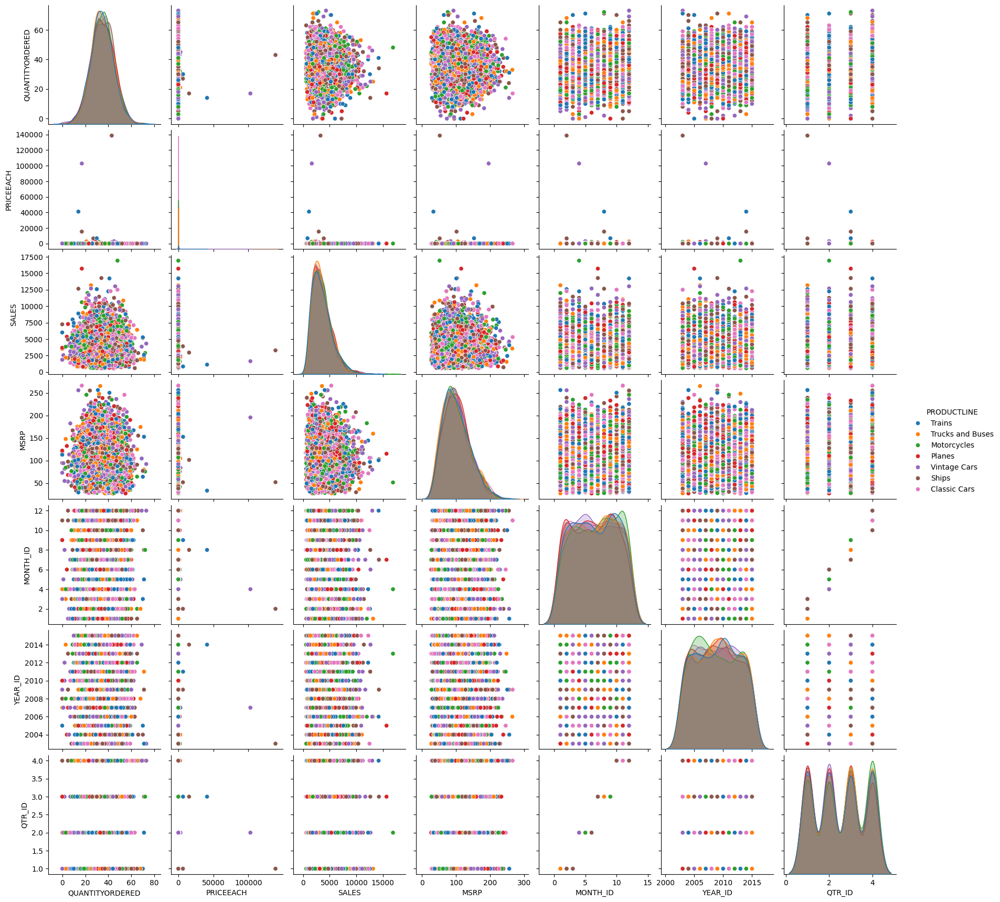

In [ ]:
# to see thier plots and relations
sns.pairplot(df, hue='PRODUCTLINE')

**Essential Columns:** QUANTITYORDERED, ORDERDATE, PRODUCTCODE

**Optional but Useful for ML Models:** PRICEEACH, PRODUCTLINE, QTR_ID, MONTH_ID, YEAR_ID

## ***2) Feature Engineering:***

**Seasonality Indicators:** Create features that indicate seasons or holidays which might affect demand.

**Promotions and Discounts:** If available, include information about promotional periods.(unavalaible in the dataset)

**Lag Features:** Incorporate past demand values to help models understand trends.


In [ ]:
# Compute time intervals between consecutive dates
time_diff = df['ORDERDATE'].diff()

# Check if all time intervals are the same
if all(time_diff == time_diff[0]):
    print("Data is equally spaced.")
else:
    print("Data is not equally spaced.")

Data is not equally spaced.


Conclusion:- Here the data is not equally spaced so we aggregate the data

In [ ]:
df.sample(10)

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,ORDERDATE,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
3887,North Sydney,Australia,Medium,43,98.6,1916.4,73.0,2014-02-12,Vintage Cars,2,2014,1
3389,Reims,France,Small,19,94.9,3435.2,73.3,2009-05-02,Classic Cars,5,2009,2
793,Madrid,Spain,Large,27,81.9,3370.4,64.7,2003-03-17,Ships,3,2003,1
4891,Paris,France,Medium,37,57.1,4572.4,110.1,2012-05-05,Classic Cars,5,2012,2
2600,Makati City,Philippines,Medium,25,100.2,2290.4,127.9,2013-08-05,Motorcycles,8,2013,3
2463,Newark,USA,Large,28,104.8,1605.5,67.2,2010-04-30,Planes,4,2010,2
6035,Pasadena,USA,Small,43,175.7,2978.8,130.8,2011-09-06,Ships,9,2011,3
5245,Allentown,USA,Small,45,99.2,3965.4,150.5,2015-12-17,Trains,12,2015,4
5214,Allentown,USA,Small,29,295.2,2330.9,57.9,2013-07-29,Trains,7,2013,3
4643,Helsinki,Finland,Small,30,78.6,1438.2,152.4,2005-01-04,Trucks and Buses,1,2005,1


In [ ]:
df.shape

(7000, 12)

In [ ]:
unique_product_codes = df['PRODUCTLINE'].unique()
for product_code in unique_product_codes:
    product_data = df[df['PRODUCTLINE'] == product_code].copy()
    print(product_code,  product_data.shape)

Trains (1000, 12)
Trucks and Buses (1000, 12)
Motorcycles (1000, 12)
Planes (1000, 12)
Vintage Cars (1000, 12)
Ships (1000, 12)
Classic Cars (1000, 12)


In [ ]:
# df_motor.to_csv('motor.csv')
# df_classic.to_csv('classic.csv')
# df_vintage.to_csv('vintage.csv')
# df_trucks.to_csv('trucks.csv')
# df_ships.to_csv('ships.csv')
# df_planes.to_csv('planes.csv')
# df_trains.to_csv('trains.csv')

In [ ]:
#

In [ ]:
# import matplotlib.pyplot as plt
# import seaborn as sns

# # List of columns to check distribution
# columns_to_check = ['QUANTITYORDERED', 'PRICEEACH', 'SALES', 'MSRP']

# # Set up the figure size
# plt.figure(figsize=(12, 8))

# # Plot distributions
# for i, column in enumerate(columns_to_check, 1):
#     plt.subplot(2, 2, i)  # Create a 2x2 grid for subplots
#     sns.histplot(dfp[column], kde=True, bins=30, color='blue')
#     plt.title(f'Distribution of {column}')
#     plt.xlabel(column)
#     plt.ylabel('Frequency')

# plt.tight_layout()
# plt.show()

for the simulation perpose i use the unscaled data to generate

In [ ]:
# import pandas as pd
# from sklearn.preprocessing import MinMaxScaler


# final_df_list = []
# unique_product_codes = df['PRODUCTLINE'].unique()

# for product_code in unique_product_codes:
#     product_data = df[df['PRODUCTLINE'] == product_code].copy()

#     # Aggregate data by CITY, COUNTRY, and DEALSIZE
#     aggregated_df = product_data.groupby(['CITY', 'COUNTRY', 'DEALSIZE'], as_index=False).agg({
#         'QUANTITYORDERED': 'sum',
#         'PRICEEACH': 'mean',   # Taking mean for PRICEEACH as an example
#         'SALES': 'sum',
#         'MSRP': 'mean',        # Mean MSRP
#         'QTR_ID': 'first',     # Assuming QTR_ID stays the same within each group
#         'MONTH_ID': 'first',   # Assuming MONTH_ID stays the same within each group
#         'YEAR_ID': 'first',    # Assuming YEAR_ID stays the same within each group
#         'PRODUCTLINE': 'first', # Since PRODUCTLINE is the same within each group
#         'ORDERDATE': 'first'   # First ORDERDATE in each group
#     })


#     aggregated_df['ORDERDATE'] = aggregated_df['ORDERDATE'] + pd.offsets.MonthEnd(0)
#     numerical_cols = ['QUANTITYORDERED', 'PRICEEACH', 'SALES', 'MSRP']
#     scaler = MinMaxScaler()
#     aggregated_df[numerical_cols] = scaler.fit_transform(aggregated_df[numerical_cols])
#     final_df_list.append(aggregated_df)
# final_df = pd.concat(final_df_list, ignore_index=True)

In [ ]:
# final_df.head()

In [ ]:
# final_df.shape

In [ ]:
df.shape

(7000, 12)

In [ ]:
df.columns

Index(['CITY', 'COUNTRY', 'DEALSIZE', 'QUANTITYORDERED', 'PRICEEACH', 'SALES',
       'MSRP', 'ORDERDATE', 'PRODUCTLINE', 'MONTH_ID', 'YEAR_ID', 'QTR_ID'],
      dtype='object')

In [ ]:
# df.dtypes

## ***Numerical Features Analysis***

In [ ]:
#copy of the simulated df
final_df = df.copy()
final_df.shape

(7000, 12)

In [ ]:
final_df.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,ORDERDATE,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
0,Reggio Emilia,Italy,Small,10,89.3,7028.4,100.9,2012-11-22,Trains,11,2012,4
1,Boston,USA,Small,52,71.9,6494.0,36.0,2007-12-28,Trucks and Buses,12,2007,4
2,Osaka,Japan,Small,43,98.6,4083.2,129.8,2011-01-14,Trucks and Buses,1,2011,1
3,Nantes,France,Medium,25,111.4,2440.3,88.0,2005-07-15,Motorcycles,7,2005,3
4,Koln,Germany,Medium,36,91.1,3353.4,114.6,2015-04-13,Planes,4,2015,2


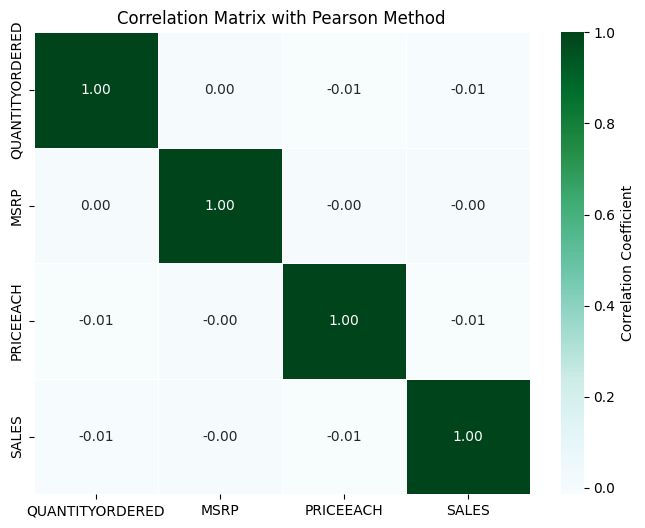

In [ ]:
num_corr = final_df[['QUANTITYORDERED', 'MSRP', 'PRICEEACH', 'SALES']].corr(method='pearson')
# Create the heatmap with annotations
plt.figure(figsize=(8, 6))
sns.heatmap(num_corr, annot=True, cmap="BuGn", linewidths=0.5, fmt=".2f", cbar_kws={'label': 'Correlation Coefficient'})
plt.title('Correlation Matrix with Pearson Method')
plt.show()

**Summary:-**

1. Sampling Bias in Simulated Data
2. Random Noise in Simulated Data

There may be reason to affect the correlation

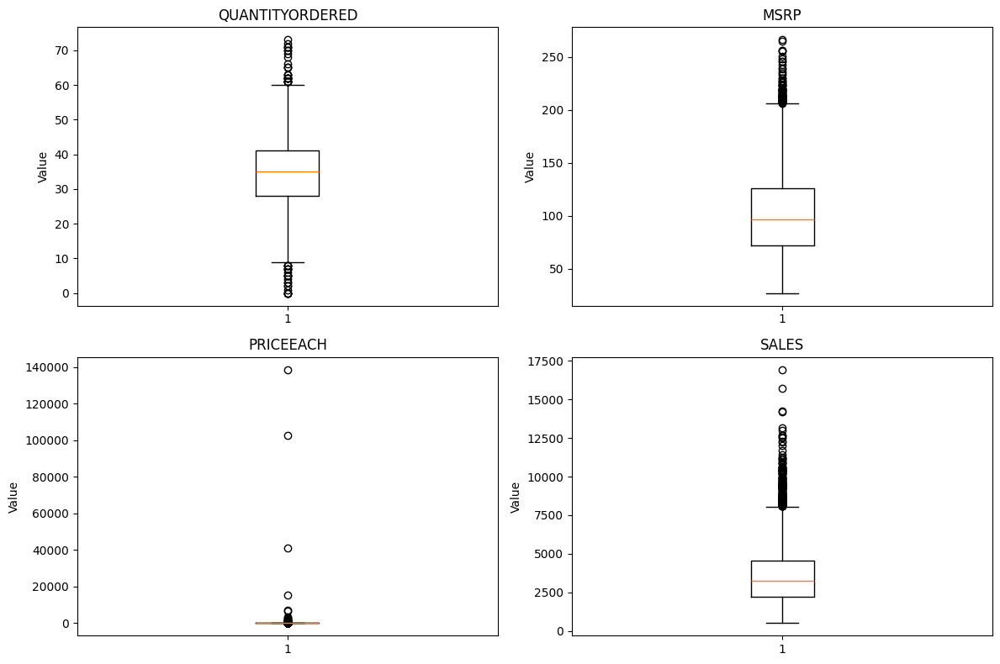

In [ ]:
#checking the outliers in each numerical features
# Plotting the box plots for each column
plt.figure(figsize=(12, 8))

# Subplot for QUANTITYORDERED
plt.subplot(2, 2, 1)
plt.boxplot(final_df['QUANTITYORDERED'])
plt.title('QUANTITYORDERED')
plt.ylabel('Value')

# Subplot for MSRP
plt.subplot(2, 2, 2)
plt.boxplot(final_df['MSRP'])
plt.title('MSRP')
plt.ylabel('Value')

# Subplot for PRICEEACH
plt.subplot(2, 2, 3)
plt.boxplot(final_df['PRICEEACH'])
plt.title('PRICEEACH')
plt.ylabel('Value')

# Subplot for SALES
plt.subplot(2, 2, 4)
plt.boxplot(final_df['SALES'])
plt.title('SALES')
plt.ylabel('Value')

# Adjust layout
plt.tight_layout()
plt.show()


**Conclusion:-** Using the box-plot  We see thta in the above plot 'QUANTITYORDERED', 'MSRP', 'SALES' there are outliers included

In [ ]:
# Function to detect outliers using IQR method
def detect_outliers(column):
    Q1 = column.quantile(0.25)
    Q3 = column.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 2 * IQR
    upper_bound = Q3 + 2 * IQR
    return column[(column < lower_bound) | (column > upper_bound)]

# Detecting outliers in each column
outliers_quantity = detect_outliers(final_df['QUANTITYORDERED'])
outliers_msrp = detect_outliers(final_df['MSRP'])
outliers_priceeach = detect_outliers(final_df['PRICEEACH'])
outliers_sales = detect_outliers(final_df['SALES'])

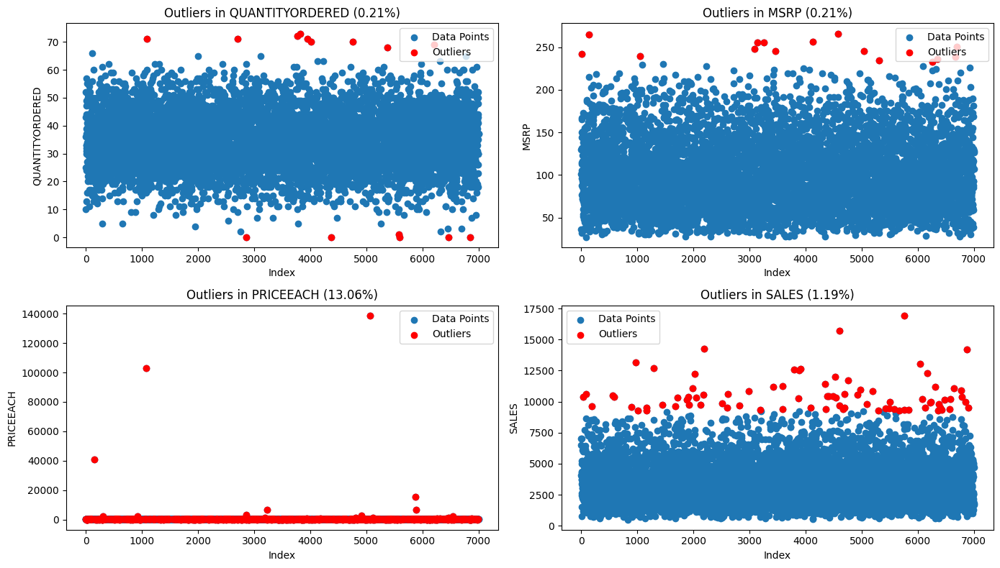

In [ ]:
# Function to calculate the percentage of outliers
def calculate_outlier_percentage(outliers, total):
    return len(outliers) / total * 100

# Plotting the outliers for each column with percentage
plt.figure(figsize=(14, 8))

# QUANTITYORDERED Outliers
plt.subplot(2, 2, 1)
plt.scatter(final_df.index, final_df['QUANTITYORDERED'], label='Data Points')
plt.scatter(outliers_quantity.index, outliers_quantity, color='red', label='Outliers')
percentage_quantity = calculate_outlier_percentage(outliers_quantity, len(final_df['QUANTITYORDERED']))
plt.title(f'Outliers in QUANTITYORDERED ({percentage_quantity:.2f}%)')
plt.xlabel('Index')
plt.ylabel('QUANTITYORDERED')
plt.legend()

# MSRP Outliers
plt.subplot(2, 2, 2)
plt.scatter(final_df.index, final_df['MSRP'], label='Data Points')
plt.scatter(outliers_msrp.index, outliers_msrp, color='red', label='Outliers')
percentage_msrp = calculate_outlier_percentage(outliers_msrp, len(final_df['MSRP']))
plt.title(f'Outliers in MSRP ({percentage_msrp:.2f}%)')
plt.xlabel('Index')
plt.ylabel('MSRP')
plt.legend()

# PRICEEACH Outliers
plt.subplot(2, 2, 3)
plt.scatter(final_df.index, final_df['PRICEEACH'], label='Data Points')
plt.scatter(outliers_priceeach.index, outliers_priceeach, color='red', label='Outliers')
percentage_priceeach = calculate_outlier_percentage(outliers_priceeach, len(final_df['PRICEEACH']))
plt.title(f'Outliers in PRICEEACH ({percentage_priceeach:.2f}%)')
plt.xlabel('Index')
plt.ylabel('PRICEEACH')
plt.legend()

# SALES Outliers
plt.subplot(2, 2, 4)
plt.scatter(final_df.index, final_df['SALES'], label='Data Points')
plt.scatter(outliers_sales.index, outliers_sales, color='red', label='Outliers')
percentage_sales = calculate_outlier_percentage(outliers_sales, len(final_df['SALES']))
plt.title(f'Outliers in SALES ({percentage_sales:.2f}%)')
plt.xlabel('Index')
plt.ylabel('SALES')
plt.legend()

# Adjust layout
plt.tight_layout()
plt.show()

In [ ]:
13*7000/100

910.0

In [ ]:
# df.boxplot(column='SALES', by='PRODUCTLINE')
final_df.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,ORDERDATE,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
0,Reggio Emilia,Italy,Small,10,89.3,7028.4,100.9,2012-11-22,Trains,11,2012,4
1,Boston,USA,Small,52,71.9,6494.0,36.0,2007-12-28,Trucks and Buses,12,2007,4
2,Osaka,Japan,Small,43,98.6,4083.2,129.8,2011-01-14,Trucks and Buses,1,2011,1
3,Nantes,France,Medium,25,111.4,2440.3,88.0,2005-07-15,Motorcycles,7,2005,3
4,Koln,Germany,Medium,36,91.1,3353.4,114.6,2015-04-13,Planes,4,2015,2


In [ ]:
# Function to detect and remove outliers using the IQR method
def remove_outliers(final_df, column_name):
    Q1 = final_df[column_name].quantile(0.25)
    Q3 = final_df[column_name].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 2.0 * IQR
    upper_bound = Q3 + 2.0 * IQR
    # Remove outliers
    df_filtered = final_df[(final_df[column_name] >= lower_bound) & (final_df[column_name] <= upper_bound)]
    return df_filtered

# Create a copy of the original DataFrame to remove outliers from each specified column in sequence
df_no_outliers = final_df.copy()

# Remove outliers from each column iteratively
df_no_outliers = remove_outliers(df_no_outliers, 'QUANTITYORDERED')
df_no_outliers = remove_outliers(df_no_outliers, 'MSRP')
df_no_outliers = remove_outliers(df_no_outliers, 'PRICEEACH')
df_no_outliers = remove_outliers(df_no_outliers, 'SALES')

In [ ]:
final_df.shape

(7000, 12)

In [ ]:
# Resulting DataFrame after removing outliers
df_no_outliers

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,ORDERDATE,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
0,Reggio Emilia,Italy,Small,10,89.3,7028.4,100.9,2012-11-22,Trains,11,2012,4
2,Osaka,Japan,Small,43,98.6,4083.2,129.8,2011-01-14,Trucks and Buses,1,2011,1
3,Nantes,France,Medium,25,111.4,2440.3,88.0,2005-07-15,Motorcycles,7,2005,3
4,Koln,Germany,Medium,36,91.1,3353.4,114.6,2015-04-13,Planes,4,2015,2
5,Liverpool,UK,Small,31,95.5,2603.2,105.2,2007-06-01,Vintage Cars,6,2007,2
...,...,...,...,...,...,...,...,...,...,...,...,...
6995,Burlingame,USA,Small,18,108.7,2486.6,92.5,2013-04-13,Vintage Cars,4,2013,2
6996,Pasadena,USA,Large,35,101.9,2165.1,116.6,2003-10-23,Ships,10,2003,4
6997,Paris,France,Large,30,114.0,1719.9,127.8,2009-07-16,Ships,7,2009,3
6998,Stavern,Norway,Small,37,98.9,4736.8,126.4,2004-02-11,Ships,2,2004,1


Insufficient Removal Threshold: The IQR method might not fully eliminate all outliers if the distribution of the data has heavy tails or extreme values that fall just within the typical IQR threshold of 1.5. Increasing the multiplier (e.g., using 2.0 * IQR instead of 1.5 * IQR) might help to capture these.


**Keep the Outliers:-**

***How to handle:***
Use **log transformation** or **scaling** to reduce the impact of outliers on your model.


In [ ]:
df1= df_no_outliers.copy()

In [ ]:
from sklearn.preprocessing import MinMaxScaler

# List to store scaled data for each product line
final_df_list = []

# Get unique product lines
unique_product_lines = df1['PRODUCTLINE'].unique()

# Iterate through each product line
for product_line in unique_product_lines:
    # Filter the data for the current product line
    product_data = df1[df1['PRODUCTLINE'] == product_line].copy()
    product_data['ORDERDATE'] = product_data['ORDERDATE'] + pd.offsets.MonthEnd(0)
    # Define the numerical columns to be scaled
    numerical_cols = ['QUANTITYORDERED', 'PRICEEACH', 'SALES', 'MSRP']

    # Scale the numerical columns using MinMaxScaler
    scaler = MinMaxScaler()
    product_data[numerical_cols] = scaler.fit_transform(product_data[numerical_cols])

    # Append the scaled data to the list
    final_df_list.append(product_data)

# Combine all scaled dataframes into a single dataframe
scale_df = pd.concat(final_df_list, ignore_index=True)


In [ ]:
scale_df.sample(5)

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,ORDERDATE,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
1866,NYC,USA,Small,0.354839,0.539801,0.535017,0.253049,2005-02-28,Motorcycles,2,2005,1
699,Makati City,Philippines,Small,0.611111,0.535000,0.779585,0.528793,2008-10-31,Trains,10,2008,4
345,Reims,France,Large,0.462963,0.625000,0.642896,0.299950,2010-03-31,Trains,3,2010,1
2035,Boston,USA,Medium,0.193548,0.340796,0.526096,0.392785,2008-10-31,Motorcycles,10,2008,4
1320,Newark,USA,Medium,0.245614,0.539604,0.279043,0.306725,2003-12-31,Trucks and Buses,12,2003,4


In [ ]:
scale_df.shape

(5984, 12)

In [ ]:
166*7.2/100

11.952

In [ ]:
7000-5984

1016

***Conclusion:-***After removing the outlier the data shape is converted from (7000,12) to (5984,12) means 1016 values have the outliers in the data frame

## ***Categorical Features Analysis***

To check the correlation between categorical features, you can use the ***chi-square test*** of independence:

**Set up the null hypothesis:** The null hypothesis is that the two variables being tested are independent.

**Perform the test:** The test is performed using a contingency table or frequency count table between the two variables.

**Get the result:** The test produces a probability that the null hypothesis is true.


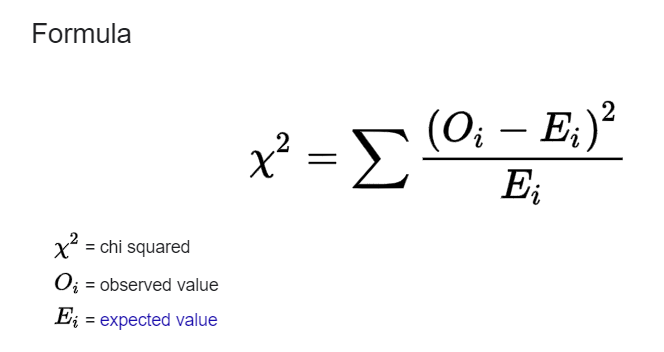

In [ ]:
# # categorical list without
# tmp_1 = ['PRODUCTLINE','CITY','COUNTRY','DEALSIZE']
# # correlation of the categorical features
# df_1 = scale_df[tmp_1]
# chi_square = pd.DataFrame(abs(np.random.randn(len(tmp_1),len(tmp_1))), columns= tmp_1, index = tmp_1)

# # cramer V statistics for correlation between categorical features
# def cramers_corrected_stat(confusion_matrix):
#     chi2 = ss.chi2_contingency(confusion_matrix)[0]
#     n = confusion_matrix.sum().sum()
#     phi2 = chi2/n
#     r,k = confusion_matrix.shape
#     phi2corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))
#     rcorr = r - ((r-1)**2)/(n-1)
#     kcorr = k - ((k-1)**2)/(n-1)
#     return np.sqrt(phi2corr / min( (kcorr-1), (rcorr-1)))

# # chi square dataframe of categorical features
# for i in tmp_1:
#     temp_list = [k for k in tmp_1 if k!=i]
#     for j in temp_list:
#         confusion_matrix = pd.crosstab(df_1[i],df_1[j])
#         val = cramers_corrected_stat(confusion_matrix)
#         chi_square[i][j] = float(val) # column, row
#         chi_square[i][i] = 1

# # heatmap of categorical features (exclude the complex string)
# sns.heatmap(chi_square, cmap='YlOrRd', annot=True, linewidths=0.5, fmt=".2f", cbar_kws={'label': 'Correlation Coefficient'})
# # chi_square

**Key insights from the heatmap:**

***PRODUCTLINE and PRODUCTCODE*** have a strong positive correlation*** (0.98)***.

***CITY and COUNTRY*** are also highly correlated ***(0.99)***, suggesting they are closely related.

***DEALSIZE***  shows moderate correlation with ***PRODUCTCODE (0.42)***, but low or no significant correlation with the other variables.

***PRODUCTLINE*** has moderate correlation with ***CITY (0.31)*** but weak correlations with the rest of the variables.

In [ ]:
# df1.isnull().sum()

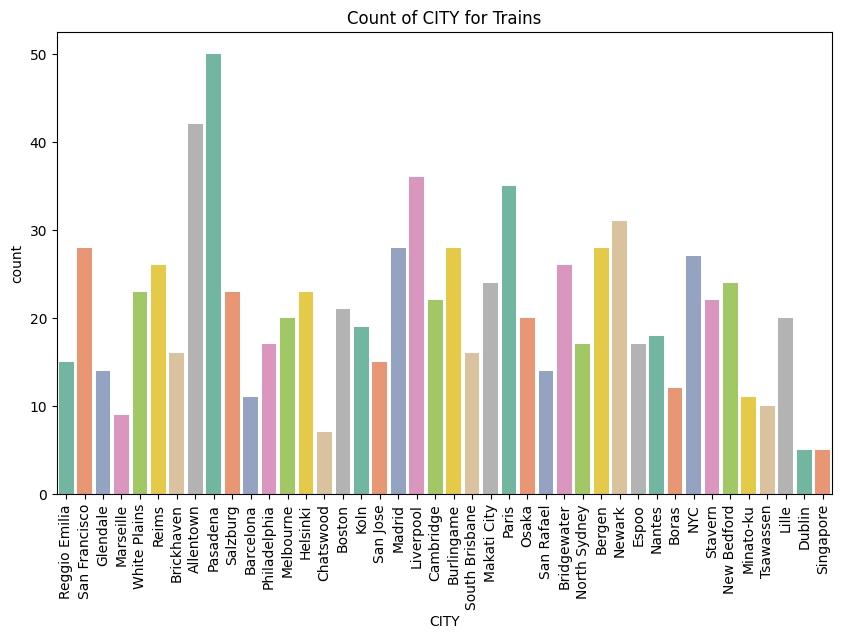

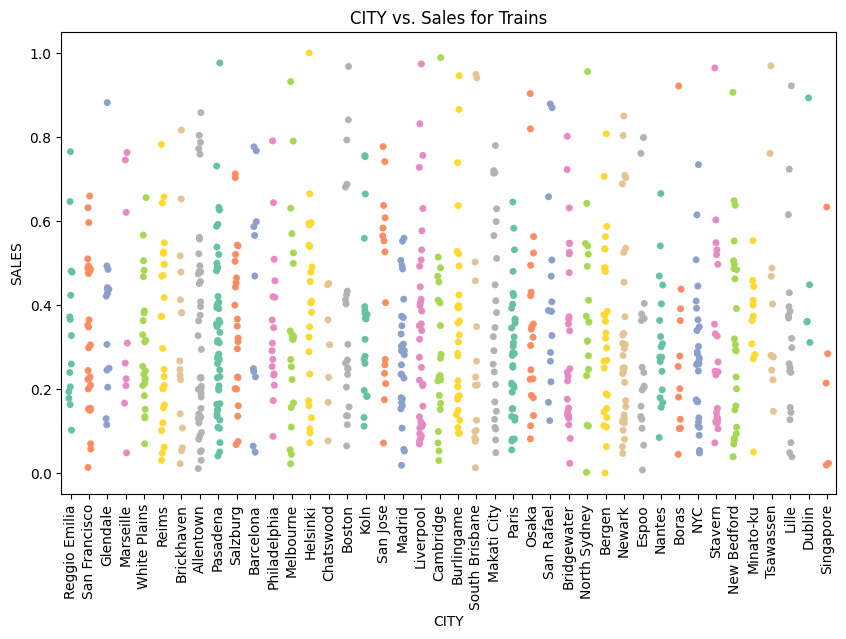

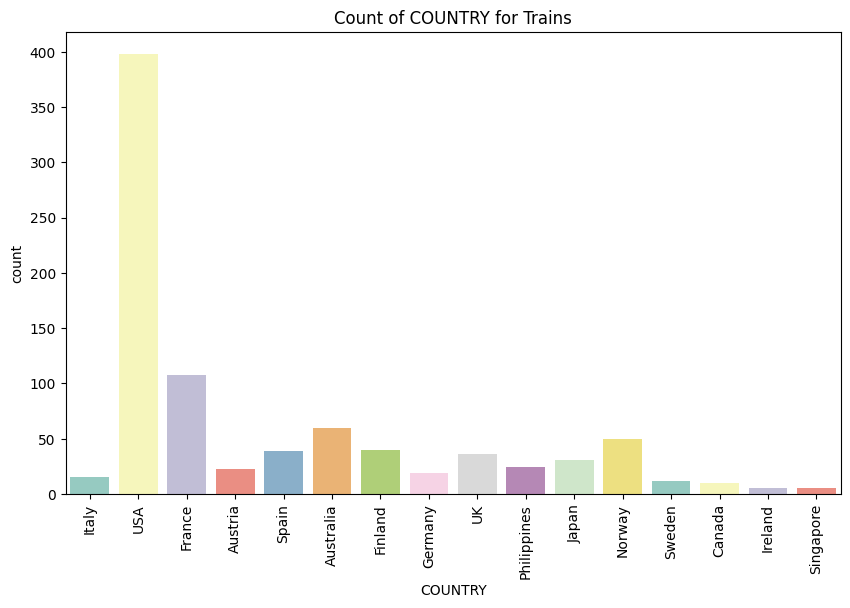

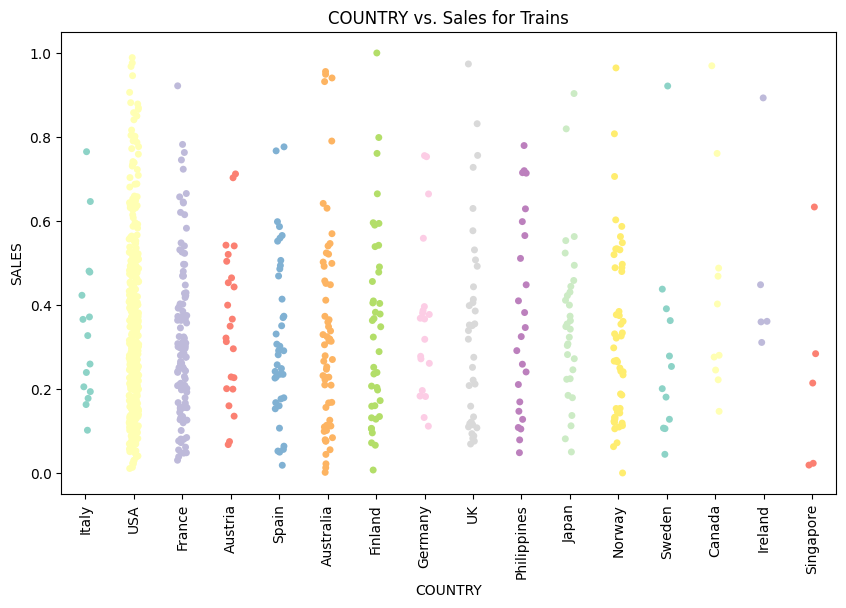

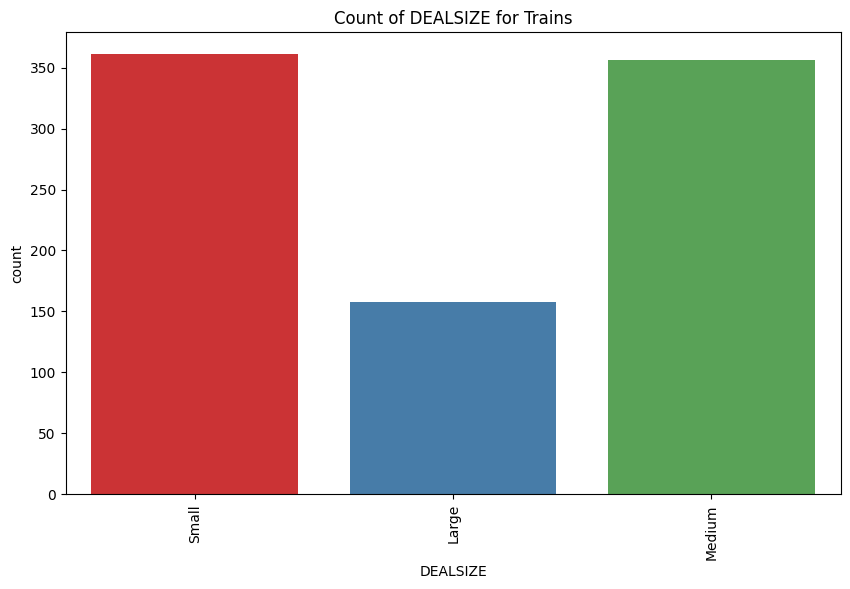

...

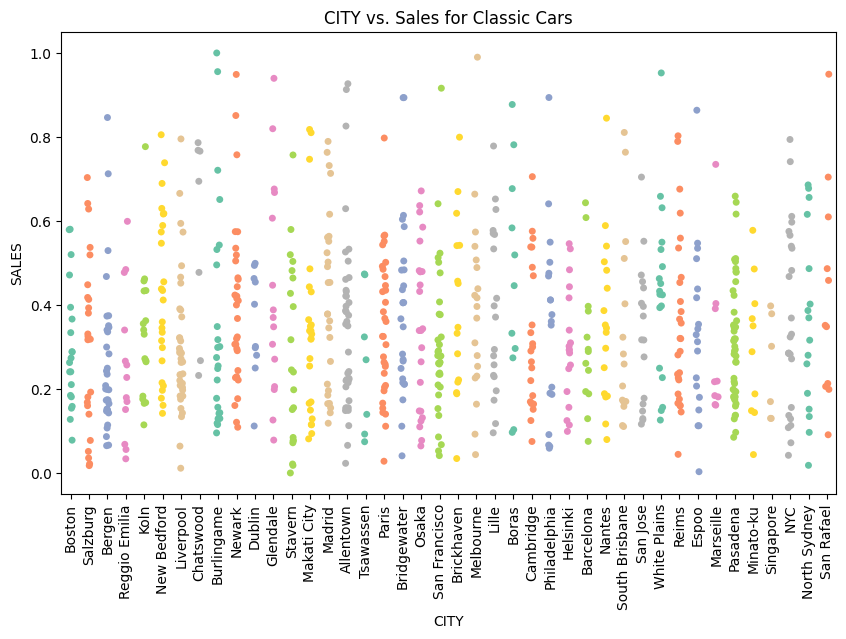

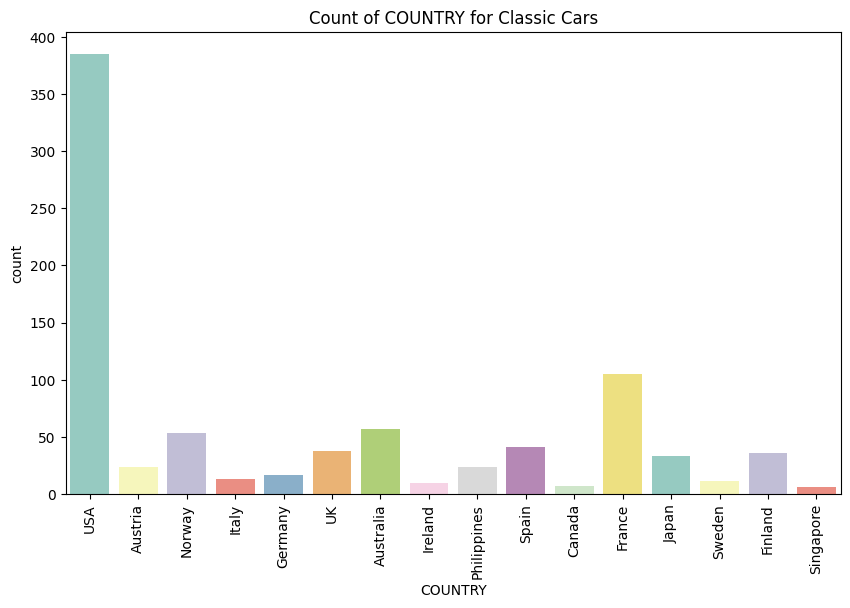

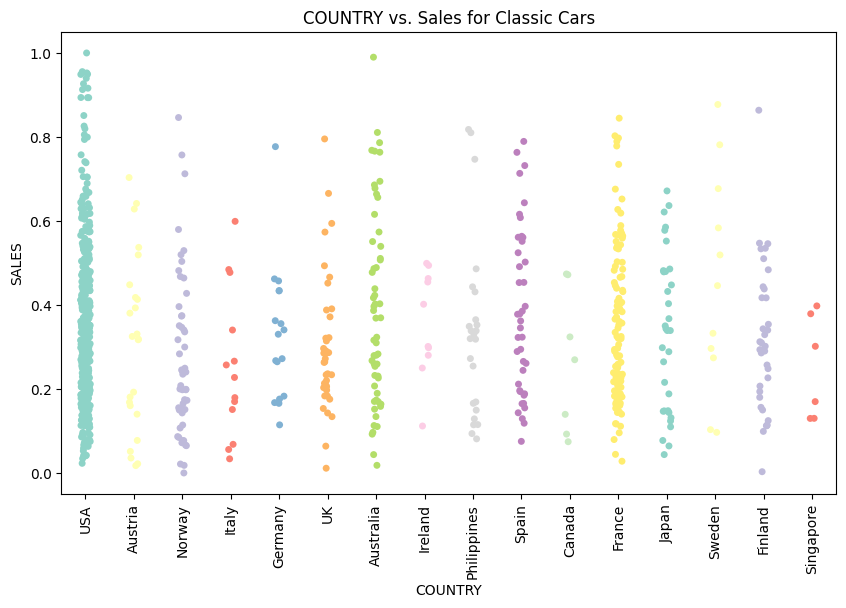

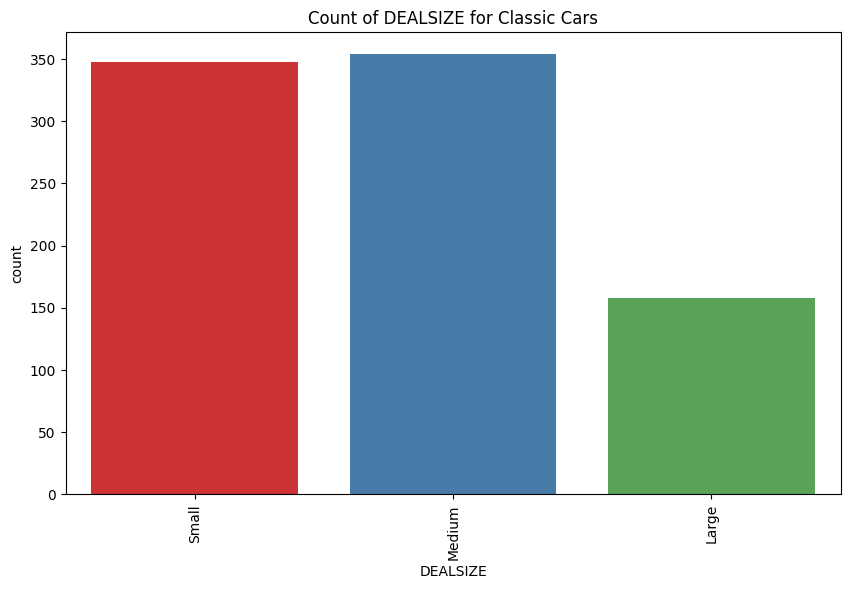

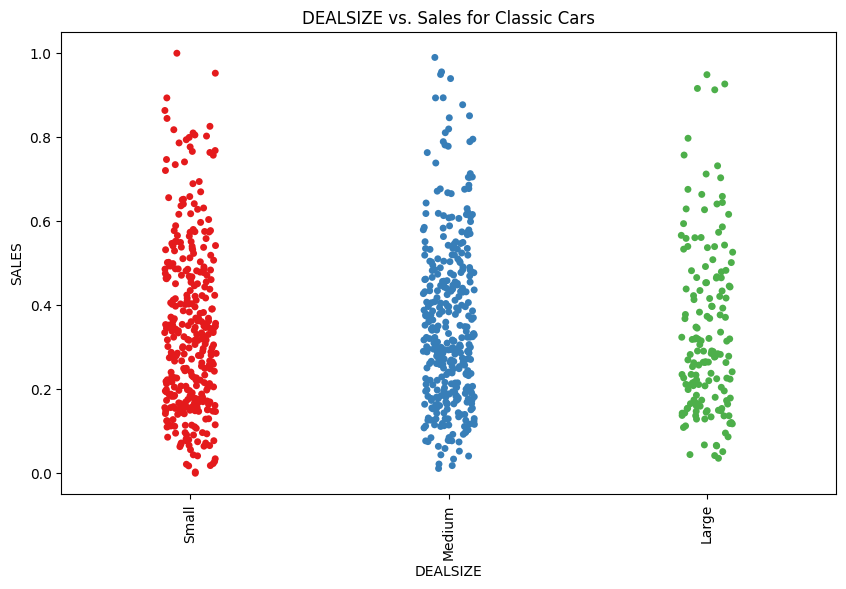

In [ ]:
###impact of categorical var on sales
# Define a color palette for each categorical feature
palette_city = sns.color_palette("Set2", len(scale_df['CITY'].unique()))
palette_country = sns.color_palette("Set3", len(scale_df['COUNTRY'].unique()))
palette_dealsize = sns.color_palette("Set1", len(scale_df['DEALSIZE'].unique()))

# Dictionary to map feature to respective palette
feature_palette = {
    'CITY': palette_city,
    'COUNTRY': palette_country,
    'DEALSIZE': palette_dealsize
}


unique_product_codes = scale_df['PRODUCTLINE'].unique()
categorical_features = ['CITY', 'COUNTRY', 'DEALSIZE']

for product_code in unique_product_codes:
    product_data = scale_df[scale_df['PRODUCTLINE'] == product_code].copy()

    for feature in categorical_features:
        # Plot count of each category in the feature
        plt.figure(figsize=(10, 6))
        sns.countplot(x=feature, data=product_data, palette=feature_palette[feature])
        plt.xticks(rotation=90)
        plt.title(f'Count of {feature} for {product_code}')
        plt.show()
        plt.figure(figsize=(10, 6))
        sns.stripplot(x=feature, y='SALES', data=product_data, jitter=True, palette=feature_palette[feature])
        plt.xticks(rotation=90)
        plt.title(f'{feature} vs. Sales for {product_code}')
        plt.show()


## ***Moving Average for Each Product***

***Best Practice:***

**For Time Series Forecasting:** Using ORDERDATE as an index is appropriate and often necessary.

**For General Machine Learning:** It’s better to keep ORDERDATE as a regular column so that you can engineer time-based features from it. If you do use it as an index, ensure you extract the necessary features from the date before applying the machine learning model.

In [ ]:
scale_df.shape

(5984, 12)

In [ ]:
scale_df.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,ORDERDATE,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
0,Reggio Emilia,Italy,Small,0.037037,0.2525,0.764933,0.364547,2012-11-30,Trains,11,2012,4
1,San Francisco,USA,Large,0.666667,0.1450,0.013328,0.687031,2007-05-31,Trains,5,2007,2
2,Glendale,USA,Medium,0.907407,0.4800,0.437061,0.610916,2010-01-31,Trains,1,2010,1
3,Marseille,France,Small,0.537037,0.4825,0.763078,0.695043,2015-02-28,Trains,2,2015,1
4,White Plains,USA,Small,0.407407,0.0050,0.183789,0.038558,2008-11-30,Trains,11,2008,4


In [ ]:
df2=scale_df.copy()

In [ ]:
df2.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,ORDERDATE,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
0,Reggio Emilia,Italy,Small,0.037037,0.2525,0.764933,0.364547,2012-11-30,Trains,11,2012,4
1,San Francisco,USA,Large,0.666667,0.1450,0.013328,0.687031,2007-05-31,Trains,5,2007,2
2,Glendale,USA,Medium,0.907407,0.4800,0.437061,0.610916,2010-01-31,Trains,1,2010,1
3,Marseille,France,Small,0.537037,0.4825,0.763078,0.695043,2015-02-28,Trains,2,2015,1
4,White Plains,USA,Small,0.407407,0.0050,0.183789,0.038558,2008-11-30,Trains,11,2008,4


In [ ]:
# Sort df2 by ORDERDATE
df2 = df2.sort_values(by='ORDERDATE')
# Set ORDERDATE as the index
df2.set_index('ORDERDATE', inplace=True)

In [ ]:
df2.shape

(5984, 11)

In [ ]:
#this df has filtered dataframe
df2.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2003-01-31,Espoo,Finland,Medium,0.844828,0.538462,0.308708,0.039735,Planes,1,2003,1
2003-01-31,Salzburg,Austria,Large,0.534483,0.503722,0.296373,0.512990,Planes,1,2003,1
2003-01-31,Lille,France,Large,0.600000,0.873418,0.313895,0.321839,Vintage Cars,1,2003,1
2003-01-31,Bergen,Norway,Large,0.354839,0.420398,0.274066,0.268293,Motorcycles,1,2003,1
2003-01-31,Helsinki,Finland,Small,0.648148,0.647500,0.664652,0.691037,Trains,1,2003,1


In [ ]:
# df2.set_index('ORDERDATE', inplace=True) #convert the ORDERDATE in index so helpful in

In [ ]:
# df2[(df2['SALES'] >= 0.2) & (df2['SALES'] <= 3)]

In [ ]:
df2.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2003-01-31,Espoo,Finland,Medium,0.844828,0.538462,0.308708,0.039735,Planes,1,2003,1
2003-01-31,Salzburg,Austria,Large,0.534483,0.503722,0.296373,0.512990,Planes,1,2003,1
2003-01-31,Lille,France,Large,0.600000,0.873418,0.313895,0.321839,Vintage Cars,1,2003,1
2003-01-31,Bergen,Norway,Large,0.354839,0.420398,0.274066,0.268293,Motorcycles,1,2003,1
2003-01-31,Helsinki,Finland,Small,0.648148,0.647500,0.664652,0.691037,Trains,1,2003,1


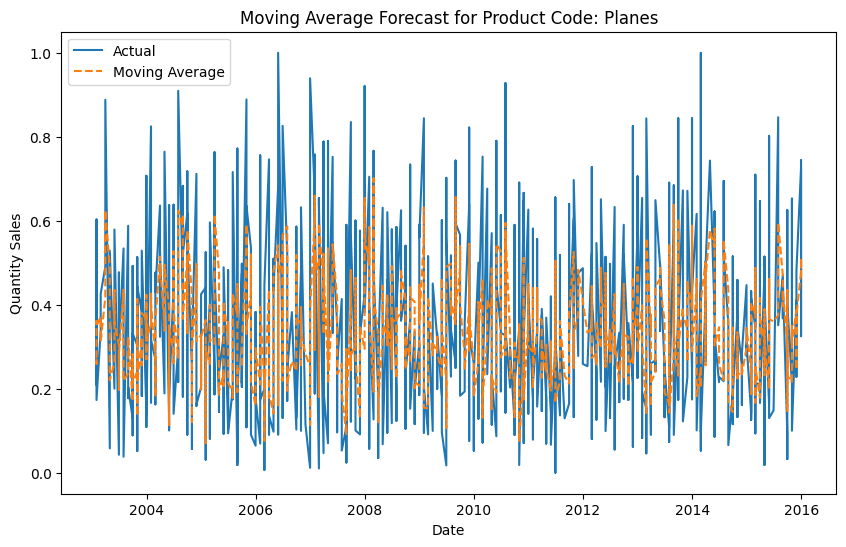

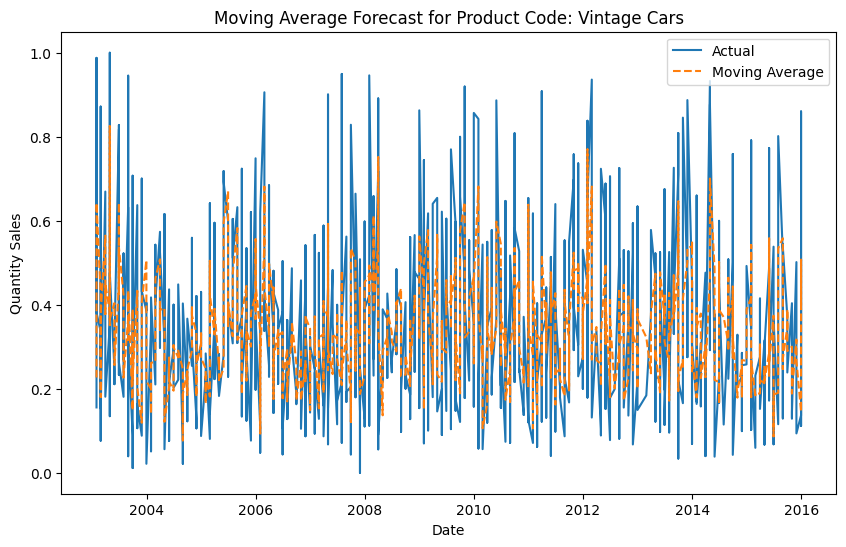

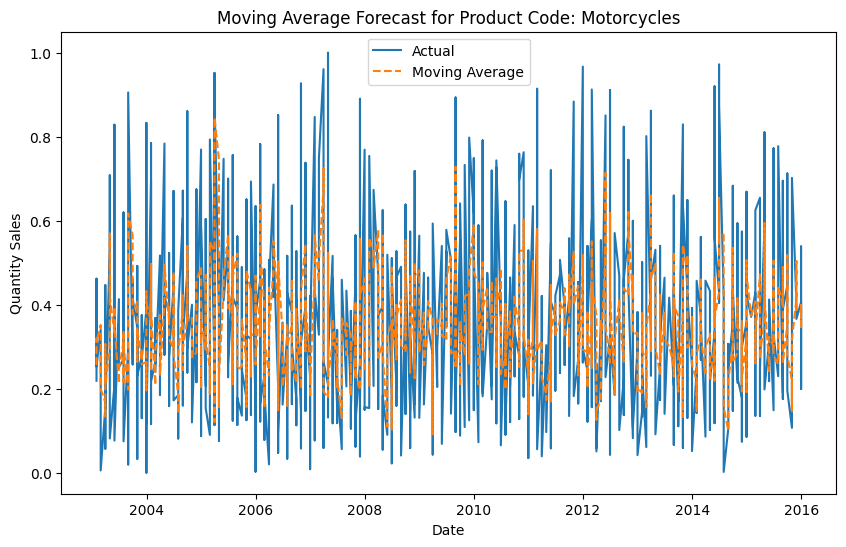

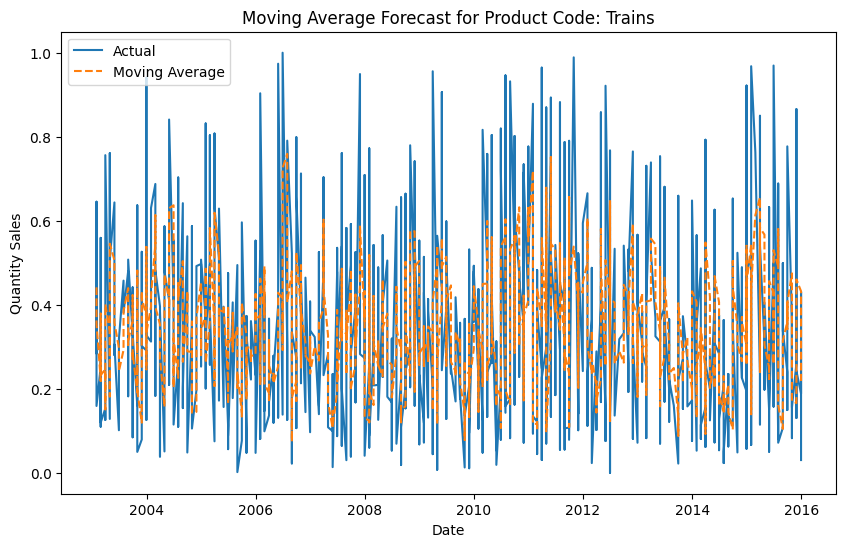

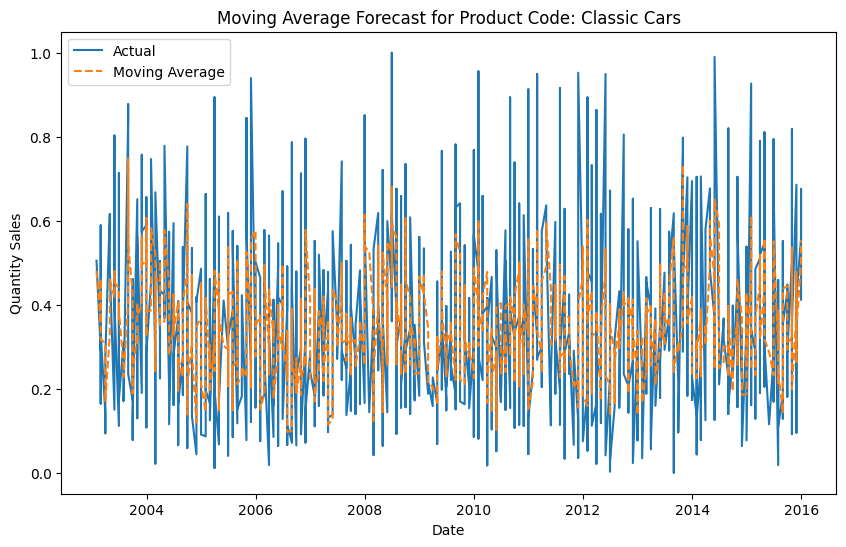

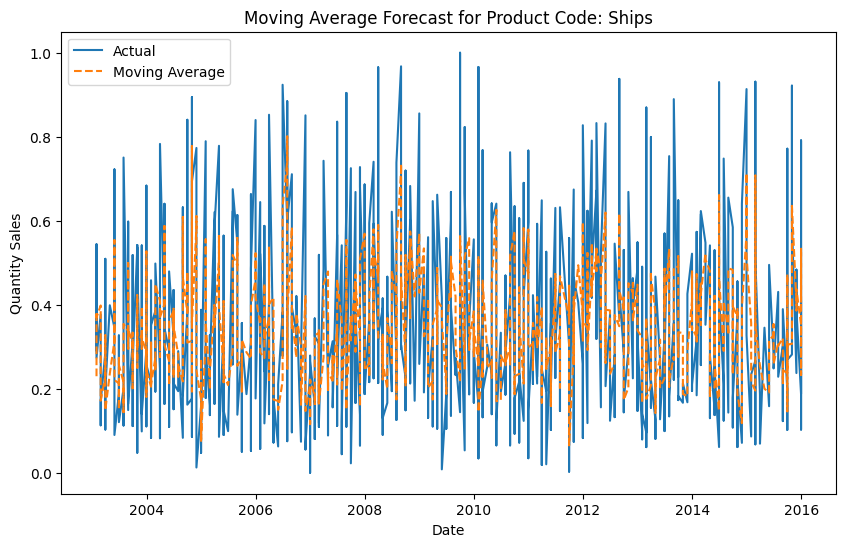

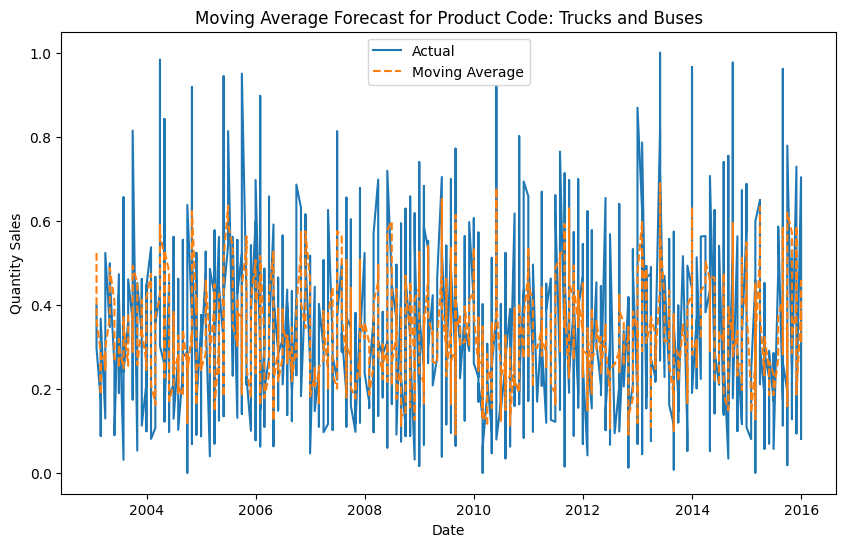

In [ ]:
unique_product_codes = df2['PRODUCTLINE'].unique()

# Dictionary to store the moving average results for each product
moving_avg_results = {}

for product_code in unique_product_codes:
    # Filter data for the current product
    product_data = df2[df2['PRODUCTLINE'] == product_code].copy()

    # Sort by the index (ORDERDATE)
    product_data = product_data.sort_index()

    # Calculate the moving average (for 3-period)
    product_data['Moving_Avg'] = product_data['SALES'].rolling(window=3).mean()

    # Drop the initial rows where moving average could not be computed
    product_data = product_data.dropna(subset=['Moving_Avg'])

    # Store the result in the dictionary
    moving_avg_results[product_code] = product_data

    # Plot the results
    plt.figure(figsize=(10, 6))
    plt.plot(product_data.index, product_data['SALES'], label='Actual')
    plt.plot(product_data.index, product_data['Moving_Avg'], label='Moving Average', linestyle='--')
    plt.title(f'Moving Average Forecast for Product Code: {product_code}')
    plt.xlabel('Date')
    plt.ylabel('Quantity Sales')
    plt.legend()
    plt.show()


In [ ]:
moving_avg_results[product_code].head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID,Moving_Avg
ORDERDATE,,,,,,,,,,,,
2003-01-31,Salzburg,Austria,Small,0.649123,0.309406,0.399487,0.591033,Trucks and Buses,1,2003,1,0.523094
2003-01-31,Osaka,Japan,Medium,0.280702,0.514851,0.391013,0.666484,Trucks and Buses,1,2003,1,0.466354
2003-01-31,San Francisco,USA,Large,0.421053,0.485149,0.297515,0.568070,Trucks and Buses,1,2003,1,0.362672
2003-02-28,Allentown,USA,Large,0.596491,0.193069,0.172883,0.588846,Trucks and Buses,2,2003,1,0.287137
2003-02-28,Newark,USA,Large,0.403509,0.636139,0.087422,0.125205,Trucks and Buses,2,2003,1,0.185940


For 5 moving Average

In [ ]:
# df2[df2['PRODUCTLINE']=='Motorcycles']['COUNTRY'].unique()

In [ ]:

unique_product_codes = df2['PRODUCTLINE'].unique()
# Dictionary to store the moving average results for each product
moving_avg_results1 = {}

for product_code in unique_product_codes:
    product_data = df2[df2['PRODUCTLINE'] == product_code]  #filter
    #Sort by ORDERDATE
    product_data = product_data.sort_values('ORDERDATE')
    #moving average (for 5-period)
    product_data['Moving_Avg'] = product_data['SALES'].rolling(window=5).mean()
    # Drop the initial rows where moving average could not be computed
    product_data = product_data.dropna(subset=['Moving_Avg'])
    # Store
    moving_avg_results1[product_code] = product_data
    # print(moving_avg_results[product_code])

## ***Evaluation Metrics***

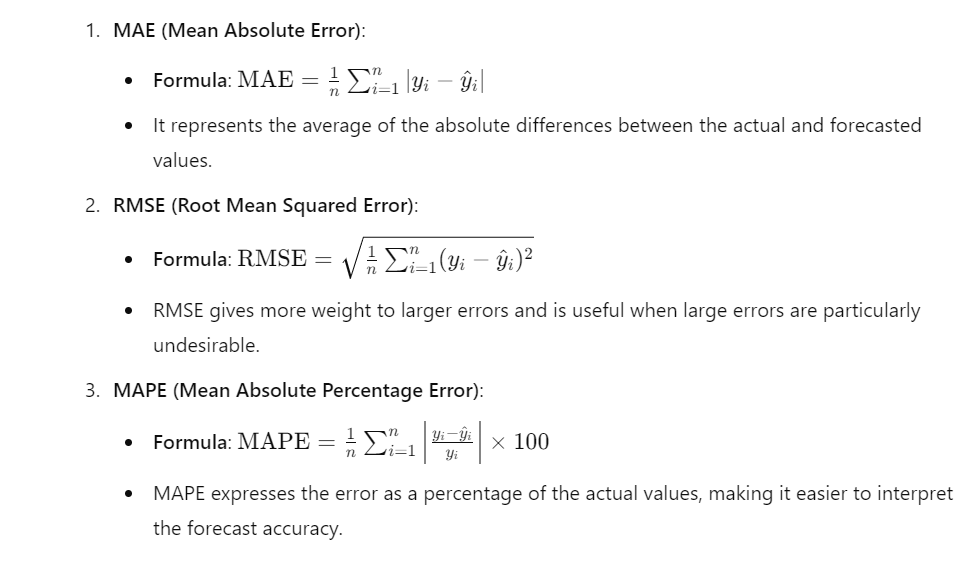

In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error

In [ ]:
df2.shape

(5984, 11)

In [ ]:
mae_list = []
rmse_list = []
mape_list = []
product_code_list = []

# Loop through each unique product code
for product_code in unique_product_codes:
    # Filter data for the current product code
    product_data = moving_avg_results[product_code]

    # Ensure there are no missing values
    product_data = product_data.dropna(subset=['SALES', 'Moving_Avg'])

    # Calculate errors
    actual = product_data['SALES']
    forecast = product_data['Moving_Avg']

    # Calculate MAE
    mae = mean_absolute_error(actual, forecast)
    mae_list.append(mae)

    # Calculate RMSE
    rmse = np.sqrt(mean_squared_error(actual, forecast))
    rmse_list.append(rmse)

    # Calculate MAPE
    mape = np.mean(np.abs((actual - forecast) / (actual+0.000000001))) * 100
    mape_list.append(mape)

    # Store the product code
    product_code_list.append(product_code)

# Optional: Create a DataFrame to store and display all metrics together
evaluation_df = pd.DataFrame({
    'Product Code': product_code_list,
    'MAE': mae_list,
    'RMSE': rmse_list,
    'MAPE (%)': mape_list
})

print('Window size for moving average is 3')
print('\n')
print(evaluation_df)

Window size for moving average is 3


       Product Code       MAE      RMSE      MAPE (%)
0            Planes  0.132398  0.165264  2.060245e+07
1      Vintage Cars  0.126210  0.160779  2.529613e+07
2       Motorcycles  0.135736  0.169352  2.536423e+07
3            Trains  0.134594  0.171246  4.096710e+07
4      Classic Cars  0.130539  0.164149  4.291617e+07
5             Ships  0.127129  0.161117  1.363984e+07
6  Trucks and Buses  0.123371  0.154510  1.503181e+07


<Axes: >

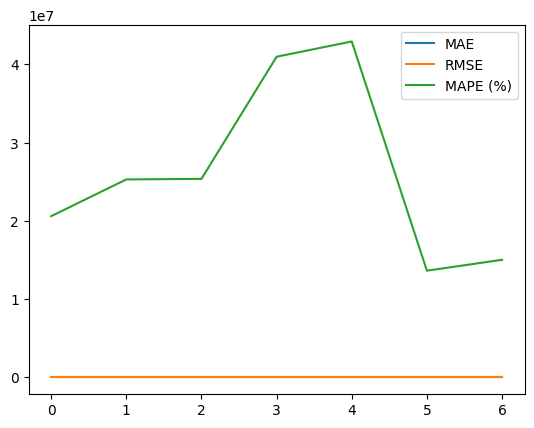

In [ ]:
evaluation_df.plot()

In [ ]:
mae_list = []
rmse_list = []
mape_list = []
product_code_list = []

# Loop through each unique product code
for product_code in unique_product_codes:
    # Filter data for the current product code
    product_data = moving_avg_results1[product_code]

    # Ensure there are no missing values
    product_data = product_data.dropna(subset=['SALES', 'Moving_Avg'])

    # Calculate errors
    actual = product_data['SALES']
    forecast = product_data['Moving_Avg']

    # Calculate MAE
    mae = mean_absolute_error(actual, forecast)
    mae_list.append(mae)

    # Calculate RMSE
    rmse = np.sqrt(mean_squared_error(actual, forecast))
    rmse_list.append(rmse)

    # Calculate MAPE
    mape = np.mean(np.abs((actual - forecast) / (actual+0.000001))) * 100
    mape_list.append(mape)
    # Store the product code
    product_code_list.append(product_code)
# Optional: Create a DataFrame to store and display all metrics together
evaluation_df = pd.DataFrame({
    'Product Code': product_code_list,
    'MAE': mae_list,
    'RMSE': rmse_list,
    'MAPE (%)': mape_list
})

# Display the evaluation metrics
print('Window size for moving average is 5')
print('\n')
print(evaluation_df)

Window size for moving average is 5


       Product Code       MAE      RMSE      MAPE (%)
0            Planes  0.144614  0.179922  21336.603612
1      Vintage Cars  0.138496  0.173377  33276.333371
2       Motorcycles  0.145084  0.181828  37147.453721
3            Trains  0.147796  0.187502  30150.639466
4      Classic Cars  0.140299  0.176002  42683.309990
5             Ships  0.144761  0.181757  29721.667459
6  Trucks and Buses  0.135610  0.171224  17830.041002


<Axes: >

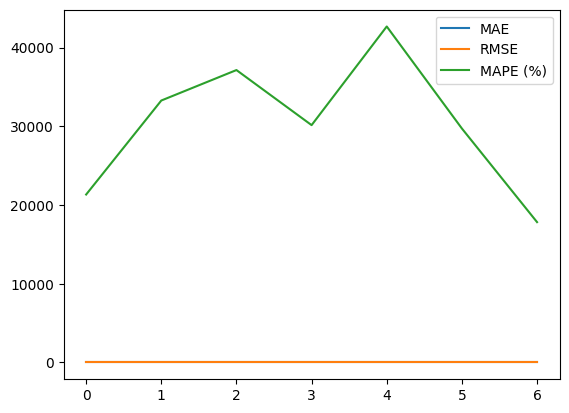

In [ ]:
evaluation_df.plot()

In [ ]:
import pandas as pd
import statsmodels.api as sm
from statsmodels.tsa.arima.model import ARIMA

In [ ]:
df2.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2003-01-31,Espoo,Finland,Medium,0.844828,0.538462,0.308708,0.039735,Planes,1,2003,1
2003-01-31,Salzburg,Austria,Large,0.534483,0.503722,0.296373,0.512990,Planes,1,2003,1
2003-01-31,Lille,France,Large,0.600000,0.873418,0.313895,0.321839,Vintage Cars,1,2003,1
2003-01-31,Bergen,Norway,Large,0.354839,0.420398,0.274066,0.268293,Motorcycles,1,2003,1
2003-01-31,Helsinki,Finland,Small,0.648148,0.647500,0.664652,0.691037,Trains,1,2003,1


### **Naive Forest**

In [ ]:
df2.shape

(5984, 11)

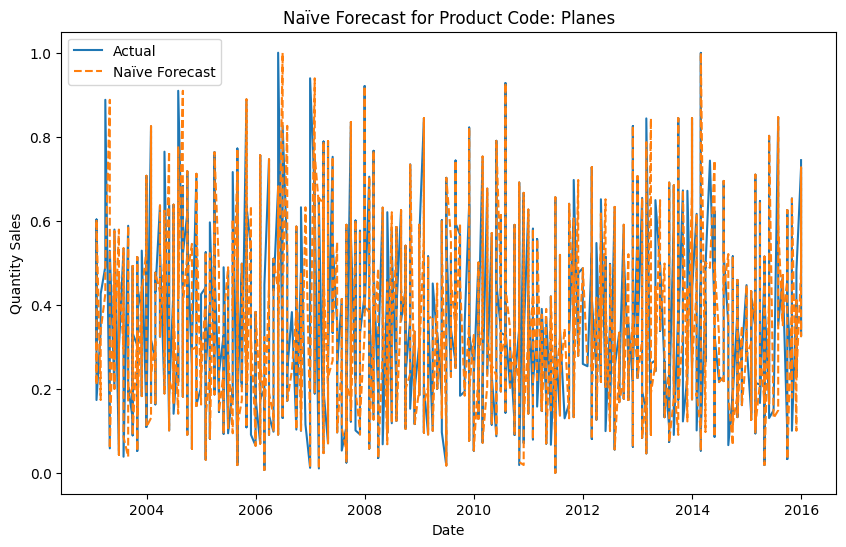

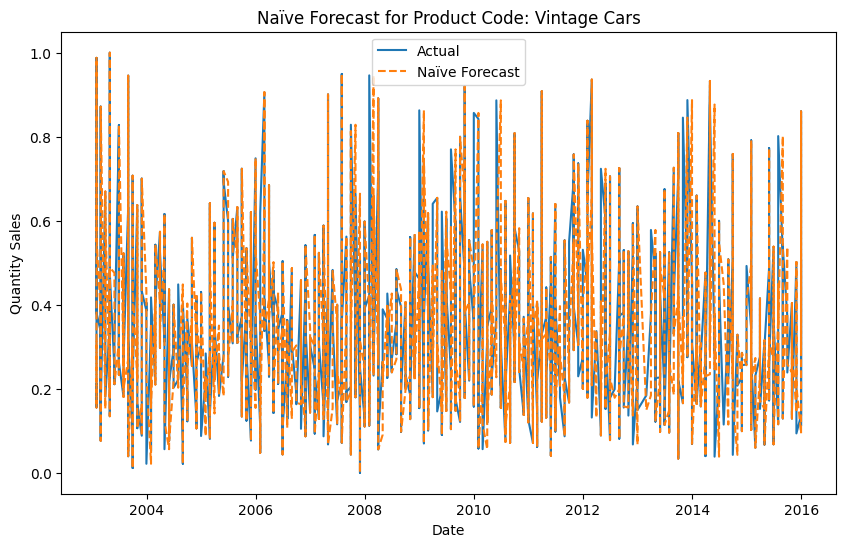

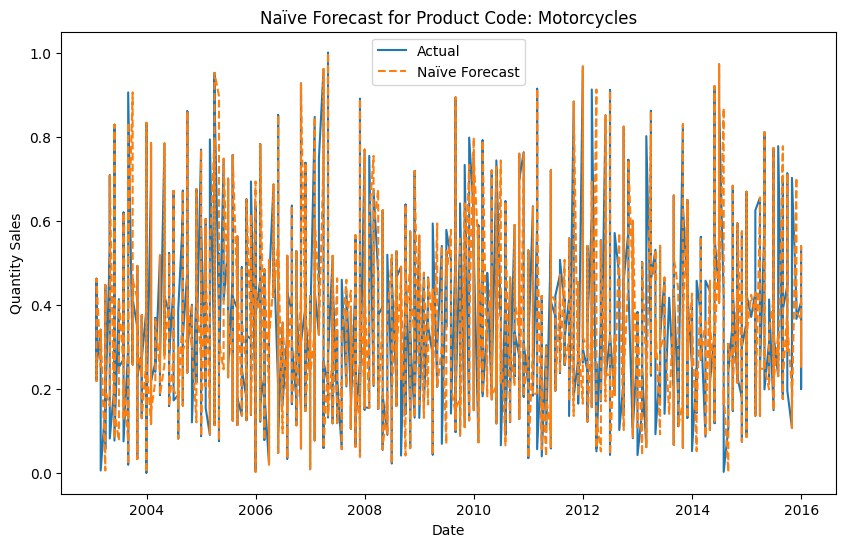

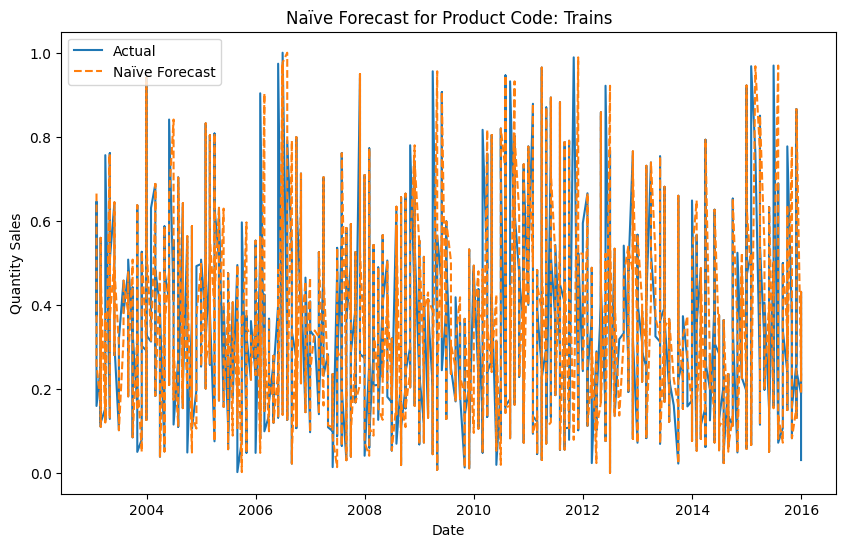

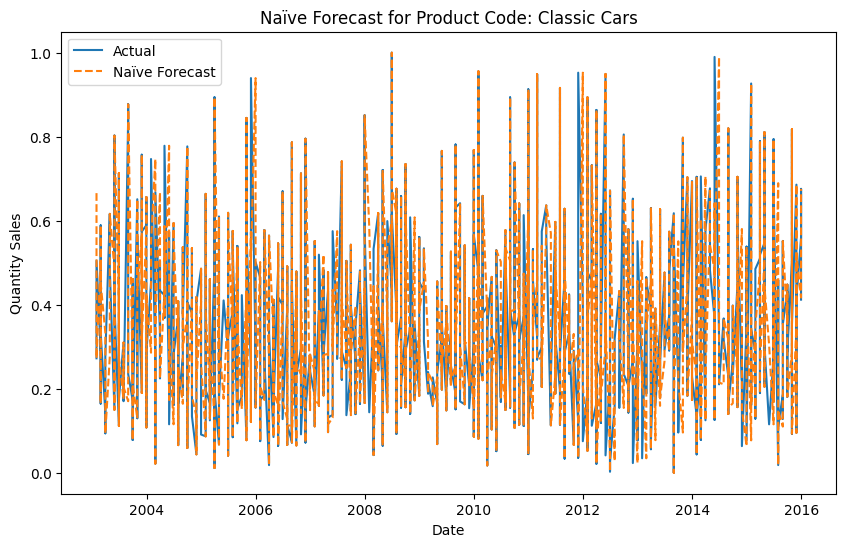

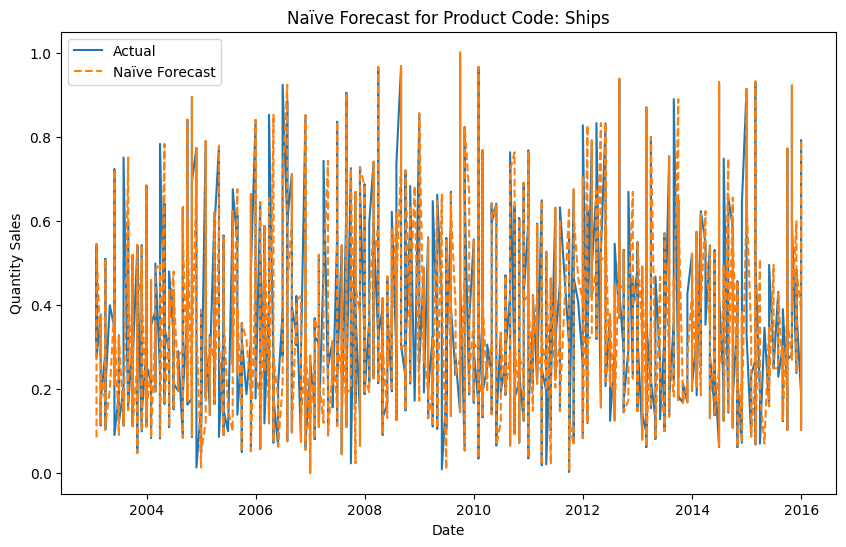

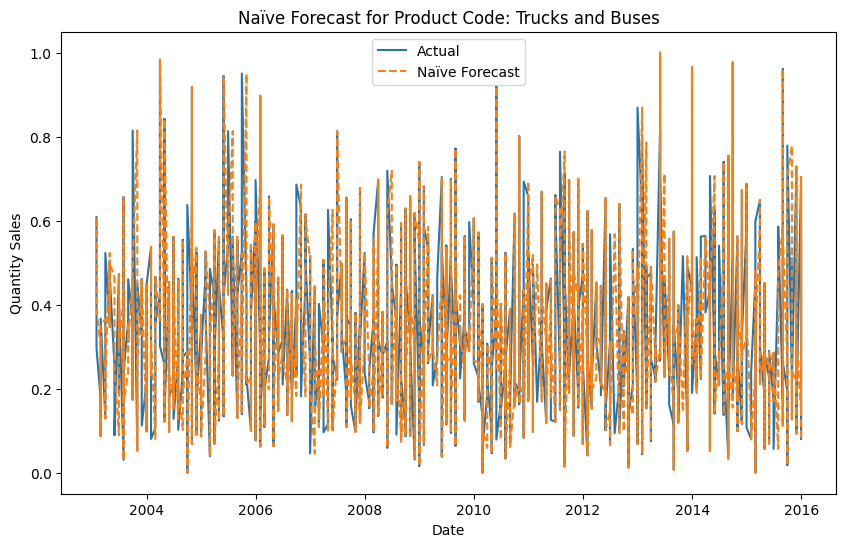

In [ ]:
import matplotlib.pyplot as plt

# Dictionary to store the Naïve forecast results for each product
naive_forecast_results = {}

for product_code in unique_product_codes:
    # Filter data for the current product
    product_data = df2[df2['PRODUCTLINE'] == product_code].copy()

    # Sort by the index (ORDERDATE)
    product_data = product_data.sort_index()

    # Naïve forecast: use the previous period's sales as the forecast for the next period
    product_data['Naive_Forecast'] = product_data['SALES'].shift(1)

    # Drop the initial row where forecast could not be computed (NaN)
    product_data = product_data.dropna(subset=['Naive_Forecast'])

    # Store the result in the dictionary
    naive_forecast_results[product_code] = product_data

    # Plot the results for Naïve Forecast
    plt.figure(figsize=(10, 6))
    plt.plot(product_data.index, product_data['SALES'], label='Actual')
    plt.plot(product_data.index, product_data['Naive_Forecast'], label='Naïve Forecast', linestyle='--')
    plt.title(f'Naïve Forecast for Product Code: {product_code}')
    plt.xlabel('Date')
    plt.ylabel('Quantity Sales')
    plt.legend()
    plt.show()

In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np
import pandas as pd

# Lists to store the evaluation metrics
mae_list = []
rmse_list = []
mape_list = []
product_code_list = []

# Loop over each product code and evaluate the Naïve forecast
for product_code in unique_product_codes:
    # Get the product data from the dictionary of naive forecast results
    product_data = naive_forecast_results[product_code]

    # Define the actual sales and forecasted sales
    actual = product_data['SALES']
    forecast = product_data['Naive_Forecast']

    # Calculate MAE (Mean Absolute Error)
    mae = mean_absolute_error(actual, forecast)
    mae_list.append(mae)

    # Calculate RMSE (Root Mean Squared Error)
    rmse = np.sqrt(mean_squared_error(actual, forecast))
    rmse_list.append(rmse)

    # Calculate MAPE (Mean Absolute Percentage Error)
    mape = np.mean(np.abs((actual - forecast) / (actual + 0.000001))) * 100
    mape_list.append(mape)

    # Store the product code
    product_code_list.append(product_code)

# Optional: Create a DataFrame to store and display all metrics together
evaluation_df = pd.DataFrame({
    'Product Code': product_code_list,
    'MAE': mae_list,
    'RMSE': rmse_list,
    'MAPE (%)': mape_list
})

# Display the evaluation metrics
print('Evaluation metrics for Naïve Forecast:')
print('\n')
print(evaluation_df)


Evaluation metrics for Naïve Forecast:


       Product Code       MAE      RMSE      MAPE (%)
0            Planes  0.226996  0.286182  36173.036509
1      Vintage Cars  0.217477  0.278407  44056.719407
2       Motorcycles  0.231349  0.292467  44958.385532
3            Trains  0.232081  0.296512  35158.368830
4      Classic Cars  0.221944  0.285692  72049.102653
5             Ships  0.221171  0.280088  12673.616424
6  Trucks and Buses  0.212105  0.266046  28555.631167


## ***Exponentially Weighted Moving Average***

Exponentially Weighted Moving Average:-

An exponentially weighted moving average is a way to continuously compute a type of average for a series of numbers, as the numbers arrive. After a value in the series is added to the average, its weight in the average decreases exponentially over time. This biases the average towards more recent data. EWMAs are useful for several reasons, chiefly their inexpensive computational and memory cost, as well as the fact that they represent the recent central tendency of the series of values.

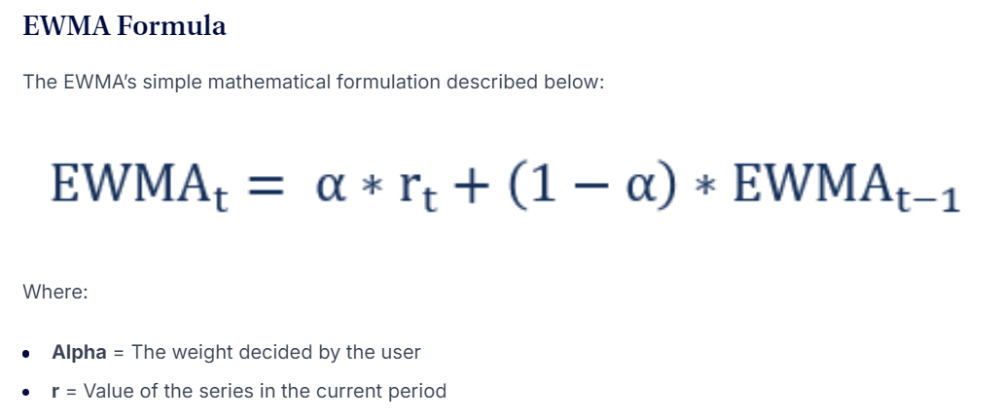

**1)** if a = 10%(small), most of the contribution will come from the previous value of the signal. In this case, “smoothing” will be very strong.

**2)** if a = 90%(large), most of the contribution will come from the current value of the signal. In this case, “smoothing” will be minimum.

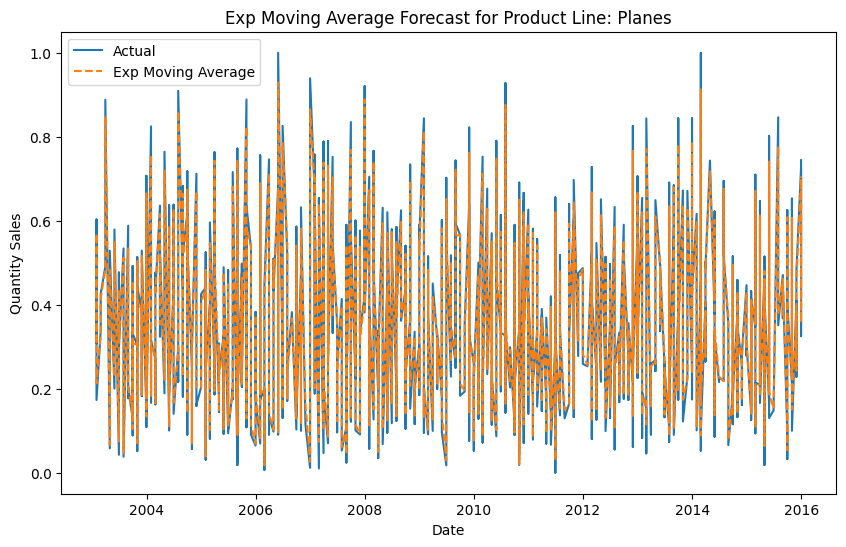

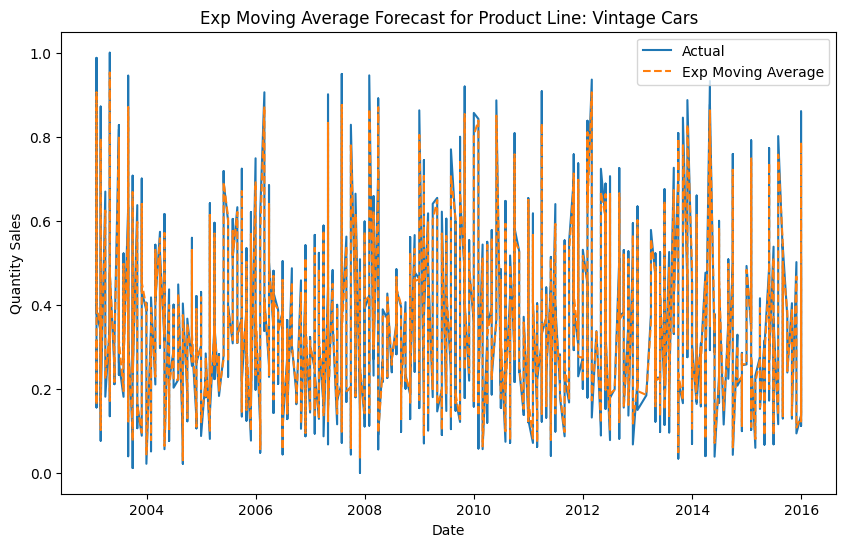

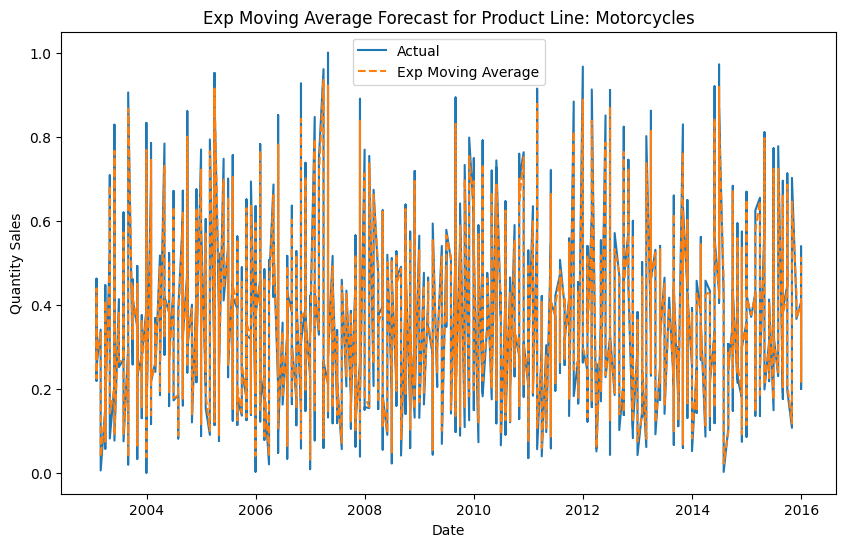

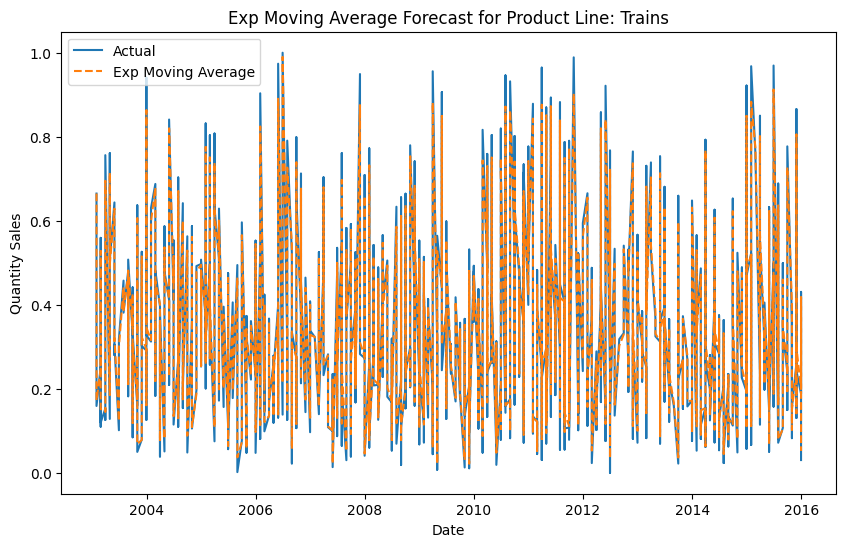

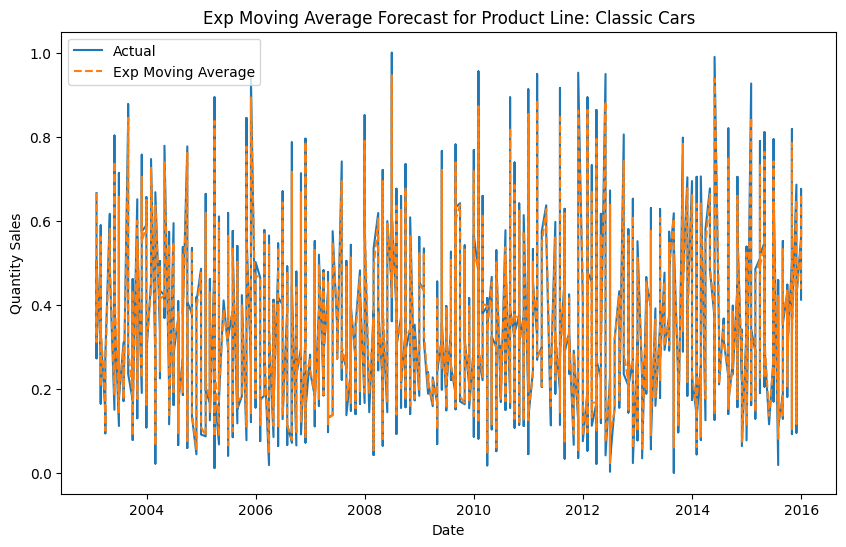

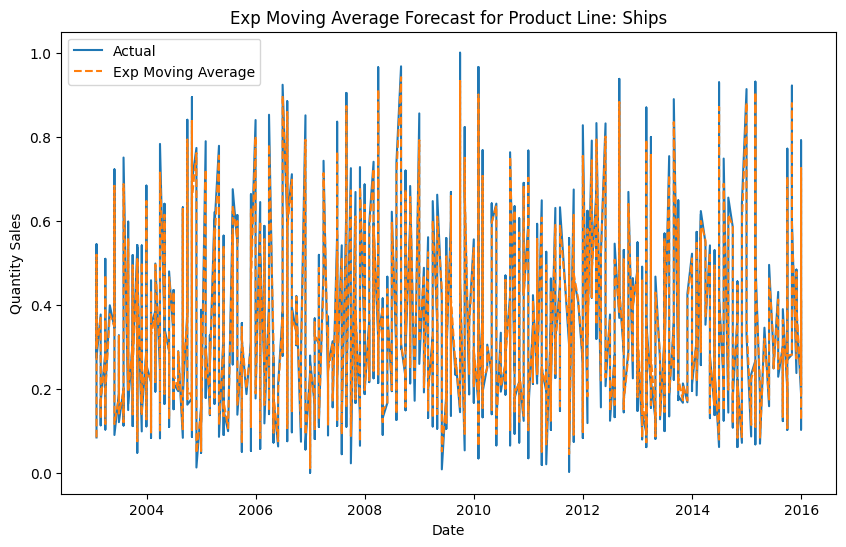

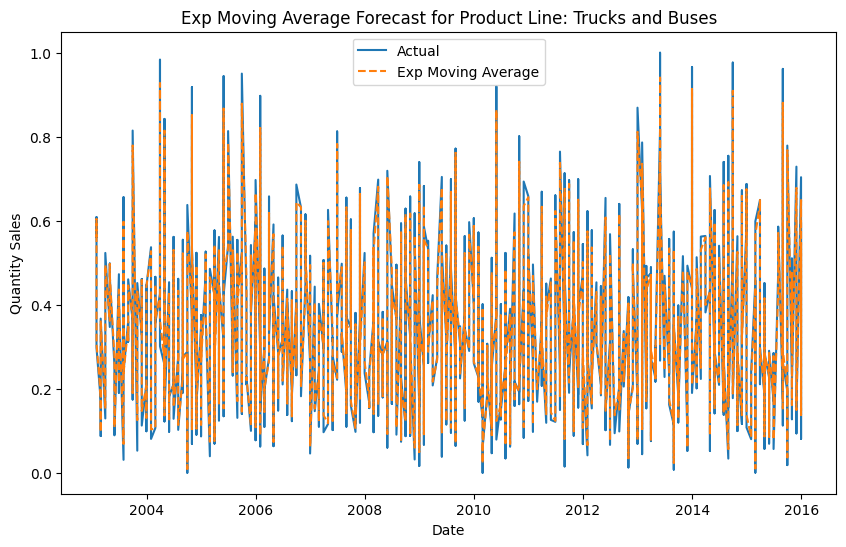

In [ ]:
unique_product_codes = df2['PRODUCTLINE'].unique()
alpha = 0.9  # Smoothing factor
EWMA_result = {}

for product_code in unique_product_codes:
    product_data = df2[df2['PRODUCTLINE'] == product_code].copy()
    product_data = product_data.sort_index()

    # Calculate the Exponential Weighted Moving Average (EWMA)
    product_data['EWMA'] = product_data['SALES'].ewm(alpha=alpha, adjust=False).mean()
    EWMA_result[product_code] = product_data

    plt.figure(figsize=(10, 6))
    plt.plot(product_data.index, product_data['SALES'], label='Actual')
    plt.plot(product_data.index, product_data['EWMA'], label='Exp Moving Average', linestyle='--')  # Use index
    plt.title(f'Exp Moving Average Forecast for Product Line: {product_code}')
    plt.xlabel('Date')
    plt.ylabel('Quantity Sales')

    plt.legend()
    plt.show()


In [ ]:
product_data.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID,EWMA
ORDERDATE,,,,,,,,,,,,
2003-01-31,Salzburg,Austria,Large,0.508772,0.358911,0.561233,0.000000,Trucks and Buses,1,2003,1,0.561233
2003-01-31,Boras,Sweden,Medium,0.526316,0.769802,0.608563,0.736468,Trucks and Buses,1,2003,1,0.603830
2003-01-31,Salzburg,Austria,Small,0.649123,0.309406,0.399487,0.591033,Trucks and Buses,1,2003,1,0.419921
2003-01-31,Osaka,Japan,Medium,0.280702,0.514851,0.391013,0.666484,Trucks and Buses,1,2003,1,0.393904
2003-01-31,San Francisco,USA,Large,0.421053,0.485149,0.297515,0.568070,Trucks and Buses,1,2003,1,0.307154


In [ ]:
df2.isnull().sum()

,0
CITY,0
COUNTRY,0
DEALSIZE,0
QUANTITYORDERED,0
PRICEEACH,0
SALES,0
MSRP,0
PRODUCTLINE,0
MONTH_ID,0
YEAR_ID,0


In [ ]:
df2['SALES'].isnull().sum()

0

In [ ]:
mae_list = []
rmse_list = []
mape_list = []
product_code_list = []

for product_code, product_data in EWMA_result.items():
    product_data = product_data.dropna(subset=['SALES', 'EWMA'])
    actual = product_data['SALES']
    forecast = product_data['EWMA']

    # Calculate MAE
    mae = mean_absolute_error(actual, forecast)
    mae_list.append(mae)

    # Calculate RMSE
    rmse = np.sqrt(mean_squared_error(actual, forecast))
    rmse_list.append(rmse)

    # Calculate MAPE (Mean Absolute Percentage Error)
    mape = np.mean(np.abs((actual - forecast) / (actual+0.000001))) * 100
    mape_list.append(mape)

    # Store the product code
    product_code_list.append(product_code)


evaluation_df = pd.DataFrame({
    'Product Code': product_code_list,
    'MAE': mae_list,
    'RMSE': rmse_list,
    'MAPE (%)': mape_list
})
print(evaluation_df)


       Product Code       MAE      RMSE     MAPE (%)
0            Planes  0.021613  0.027269  3549.169551
1      Vintage Cars  0.020715  0.026527  4303.359469
2       Motorcycles  0.022032  0.027871  4340.753172
3            Trains  0.022126  0.028254  3985.990709
4      Classic Cars  0.021152  0.027199  7050.766978
5             Ships  0.021067  0.026677  1405.561659
6  Trucks and Buses  0.020253  0.025379  2767.025757


<Axes: >

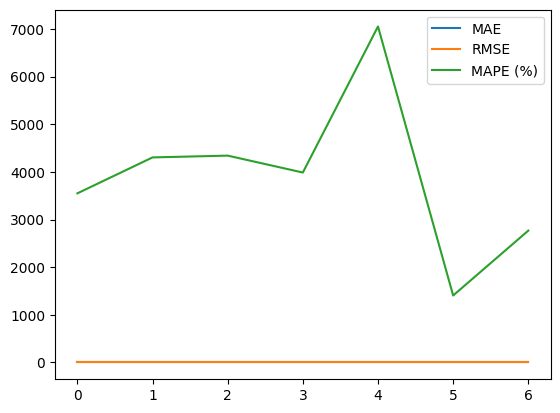

In [ ]:
evaluation_df.plot()

In [ ]:
df2.head(3)

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2003-01-31,Espoo,Finland,Medium,0.844828,0.538462,0.308708,0.039735,Planes,1,2003,1
2003-01-31,Salzburg,Austria,Large,0.534483,0.503722,0.296373,0.512990,Planes,1,2003,1
2003-01-31,Lille,France,Large,0.600000,0.873418,0.313895,0.321839,Vintage Cars,1,2003,1


## ***Autoregressive Integrated Moving Average (ARIMA) model***

***ARIMA MODELLING***

The ARIMA (**Auto Regressive Moving Averag**e) model is a very common time series-forecasting model. It is a more sophisticated extension of the simpler ARMA (Auto Regressive Moving Average) model, which in itself is just a merger of two even simpler components:

1.  **AR (Auto Regressive):** models attempt to predict future values based on
past values. AR models require the time series to be stationary.

2. **MA (Moving Average):** models attempt to predict future values based on past forecasting errors. MA models assume that an autoregressive model can approximate the given series. This is not to be confused with moving average, which is a smoothing process rather than a forecasting model.

***AR MODEL***

We can begin to define an AR model as:

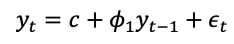

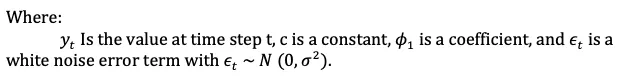

***MA MODEL***

We can begin to define an MA model as:

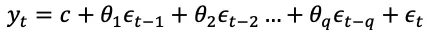

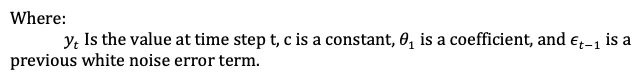

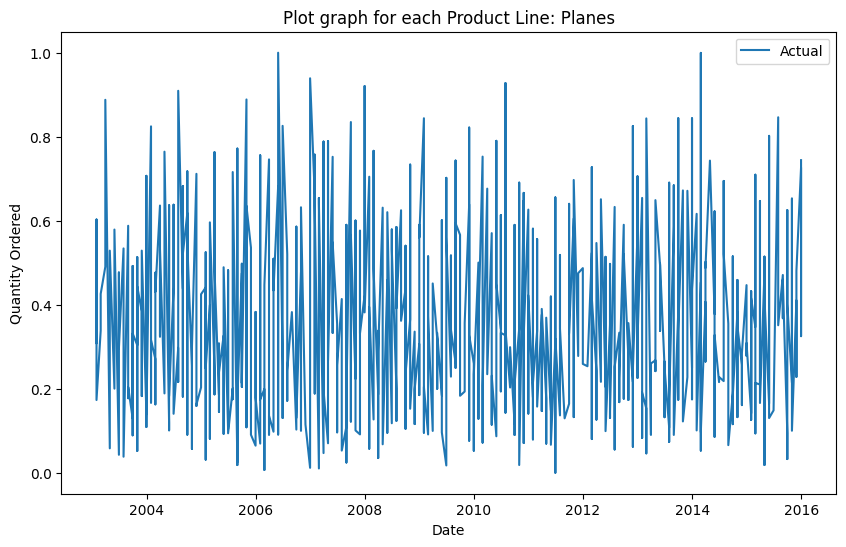

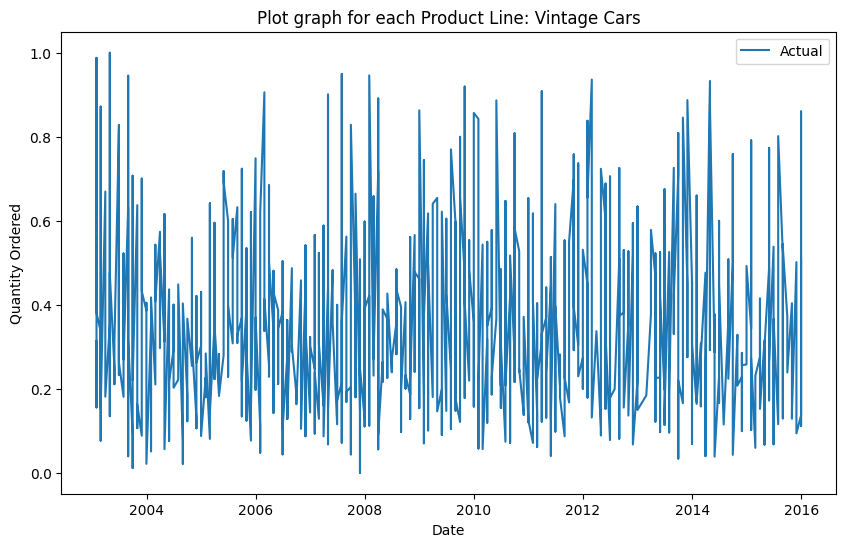

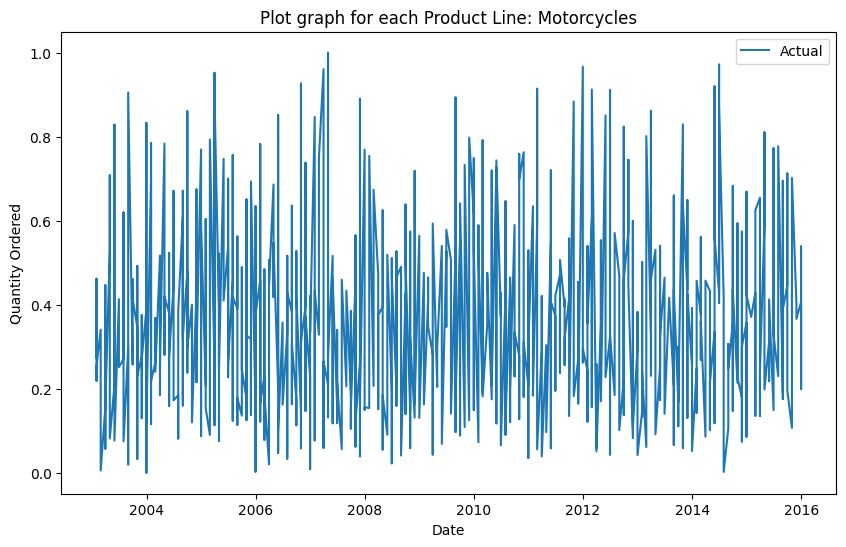

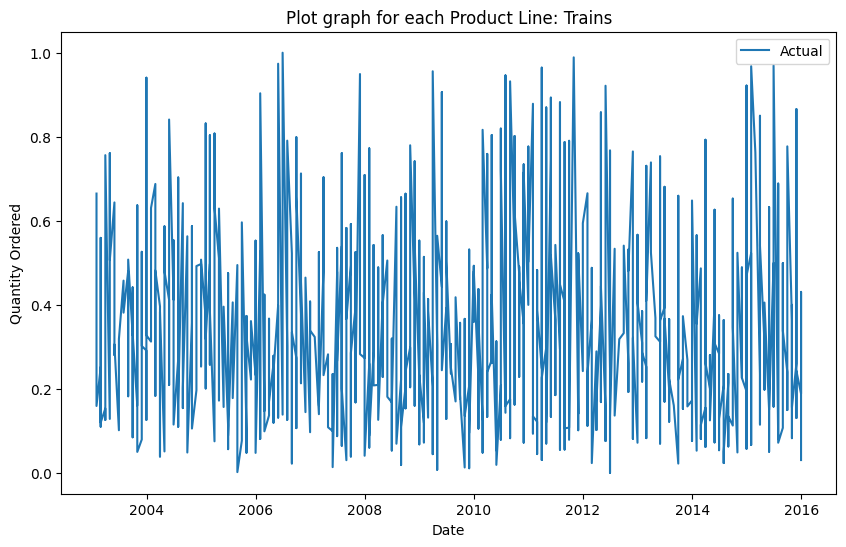

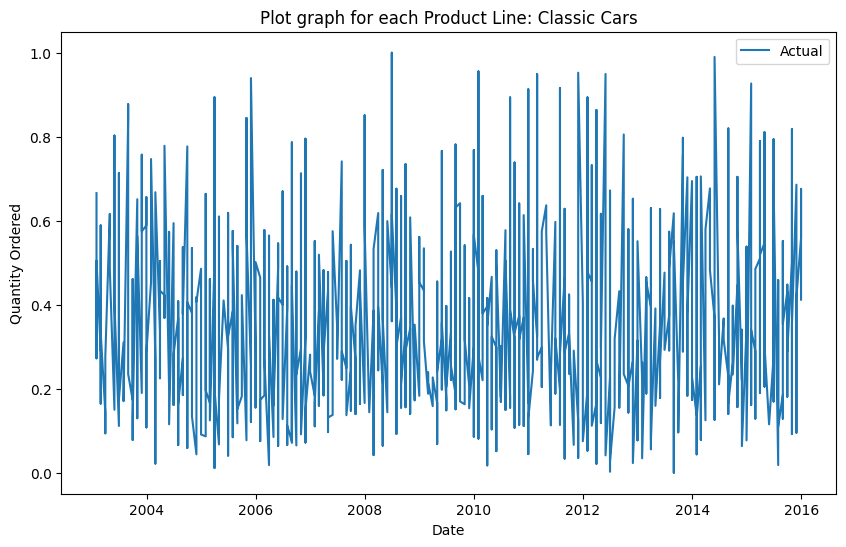

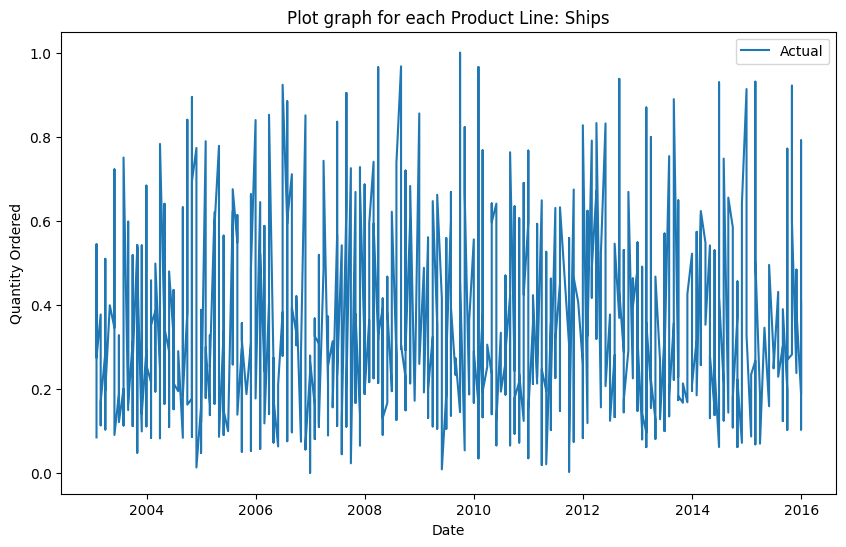

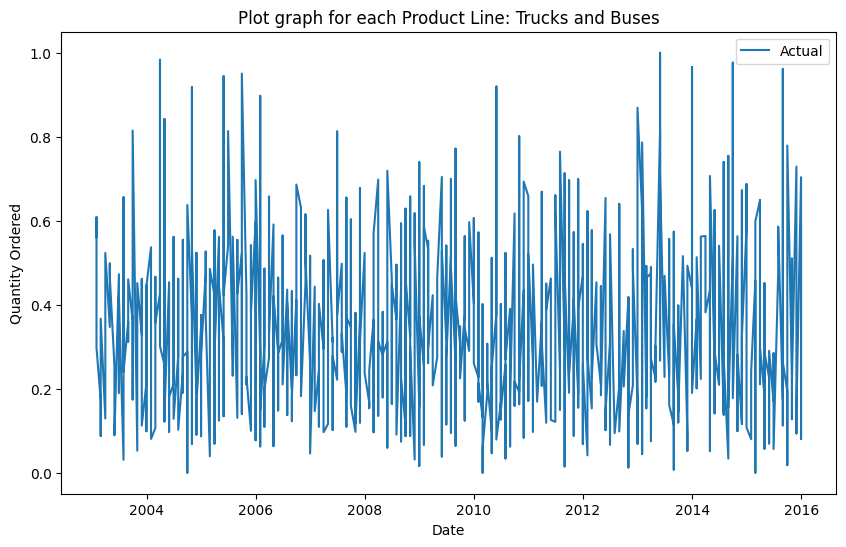

In [ ]:
unique_product_codes = df2['PRODUCTLINE'].unique()

for product_code in unique_product_codes:
    # Filter data for the specific product code
    product_data = df2[df2['PRODUCTLINE'] == product_code].copy()  # Ensure copy to avoid SettingWithCopyWarning
    product_data = product_data.sort_index()  # Sort by the index (ORDERDATE)

    # Plot the data using the index for ORDERDATE
    plt.figure(figsize=(10, 6))
    plt.plot(product_data.index, product_data['SALES'], label='Actual')  # Use index instead of column
    plt.title(f'Plot graph for each Product Line: {product_code}')
    plt.xlabel('Date')
    plt.ylabel('Quantity Ordered')
    plt.legend()
    plt.show()


**Conclusion:-**The data is stationary

Data is  stationary

***Augmented Dickey Fuller(ADF) Test***

Augmented Dickey Fuller(ADF) test is an extension of Dickey Fuller test for more complex models than AR(1). The primary difference between the two tests is that the ADF is utilized for a larger sized set of time series models which can be more complicated.

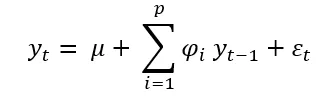

***Assumptions***

The test is conducted under following assumptions:

**Null Hypothesis (H0):** There exists a unit root in the time series and it is non-stationary. Unit root = 1 or δ = 0

**Alternate Hypothesis (H1):** There exists no unit root in the time series and it is stationary. Unit root < 1 or δ < 0


***Condition to reject H0 and accept H1***

If the test statistic is less than the p-value is less than significance

*  level (e.g., 0.05), then the **null hypothesis is rejected** and the time series is **considered stationary**.

*  If the test **statistic is greater** than the critical value, the null hypothesis cannot be rejected, and the **time series is considered non-stationary**.

In [ ]:
#check the data is statinory  or not
from statsmodels.tsa.stattools import adfuller

In [ ]:
#H0 : it is non stationary
#H1 : it is stationary
def adf_test(series):
  result = adfuller(series)
  print('ADF statistics : {}'.format(result[0]))
  print('p- value : {}'.format(result[1]))
  if result[1] <= 0.05:
    print('strong evidence against the null hypothesis, reject the null hypothesis')
  else:
    print('weak evidence against the null hypothesis, time seies has a unit root, indicating it is non-stationary')

In [ ]:
unique_product_codes = df2['PRODUCTLINE'].unique()

for product in unique_product_codes:
    # Filter data for the current product line
    product_data = df2[df2['PRODUCTLINE'] == product]
    print(adf_test(product_data['SALES']))

ADF statistics : -29.67182387308188
p- value : 0.0
strong evidence against the null hypothesis, reject the null hypothesis
None
ADF statistics : -28.817861669019177
p- value : 0.0
strong evidence against the null hypothesis, reject the null hypothesis
None
ADF statistics : -30.673255933851923
p- value : 0.0
strong evidence against the null hypothesis, reject the null hypothesis
None
ADF statistics : -29.456769504570072
p- value : 0.0
strong evidence against the null hypothesis, reject the null hypothesis
None
ADF statistics : -30.47683372838671
p- value : 0.0
strong evidence against the null hypothesis, reject the null hypothesis
None
ADF statistics : -28.126918455349102
p- value : 0.0
strong evidence against the null hypothesis, reject the null hypothesis
None
ADF statistics : -28.162867286207064
p- value : 0.0
strong evidence against the null hypothesis, reject the null hypothesis
None


***Conclusion:-*** A p-value below 0.05 indicates stationarity, and our data meets this criterion, so we do not need to difference it.

***Finding ARIMA Parameters***

The key points to understand here are p, d, and q. Let's delve into their meanings:

* **p:** Autoregressive Order. This is the number of past observations considered for making future predictions. ⌛

* **q:** Moving Average Order. It accounts for a specific number of previous residuals when making future predictions. 📊

* **d:** Integration Order. It determines the number of differences needed to make the time series stationary (T(q) — T(q-1)).

We use the **Autocorrelation Function (ACF)** and **Partial Autocorrelation Function (PACF)** plots to find the ARIMA parameters.

In [ ]:
!pip install pmdarima
import warnings
warnings.filterwarnings('ignore')

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 20.1 MB/s eta 0:00:00


In [ ]:
from pmdarima import auto_arima

In [ ]:
from statsmodels.tsa.arima.model import ARIMA

unique_product_codes = df2['PRODUCTLINE'].unique()

for product in unique_product_codes:
    product_data = df2[df2['PRODUCTLINE'] == product]
    # Define and fit the ARIMA model (adjust p, d, q as needed)
    stepwise_model = auto_arima(product_data['SALES'], trace= True, suppress_warnings=True)
    # model_fit = model.fit()

    print(f'ARIMA model summary for Product Line: {product}')
    print(stepwise_model.summary())
    print('\n')
    print('next Product line summary')

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=-312.073, Time=3.57 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=-318.374, Time=0.25 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=-317.071, Time=0.11 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=-317.111, Time=1.04 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=821.477, Time=0.13 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-315.967, Time=9.25 sec

Best model:  ARIMA(0,0,0)(0,0,0)[0] intercept
Total fit time: 14.388 seconds
ARIMA model summary for Product Line: Planes
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  838
Model:                        SARIMAX   Log Likelihood                 161.187
Date:                Sat, 30 Nov 2024   AIC                           -318.374
Time:                        06:38:48   BIC                           -308.912
Sample:                             0   HQIC

***Explanation of the terms used in the ARIMA/SARIMAX summary output:***

**Dep. Variable:**

The dependent variable is denoted as y. It refers to the variable being predicted (in this case, QUANTITYORDERED).


**Model:**

This refers to the type of model used. Here it’s SARIMAX, though no seasonal or exogenous components are specified here.

**Log Likelihood:**

A measure of model fit. Higher log-likelihood values (closer to zero or positive) suggest a better model fit, but this value alone cannot be used for model comparison across different datasets or models.

**AIC (Akaike Information Criterion):**

A metric used to compare different models. Lower AIC values indicate better models.

**BIC (Bayesian Information Criterion):**

Similar to AIC, but penalizes models with more parameters. Lower values indicate better models.

**HQIC(Hannan-Quinn Information Criterion):**

Another metric for model selection, like AIC and BIC. Again, lower values are better.

***Additional Statistics:***

**sigma2:**

The variance of the residuals (errors).

**Ljung-Box (L1) (Q):**

A test statistic for checking if the residuals are autocorrelated (i.e., whether there is any pattern left in the residuals). A p-value (Prob(Q)) above 0.05 suggests no significant autocorrelation in residuals, which is good.

**Jarque-Bera (JB):**

A test for checking whether the residuals are normally distributed. The p-value (Prob(JB)) here is 0.01, which suggests the residuals might deviate from a normal distribution.

**Heteroskedasticity (H):**

A test to check if the residuals have constant variance (homoscedasticity). A p-value (Prob(H)) above 0.05 suggests no significant heteroskedasticity, indicating the residuals likely have constant variance.

**Skew:**

A measure of the asymmetry of the residuals. A skew of 0.20 indicates slight positive skewness (right-tailed distribution).

**Kurtosis:**

A measure of the "tailedness" of the residual distribution. A kurtosis of 2.31 indicates slightly less peakedness compared to a normal distribution (which has a kurtosis of 3).

No need of acf and pacf becuse i already fornd the parameter value using auto_arima model summay

In [ ]:
#check the data points in the each product line
for product in unique_product_codes:
    product_data = df2[df2['PRODUCTLINE'] == product]['SALES']
    print(f'Product Line: {product}, Data Points: {len(product_data)}')

Product Line: Planes, Data Points: 838
Product Line: Vintage Cars, Data Points: 851
Product Line: Motorcycles, Data Points: 870
Product Line: Trains, Data Points: 875
Product Line: Classic Cars, Data Points: 860
Product Line: Ships, Data Points: 850
Product Line: Trucks and Buses, Data Points: 840


In [ ]:
from pmdarima import auto_arima
from statsmodels.tsa.arima.model import ARIMA

In [ ]:
unique_product_codes = df2['PRODUCTLINE'].unique()
arima_result = {}

for product in unique_product_codes:
    product_data = df2[df2['PRODUCTLINE'] == product]
    quantity_ordered = product_data['SALES'].reset_index(drop=True)
    # Train-test split (80% train, 20% test)
    train_size = int(len(quantity_ordered) * 0.8)
    train, test = quantity_ordered[0:train_size], quantity_ordered[train_size:]

    print(f"Product: {product} - Train size: {len(train)}, Test size: {len(test)}")

    # Use auto_arima to find the best model
    stepwise_fit = auto_arima(train, trace=True, suppress_warnings=True, seasonal=False)
    best_order = stepwise_fit.order  # Extract the best (p, d, q) order

    # Fit the ARIMA model with the best order
    model = ARIMA(train, order=best_order)
    model_fit = model.fit()

    # Predicting on the test set
    start = len(train)
    end = len(train) + len(test) - 1
    pred = model_fit.predict(start=start, end=end, typ='levels')
    pred.index=df2.index[start:end+1]   #prediction with date index
    # Store the results in a dictionary
    arima_result[product] = {
        'model_fit': model_fit,  # Store the fitted model
        'forecast': pred.reset_index(drop=True),  # Reset index for alignment with test
        'actual': test.reset_index(drop=True)  # Reset index for alignment
    }


# print(arima_result[product]['forecast'])
# print(arima_result[product]['actual'])

Product: Planes - Train size: 670, Test size: 168
Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=inf, Time=3.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=655.730, Time=0.15 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=138.001, Time=0.16 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=395.513, Time=0.36 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=14.011, Time=0.41 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-51.960, Time=1.30 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-90.139, Time=1.57 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-125.128, Time=0.62 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=inf, Time=6.22 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=inf, Time=7.85 sec
 ARIMA(5,0,0)(0,0,0)[0] intercept   : AIC=-241.687, Time=4.05 sec
 ARIMA(4,0,0)(0,0,0)[0] intercept   : AIC=-242.806, Time=1.36 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=-244.722, Time=1.62 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=-246.537, Time=1.49 sec
 ARIM

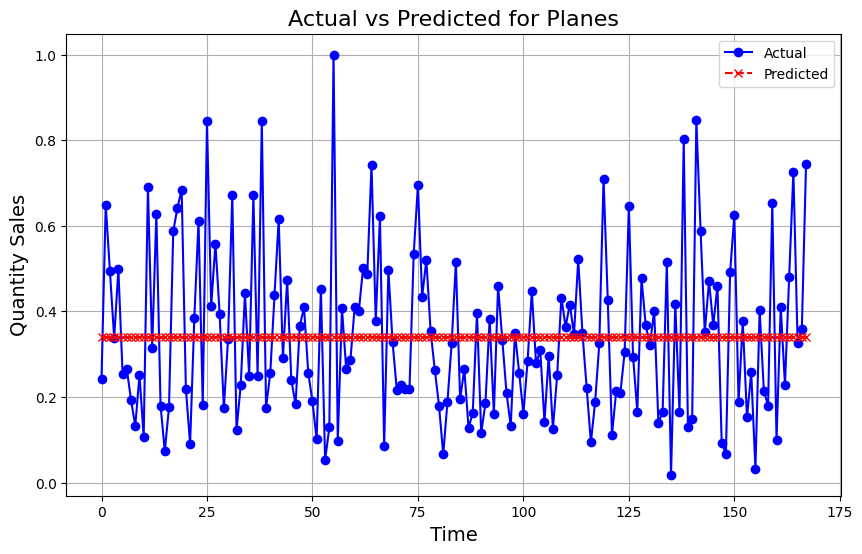

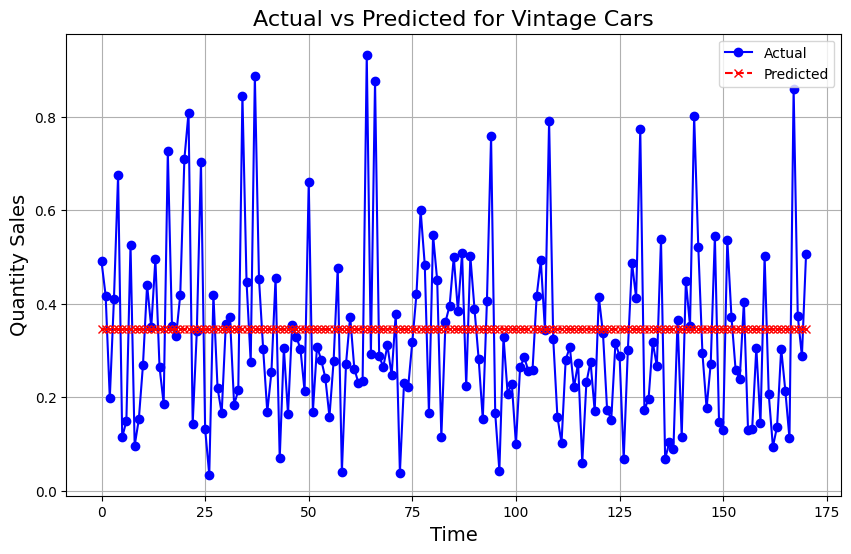

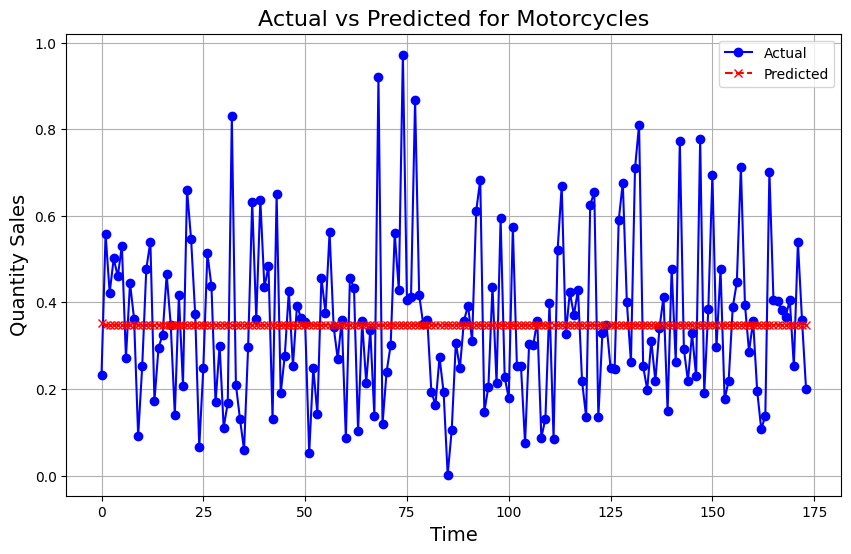

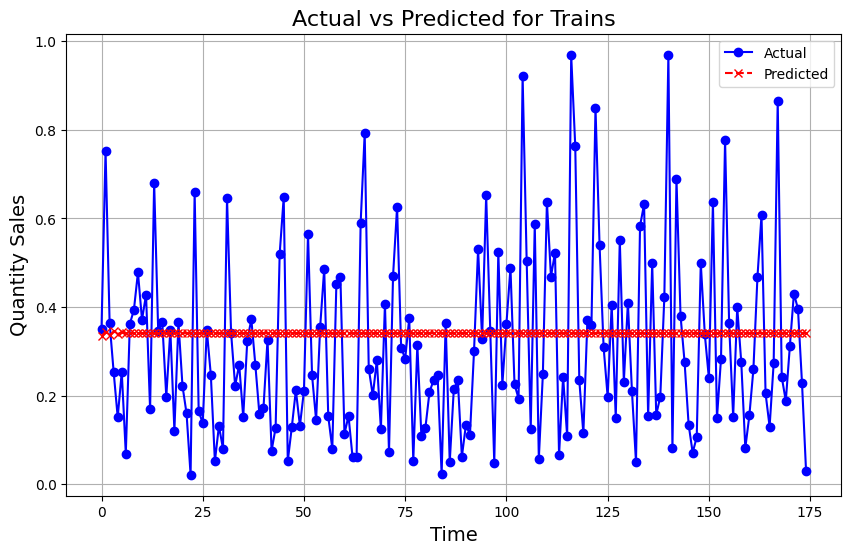

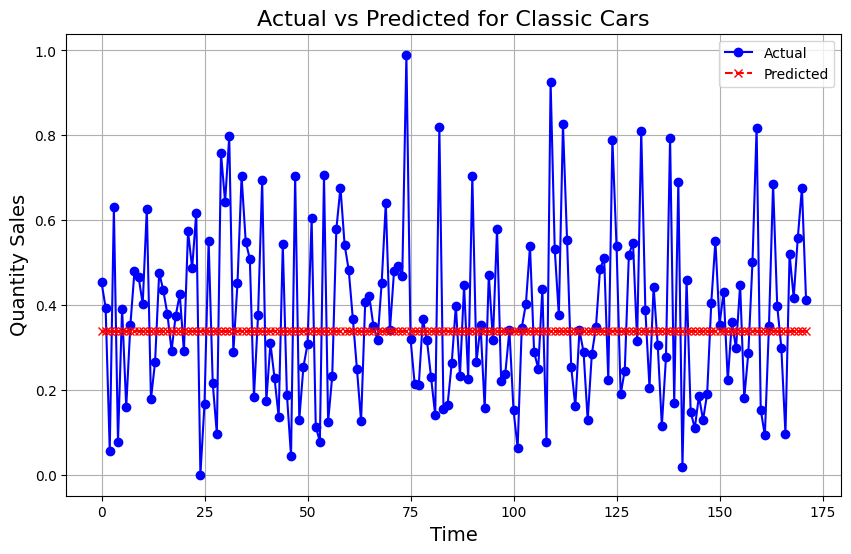

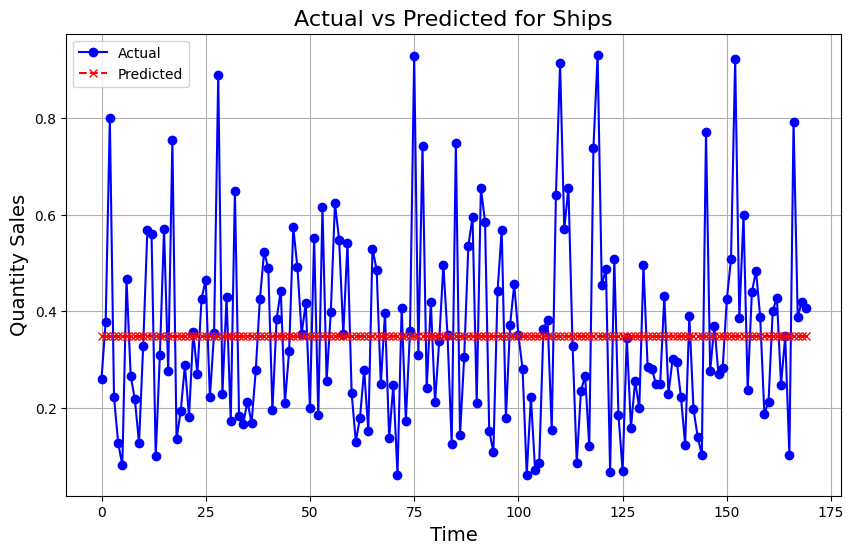

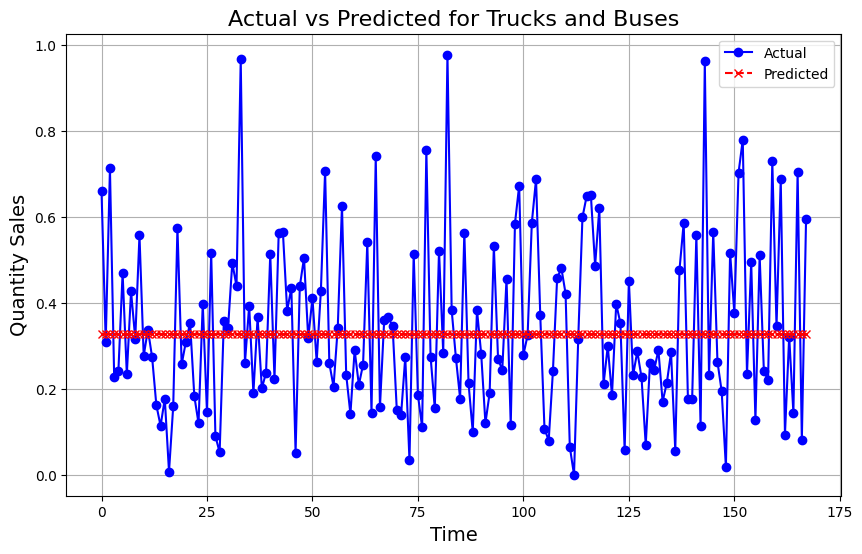

In [ ]:
def plot_actual_vs_predicted(product, actual, predicted):
    plt.figure(figsize=(10, 6))
    plt.plot(actual, label='Actual', color='blue', marker='o')
    plt.plot(predicted, label='Predicted', color='red', linestyle='--', marker='x')
    plt.title(f'Actual vs Predicted for {product}', fontsize=16)
    plt.xlabel('Time', fontsize=14)
    plt.ylabel('Quantity Sales', fontsize=14)
    plt.legend()
    plt.grid(True)
    plt.show()

# Plot for each product line
for product, result in arima_result.items():
    actual = result['actual']
    predicted = result['forecast']

    # Call the plotting function
    plot_actual_vs_predicted(product, actual, predicted)


In [ ]:
def calculate_metrics(actual, predicted):
    actual = np.array(actual)
    predicted = np.array(predicted)

    # Calculate MAE
    mae = np.mean(np.abs(actual - predicted))

    # Calculate RMSE
    rmse = np.sqrt(np.mean((actual - predicted) ** 2))

    # Calculate MAPE
    mape = np.mean(np.abs((actual - predicted) / (actual+0.000001))) * 100

    return mae, rmse, mape


evaluation_results = {}
for product, result in arima_result.items():
    actual = result['actual']
    predicted = result['forecast']
    mae, rmse, mape = calculate_metrics(actual, predicted)
    evaluation_results[product] = {
        'MAE': mae,
        'RMSE': rmse,
        'MAPE': mape
    }

In [ ]:
evaluation_data = []

# Populate the list with product codes and their corresponding metrics
for product, metrics in evaluation_results.items():
    evaluation_data.append({
        'Product Code': product,
        'MAE': metrics['MAE'],
        'RMSE': metrics['RMSE'],
        'MAPE (%)': metrics['MAPE']
    })

evaluation_df = pd.DataFrame(evaluation_data)
print(evaluation_df)


       Product Code       MAE      RMSE       MAPE (%)
0            Planes  0.159006  0.196788      83.852559
1      Vintage Cars  0.150038  0.192331      82.909153
2       Motorcycles  0.147108  0.189194     164.788397
3            Trains  0.172057  0.210970     122.236423
4      Classic Cars  0.165320  0.207011  197073.287980
5             Ships  0.157784  0.198333      68.164880
6  Trucks and Buses  0.164445  0.204911     682.197583


<Axes: >

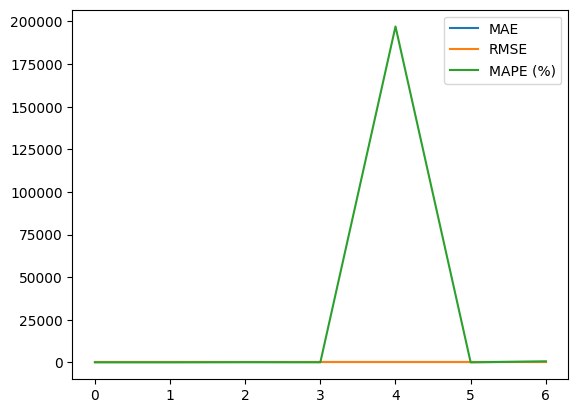

In [ ]:
evaluation_df.plot()

In [ ]:
df2.head(3)

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2003-01-31,Espoo,Finland,Medium,0.844828,0.538462,0.308708,0.039735,Planes,1,2003,1
2003-01-31,Salzburg,Austria,Large,0.534483,0.503722,0.296373,0.512990,Planes,1,2003,1
2003-01-31,Lille,France,Large,0.600000,0.873418,0.313895,0.321839,Vintage Cars,1,2003,1


Make the prediction

## ***Time Series With LSTM***

**What is an LSTM?**

Long Short-Term Memory (LSTM) is a deep learning, sequential neural network that allows information to persist. It is a special type of Recurrent Neural Network which is capable of learning order dependence in sequence prediction problems.

**Why LSTM for Time Series Forecasting?**

LSTM is a type of Recurrent Neural Network in which the neurons are capable of learning the patterns in a sequential data and predict the next item in the sequence.

In [ ]:
#normalize the data
from sklearn.preprocessing import MinMaxScaler
scaler= MinMaxScaler()

In [ ]:
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error

In [ ]:
df4 = df2[['PRODUCTLINE', 'SALES']]

In [ ]:
df4.head()

,PRODUCTLINE,SALES
ORDERDATE,,
2003-01-31,Planes,0.308708
2003-01-31,Planes,0.296373
2003-01-31,Vintage Cars,0.313895
2003-01-31,Motorcycles,0.274066
2003-01-31,Trains,0.664652


In [ ]:
df4.shape

(5984, 2)

In [ ]:
#check the data points in the each product line
for product in unique_product_codes:
    product_data = df2[df2['PRODUCTLINE'] == product]['SALES']
    print(f'Product Line: {product}, Data Points: {len(product_data)}')

Product Line: Planes, Data Points: 838
Product Line: Vintage Cars, Data Points: 851
Product Line: Motorcycles, Data Points: 870
Product Line: Trains, Data Points: 875
Product Line: Classic Cars, Data Points: 860
Product Line: Ships, Data Points: 850
Product Line: Trucks and Buses, Data Points: 840


Sequence Length: In time series forecasting, the sequence length determines how many previous time steps the model uses to predict the next time step. For instance, if sequence_length is 5, the model uses the last 5 values to predict the next one.

**sequence_length_mapping** is a dictionary used in your LSTM implementation to define the sequence length (number of time steps) for each PRODUCTLINE. The sequence length determines how many previous data points are used to predict the next value in a time series.

For example:

If the sequence length for Motorcycles is 10, the LSTM will use the last 10 data points of the SALES column to predict the next value in the sequence.


In [ ]:
###this code is important
unique_product_codes = df4['PRODUCTLINE'].unique()
lstm_result = {}

# Normalize the data
scaler = MinMaxScaler()
df4['SALES'] = scaler.fit_transform(df4['SALES'].values.reshape(-1, 1))
# Function to create sequences
def create_sequences(data, sequence_length):
    X, y = [], []
    for i in range(len(data) - sequence_length):
        X.append(data[i:i+sequence_length])
        y.append(data[i+sequence_length])
    return np.array(X), np.array(y)

# Adjusted sequence length based on data points available
sequence_length_mapping = {
    'Motorcycles': 8,
    'Classic Cars': 10,
    'Trucks and Buses': 10,
    'Vintage Cars': 10,
    'Planes': 10,
    'Ships': 10,
    'Trains': 8
}

# Update the LSTM loop to store both actual and predicted values
for product in unique_product_codes:
    product_data = df4[df4['PRODUCTLINE'] == product]
    print(product_data.head())
    quantity_ordered = product_data['SALES']
    sequence_length = sequence_length_mapping.get(product, 10)  # Default to 10 if not in mapping
    print(f'product steplenth: {sequence_length}')
    # Train-test split (80% train, 20% test)
    train_size = int(len(quantity_ordered) * 0.8)
    train_data, test_data = quantity_ordered[:train_size], quantity_ordered[train_size:]

    # Create sequences
    X_train, y_train = create_sequences(train_data, sequence_length)
    X_test, y_test = create_sequences(test_data, sequence_length)

    # Reshape for LSTM
    X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
    X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))

    # Build the LSTM model
    model = Sequential()
    model.add(LSTM(units=64, input_shape=(sequence_length, 1)))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    # Train the model
    model.fit(X_train, y_train, epochs=20, batch_size=32, verbose=1)

    # Predict on the test set
    predictions = model.predict(X_test)

    # Store both actual and predicted values
    lstm_result[product] = {
        'actual': y_test,  # Actual values from test data
        'predicted': predictions.flatten()  # Predicted values, flattened for consistency
    }

           PRODUCTLINE     SALES
ORDERDATE                       
2003-01-31      Planes  0.308708
2003-01-31      Planes  0.296373
2003-01-31      Planes  0.209473
2003-01-31      Planes  0.271883
2003-01-31      Planes  0.602871
product steplenth: 10
Epoch 1/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step - loss: 0.0913
Epoch 2/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0423
Epoch 3/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0423
Epoch 4/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0406
Epoch 5/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0425
Epoch 6/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0430
Epoch 7/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0415
Epoch 8/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0409
Epoch 9/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0417
Epoch 10/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0418
Epoch 11/20
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0396
Epoch 12/20
21/21 ━━━━━━━━

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
           PRODUCTLINE     SALES
ORDERDATE                       
2003-01-31      Trains  0.664652
2003-01-31      Trains  0.374911
2003-01-31      Trains  0.284600
2003-01-31      Trains  0.645220
2003-01-31      Trains  0.258136
product steplenth: 8
Epoch 1/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 5ms/step - loss: 0.0930
Epoch 2/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0475
Epoch 3/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0423
Epoch 4/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0456
Epoch 5/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0435
Epoch 6/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0452
Epoch 7/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0424
Epoch 8/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0456
Epoch 9/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0452
Epoch 10/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0484
Epoch 11/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
             PRODUCTLINE     SALES
ORDERDATE                         
2003-01-31  Classic Cars  0.665670
2003-01-31  Classic Cars  0.272394
2003-01-31  Classic Cars  0.504856
2003-02-28  Classic Cars  0.291025
2003-02-28  Classic Cars  0.588969
product steplenth: 10
Epoch 1/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - loss: 0.1146
Epoch 2/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0441
Epoch 3/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0419
Epoch 4/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0426
Epoch 5/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0411
Epoch 6/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0381
Epoch 7/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - loss: 0.0385
Epoch 8/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0368
Epoch 9/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0399
Epoch 10/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - loss: 0.0404
Epoch 11/20
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 

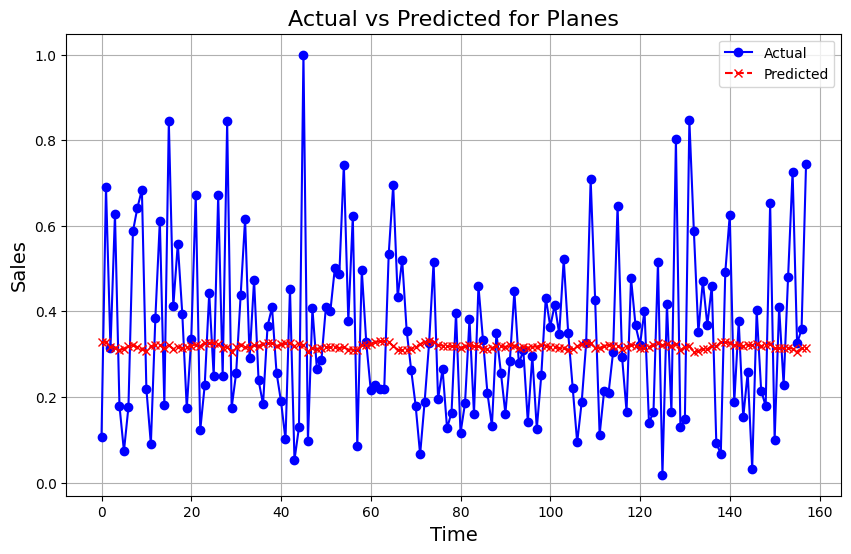

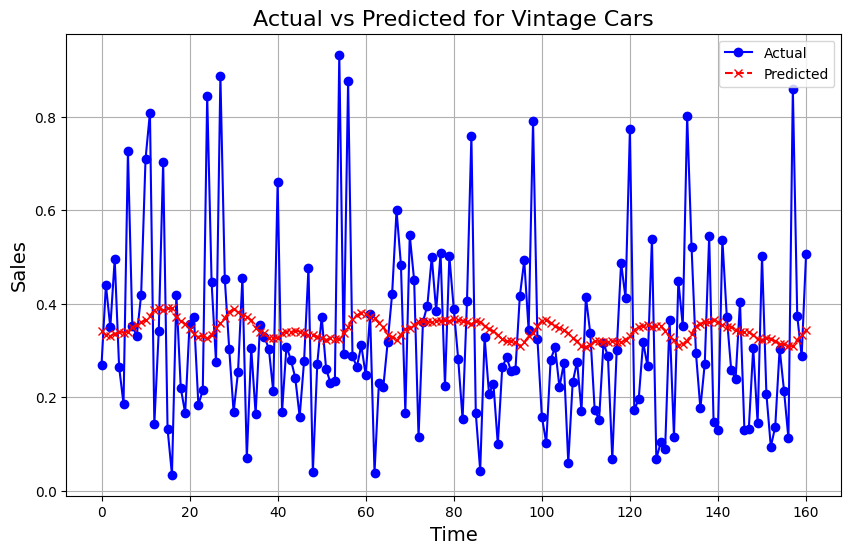

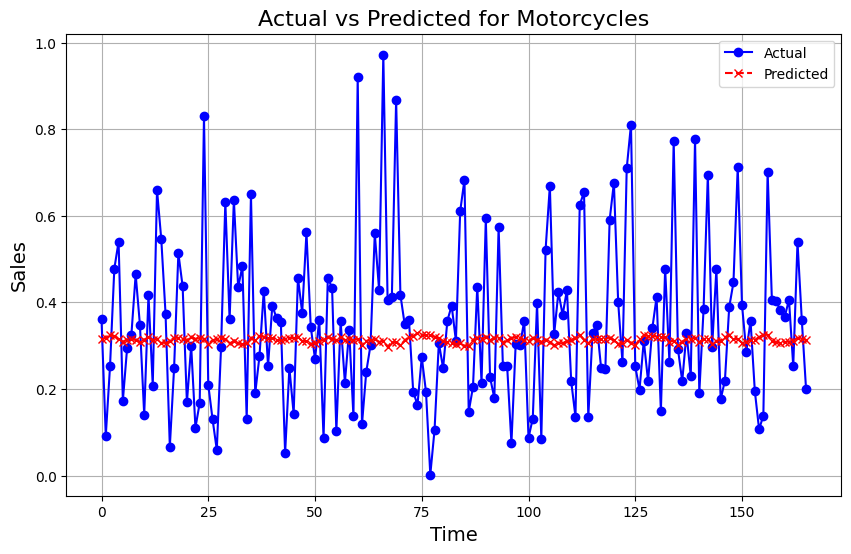

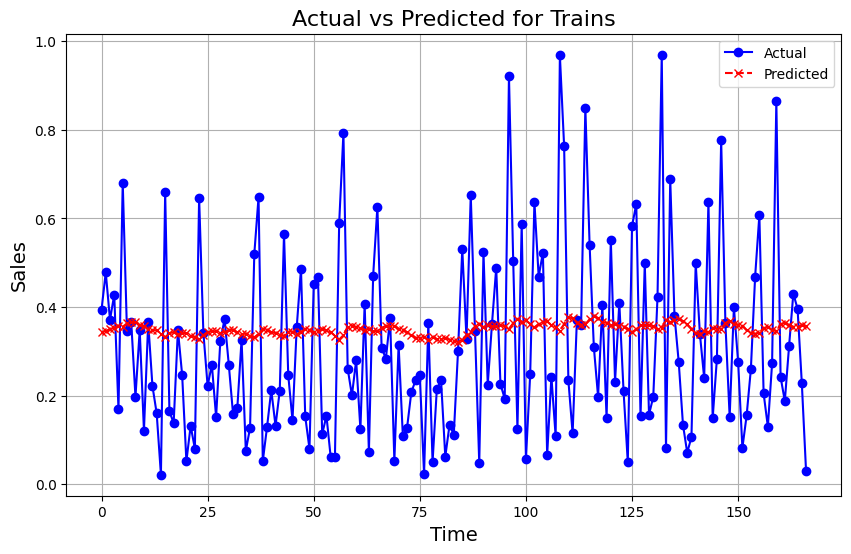

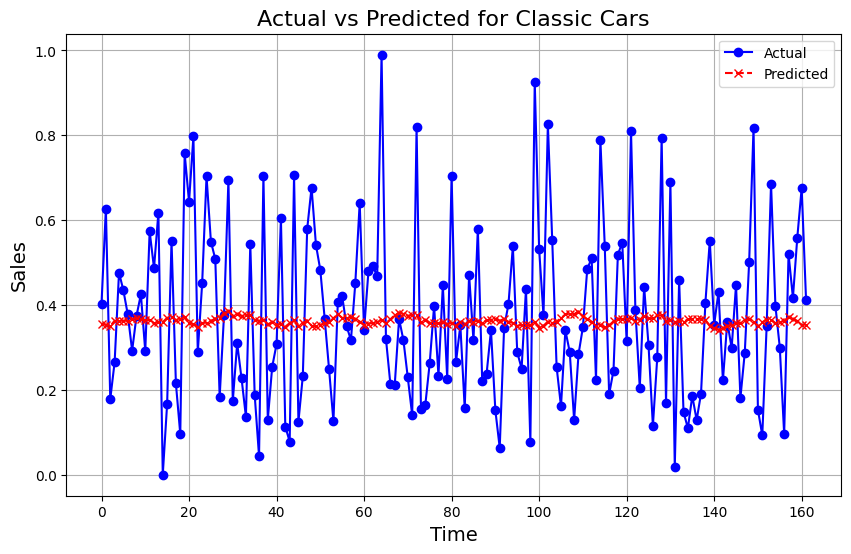

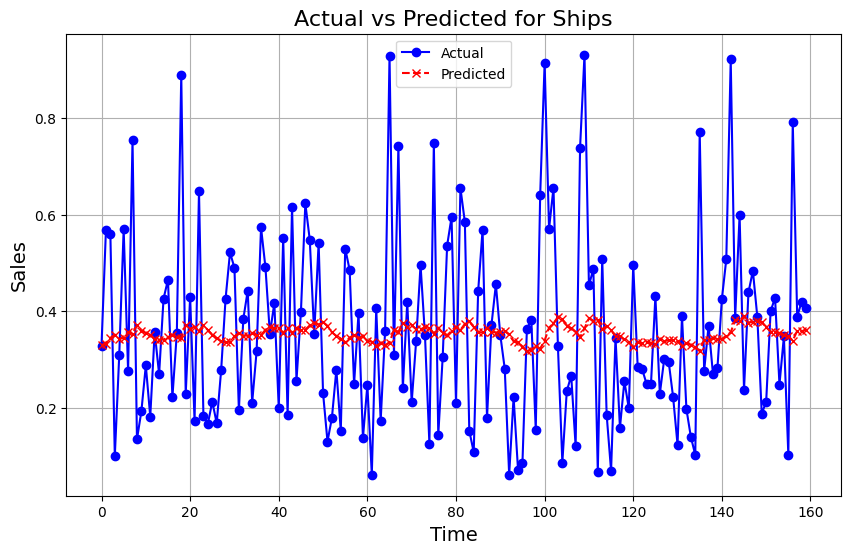

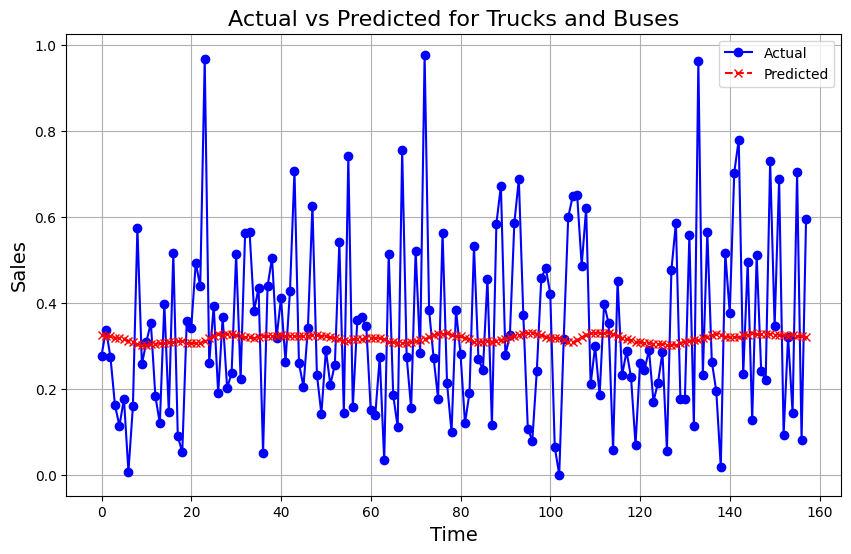

In [ ]:
# Function to plot actual and predicted values
def plot_actual_vs_predicted(product, actual, predicted):
    plt.figure(figsize=(10, 6))
    plt.plot(actual, label='Actual', color='blue', marker='o')
    plt.plot(predicted, label='Predicted', color='red', linestyle='--', marker='x')
    plt.title(f'Actual vs Predicted for {product}', fontsize=16)
    plt.xlabel('Time', fontsize=14)
    plt.ylabel('Sales', fontsize=14)  # Changed to 'Sales' since we are plotting sales
    plt.legend()
    plt.grid(True)
    plt.show()

# Plot for each product line
for product, result in lstm_result.items():
    actual = result['actual']
    predicted = result['predicted']

    # Call the plotting function
    plot_actual_vs_predicted(product, actual, predicted)


In [ ]:
import numpy as np

# Function to calculate evaluation metrics
def calculate_metrics(actual, predicted):
    actual = np.array(actual)
    predicted = np.array(predicted)

    # Calculate MAE
    mae = np.mean(np.abs(actual - predicted))

    # Calculate RMSE
    rmse = np.sqrt(np.mean((actual - predicted) ** 2))

    # Calculate MAPE
    mape = np.mean(np.abs((actual - predicted) / (actual+0.00000001))) * 100

    return mae, rmse, mape


evaluation_results = {}
for product, result in lstm_result.items():
    actual = result['actual']
    predicted = result['predicted']
    mae, rmse, mape = calculate_metrics(actual, predicted)
    evaluation_results[product] = {
        'MAE': mae,
        'RMSE': rmse,
        'MAPE': mape
    }

In [ ]:
evaluation_data = []
for product, metrics in evaluation_results.items():
    evaluation_data.append({
        'Product Code': product,
        'MAE': metrics['MAE'],
        'RMSE': metrics['RMSE'],
        'MAPE (%)': metrics['MAPE']
    })


evaluation_df = pd.DataFrame(evaluation_data)
print(evaluation_df)

       Product Code       MAE      RMSE      MAPE (%)
0            Planes  0.159988  0.200578  8.070359e+01
1      Vintage Cars  0.149191  0.194481  8.339269e+01
2       Motorcycles  0.149544  0.195810  1.576470e+02
3            Trains  0.175966  0.213964  1.273799e+02
4      Classic Cars  0.166982  0.205834  2.219734e+07
5             Ships  0.157890  0.198923  6.778921e+01
6  Trucks and Buses  0.164575  0.207034  7.042012e+02


***Interpret the Metrics:***

**MAE:** Measures the average magnitude of errors in predictions. Lower MAE values indicate that the model's predictions are closer to actual values on average.

**RMSE:** Similar to MAE but penalizes larger errors more heavily. Lower RMSE values show that the model is performing well and is less sensitive to large errors.

**MAPE:** Measures the percentage error between predictions and actual values. A lower MAPE indicates better performance, but it can be inflated if actual values are close to zero. Generally, a **MAPE below 10% is considered excellent, 10-20% is good, 20-50% is reasonable, and over 50% may indicate that the model is struggling.**

In [ ]:
# # Define thresholds for deciding, the model is good enough
# mae_threshold = 0.15
# rmse_threshold = 0.1
# mape_threshold = 300

# def is_method_best(mae, rmse, mape):

#     return mae < mae_threshold and rmse < rmse_threshold and mape < mape_threshold


# best_method_results = []
# for product, metrics in evaluation_results.items():
#     mae = metrics['MAE']
#     rmse = metrics['RMSE']
#     mape = metrics['MAPE']
#     is_best = is_method_best(mae, rmse, mape)
#     best_method_results.append({
#         'Product Code': product,
#         'MAE': mae,
#         'RMSE': rmse,
#         'MAPE (%)': mape,
#         'Is LSTM Best?': 'Yes' if is_best else 'No'
#     })

# best_method_df = pd.DataFrame(best_method_results)
# print(best_method_df)

<Axes: >

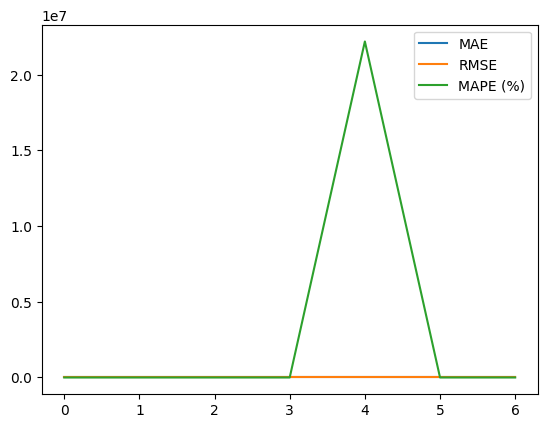

In [ ]:
evaluation_df.plot()

In [ ]:
df2.head(3)

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2003-01-31,Espoo,Finland,Medium,0.844828,0.538462,0.308708,0.039735,Planes,1,2003,1
2003-01-31,Salzburg,Austria,Large,0.534483,0.503722,0.296373,0.512990,Planes,1,2003,1
2003-01-31,Lille,France,Large,0.600000,0.873418,0.313895,0.321839,Vintage Cars,1,2003,1


## **Linear Regression**

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

In [ ]:
# Sort df2 by ORDERDATE
df2=scale_df.copy()

In [ ]:
df2.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,ORDERDATE,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
0,Reggio Emilia,Italy,Small,0.037037,0.2525,0.764933,0.364547,2012-11-30,Trains,11,2012,4
1,San Francisco,USA,Large,0.666667,0.1450,0.013328,0.687031,2007-05-31,Trains,5,2007,2
2,Glendale,USA,Medium,0.907407,0.4800,0.437061,0.610916,2010-01-31,Trains,1,2010,1
3,Marseille,France,Small,0.537037,0.4825,0.763078,0.695043,2015-02-28,Trains,2,2015,1
4,White Plains,USA,Small,0.407407,0.0050,0.183789,0.038558,2008-11-30,Trains,11,2008,4


In [ ]:
df2 = df2.sort_values(by='ORDERDATE')
# Set ORDERDATE as the index
df2.set_index('ORDERDATE', inplace=True)

In [ ]:
df2.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2003-01-31,Espoo,Finland,Medium,0.844828,0.538462,0.308708,0.039735,Planes,1,2003,1
2003-01-31,Salzburg,Austria,Large,0.534483,0.503722,0.296373,0.512990,Planes,1,2003,1
2003-01-31,Lille,France,Large,0.600000,0.873418,0.313895,0.321839,Vintage Cars,1,2003,1
2003-01-31,Bergen,Norway,Large,0.354839,0.420398,0.274066,0.268293,Motorcycles,1,2003,1
2003-01-31,Helsinki,Finland,Small,0.648148,0.647500,0.664652,0.691037,Trains,1,2003,1


In [ ]:
####   Here i remove the city, country and dealsize

linear_regression_results = {}
# df2 = df2.reset_index(drop=True)

unique_product_codes = df2['PRODUCTLINE'].unique()
for product in unique_product_codes:
    product_data = df2[df2['PRODUCTLINE'] == product]

    # Select features to be one-hot encoded
    categorical_features = ['MONTH_ID']

    # Perform one-hot encoding on categorical columns
    product_data_encoded = pd.get_dummies(product_data, columns=categorical_features, drop_first=True)

    # Prepare features (X) and target (y)
    X = product_data_encoded.drop(columns=['SALES', 'PRODUCTLINE', 'QTR_ID', 'YEAR_ID', 'CITY', 'COUNTRY', 'DEALSIZE'])
    y = product_data_encoded['SALES']

    # Train-test split (70% train, 30% test)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Keep ORDERDATE aligned with y_test by indexing directly from the test set
    order_dates_test = X_test.index  # ORDERDATE is retained as the index

    # Initialize and train the linear regression model
    model = LinearRegression()
    model.fit(X_train, y_train)

    # Predict on test set
    y_pred = model.predict(X_test)

    # Evaluate the model
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    # Store the model and results, retaining ORDERDATE as index
    linear_regression_results[product] = {
        'model': model,
        'mse': mse,
        'r2_score': r2,
        'actual': y_test.values,
        'predicted': y_pred,
        'ORDERDATE': order_dates_test
    }
    # # Output results for each product line
    # print(f"Product Line: {product}")
    # print(f"Mean Squared Error: {mse:.2f}")
    # print(f"R² Score: {r2:.2f}\n")

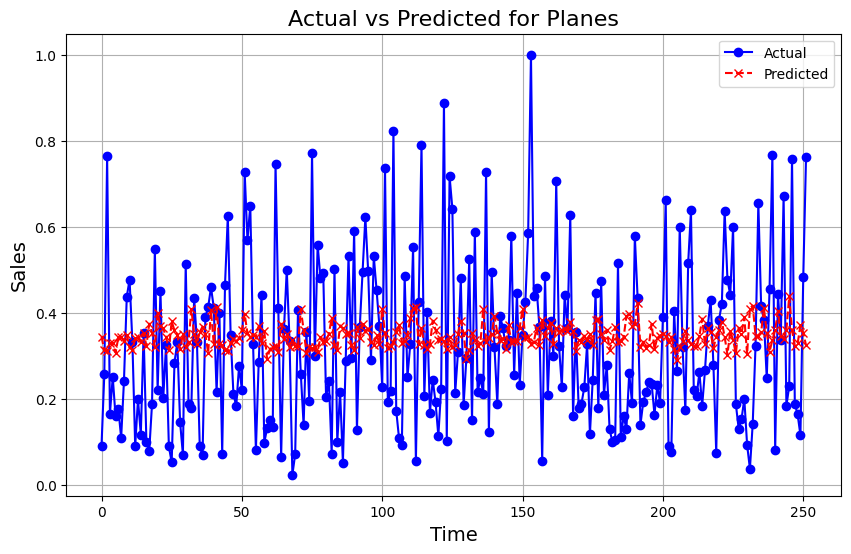

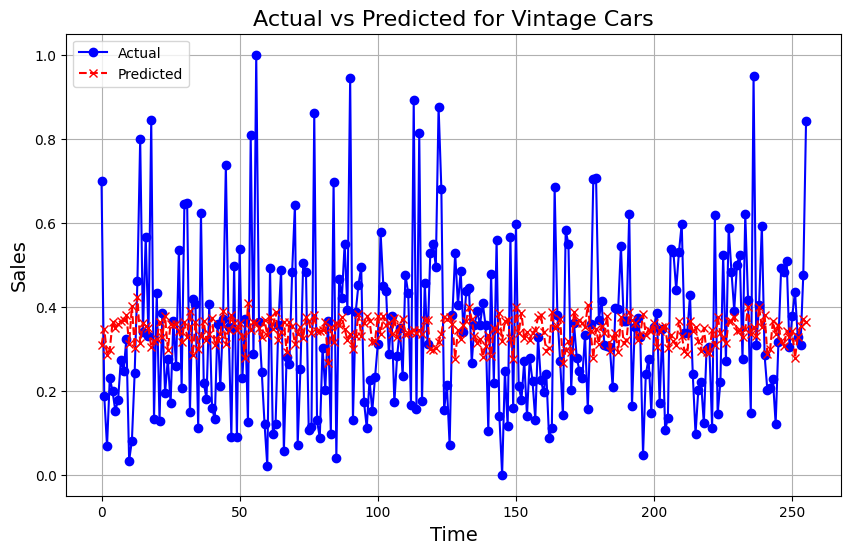

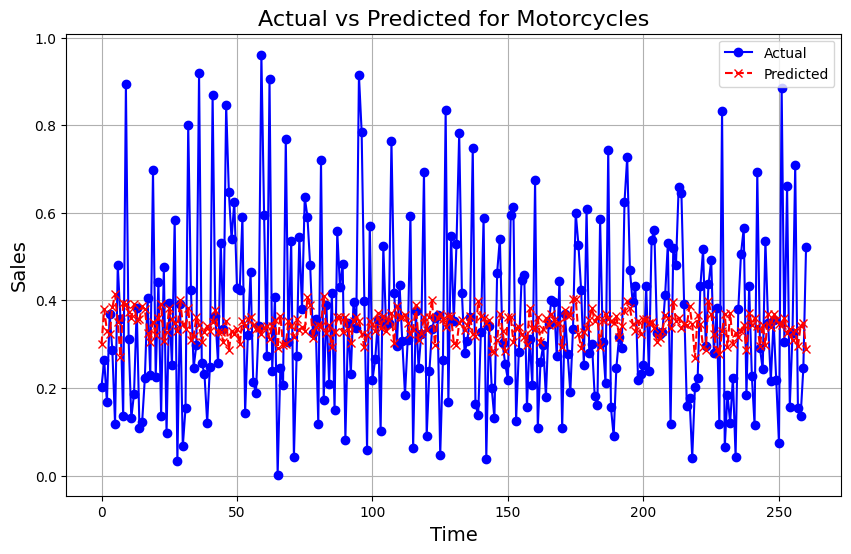

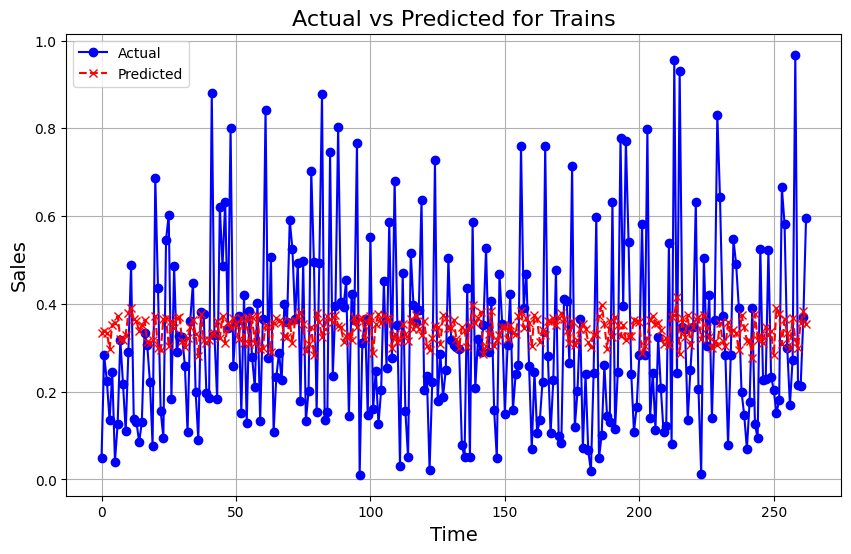

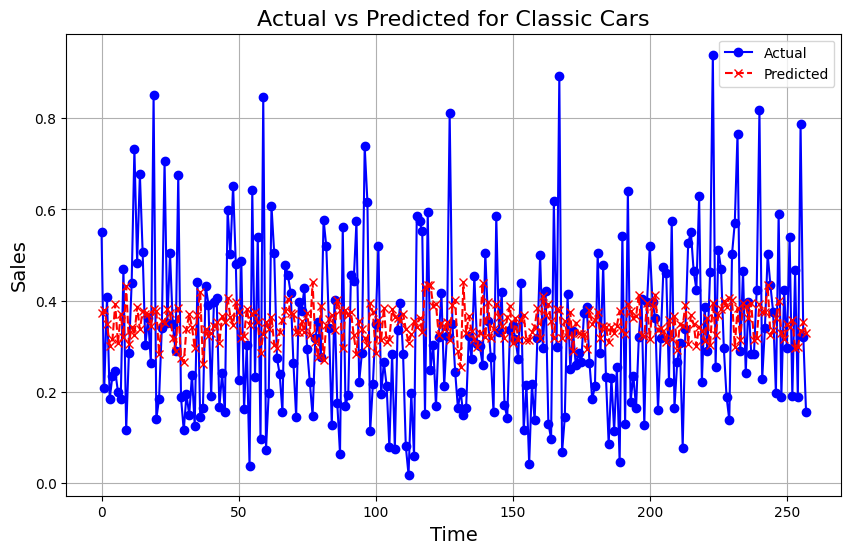

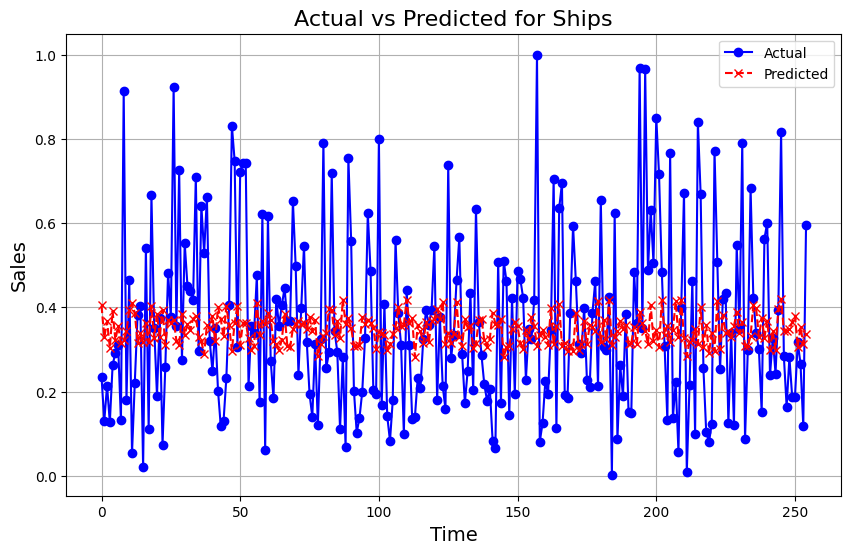

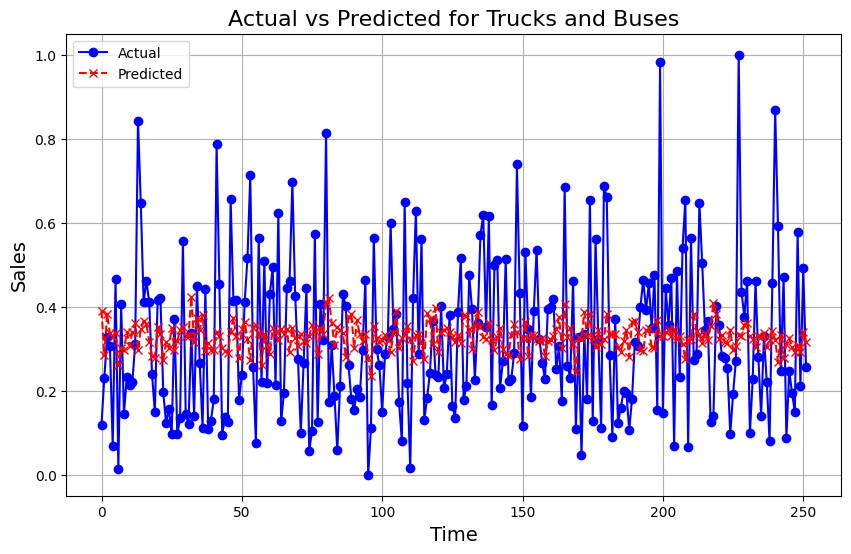

In [ ]:
def plot_actual_vs_predicted(product, actual, predicted):
    plt.figure(figsize=(10, 6))
    plt.plot(actual, label='Actual', color='blue', marker='o')
    plt.plot(predicted, label='Predicted', color='red', linestyle='--', marker='x')
    plt.title(f'Actual vs Predicted for {product}', fontsize=16)
    plt.xlabel('Time', fontsize=14)
    plt.ylabel('Sales', fontsize=14)  # Changed to 'Sales' since we are plotting sales
    plt.legend()
    plt.grid(True)
    plt.show()
# Plot for each product line
for product, result in linear_regression_results.items():
    actual = result['actual']
    predicted = result['predicted']
    # Call the plotting function
    plot_actual_vs_predicted(product, actual, predicted)

In [ ]:
# Function to calculate evaluation metrics
def calculate_metrics(actual, predicted):
    actual = np.array(actual)
    predicted = np.array(predicted)

    # Calculate MAE
    mae = np.mean(np.abs(actual - predicted))

    # Calculate RMSE
    rmse = np.sqrt(np.mean((actual - predicted) ** 2))

    # Calculate MAPE (Mean Absolute Percentage Error)
    mape = np.mean(np.abs((actual - predicted) / (actual+0.000001))) * 100

    # Calculate MSE and R^2 Score
    mse = mean_squared_error(actual, predicted)
    r2 = r2_score(actual, predicted)

    return mae, rmse, mape, mse, r2

# Dictionary to store evaluation results for each product
evaluation_results = {}
for product, result in linear_regression_results.items():
    actual = result['actual']
    predicted = result['predicted']
    mae, rmse, mape, mse, r2 = calculate_metrics(actual, predicted)  # Get all metrics
    evaluation_results[product] = {
        'MAE': mae,
        'RMSE': rmse,
        'MAPE (%)': mape,
        'MSE': mse,
        'R^2 Score': r2
    }

# Create a DataFrame from the evaluation results
evaluation_df = pd.DataFrame.from_dict(evaluation_results, orient='index').reset_index()
evaluation_df.rename(columns={'index': 'Product Code'}, inplace=True)
evaluation_df

,Product Code,MAE,RMSE,MAPE (%),MSE,R^2 Score
0,Planes,0.166201,0.200266,95.346433,0.040107,-0.060484
1,Vintage Cars,0.160868,0.202719,124360.165800,0.041095,-0.050543
2,Motorcycles,0.162686,0.207355,133.288569,0.042996,-0.020320
3,Trains,0.169221,0.209938,122.303882,0.044074,-0.028441
4,Classic Cars,0.151017,0.183470,78.969658,0.033661,-0.030679
5,Ships,0.168048,0.214189,134.274245,0.045877,-0.003411
6,Trucks and Buses,0.153100,0.187033,409.389824,0.034981,0.005551


In [ ]:
# linear_regression_results

In [ ]:
df2.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2003-01-31,Espoo,Finland,Medium,0.844828,0.538462,0.308708,0.039735,Planes,1,2003,1
2003-01-31,Salzburg,Austria,Large,0.534483,0.503722,0.296373,0.512990,Planes,1,2003,1
2003-01-31,Lille,France,Large,0.600000,0.873418,0.313895,0.321839,Vintage Cars,1,2003,1
2003-01-31,Bergen,Norway,Large,0.354839,0.420398,0.274066,0.268293,Motorcycles,1,2003,1
2003-01-31,Helsinki,Finland,Small,0.648148,0.647500,0.664652,0.691037,Trains,1,2003,1


In [ ]:
##### Here i include the city, country and dealsize then the result is very deviates
linear_regression_results1 = {}

df2 = df2.reset_index(drop=True)

# Loop through each unique product line
unique_product_codes = df2['PRODUCTLINE'].unique()
for product in unique_product_codes:
    product_data = df2[df2['PRODUCTLINE'] == product]
    categorical_features = ['MONTH_ID','CITY', 'COUNTRY', 'DEALSIZE']
    product_data_encoded = pd.get_dummies(product_data, columns=categorical_features, drop_first=True)

    # Prepare features (X) and target (y)
    X = product_data_encoded.drop(columns=['SALES', 'PRODUCTLINE', 'QTR_ID','YEAR_ID'])  # Drop ORDERDATE from X
    y = product_data_encoded['SALES']

    # Train-test split (70% train, 30% test)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Get the ORDERDATE for the test set (aligned with y_test)
    order_dates_test = product_data_encoded.loc[X_test.index]
    model = LinearRegression()
    model.fit(X_train, y_train)

    # Predict on test set
    y_pred = model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    # Store the model and results
    linear_regression_results1[product] = {
        'model': model,
        'mse': mse,
        'r2_score': r2,
        'actual': y_test.values,
        'predicted': y_pred,
        'ORDERDATE': order_dates_test.values
    }

In [ ]:
# Dictionary to store evaluation results for each product
evaluation_results1 = {}
for product, result in linear_regression_results1.items():
    actual = result['actual']
    predicted = result['predicted']
    mae, rmse, mape, mse, r2 = calculate_metrics(actual, predicted)  # Get all metrics
    evaluation_results1[product] = {
        'MAE': mae,
        'RMSE': rmse,
        'MAPE (%)': mape,
        'MSE': mse,
        'R^2 Score': r2
    }

# Create a DataFrame from the evaluation results
evaluation_df = pd.DataFrame.from_dict(evaluation_results1, orient='index').reset_index()
evaluation_df.rename(columns={'index': 'Product Code'}, inplace=True)
evaluation_df

,Product Code,MAE,RMSE,MAPE (%),MSE,R^2 Score
0,Planes,0.167362,0.202582,96.185445,0.041039,-0.085151
1,Vintage Cars,0.169413,0.212828,121725.711050,0.045296,-0.157926
2,Motorcycles,0.171642,0.215227,125.049707,0.046323,-0.099261
3,Trains,0.184729,0.227804,126.960575,0.051895,-0.210931
4,Classic Cars,0.156068,0.190595,79.946838,0.036326,-0.112280
5,Ships,0.174224,0.221271,137.906655,0.048961,-0.070862
6,Trucks and Buses,0.157003,0.197564,372.033767,0.039031,-0.109581


**Conclusion:-** When these variables are included, certain product lines like Vintage Cars and Classic Cars show abnormally high errors (e.g., MSE in the quintillions and extremely low R² scores). These numbers indicate that including CITY, COUNTRY, and DEALSIZE likely introduces noise for some product lines, leading to poor performance.

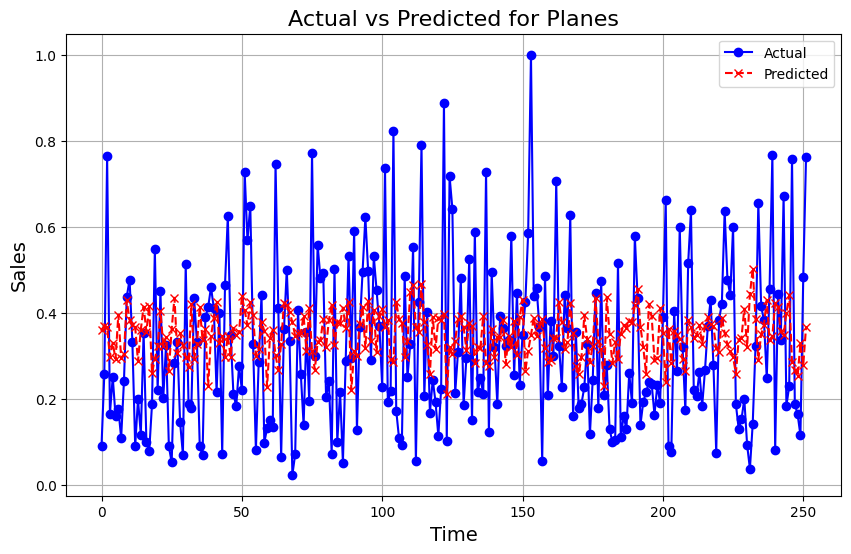

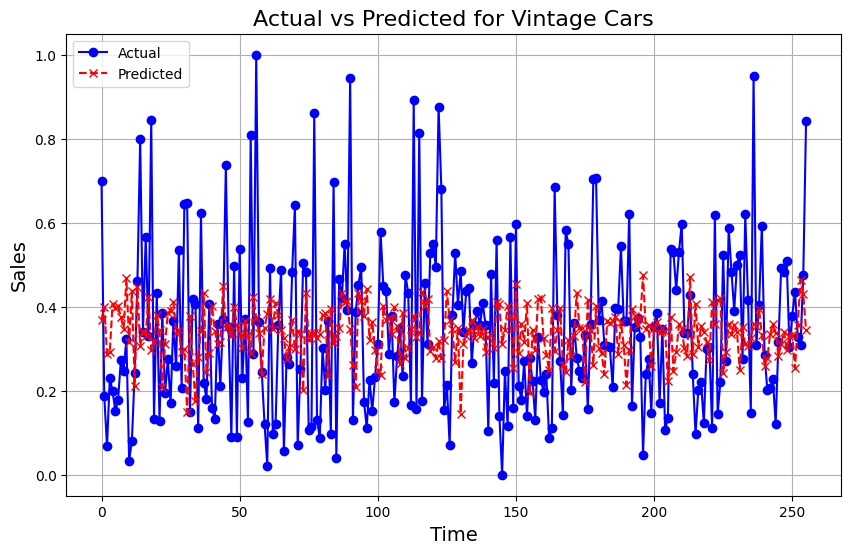

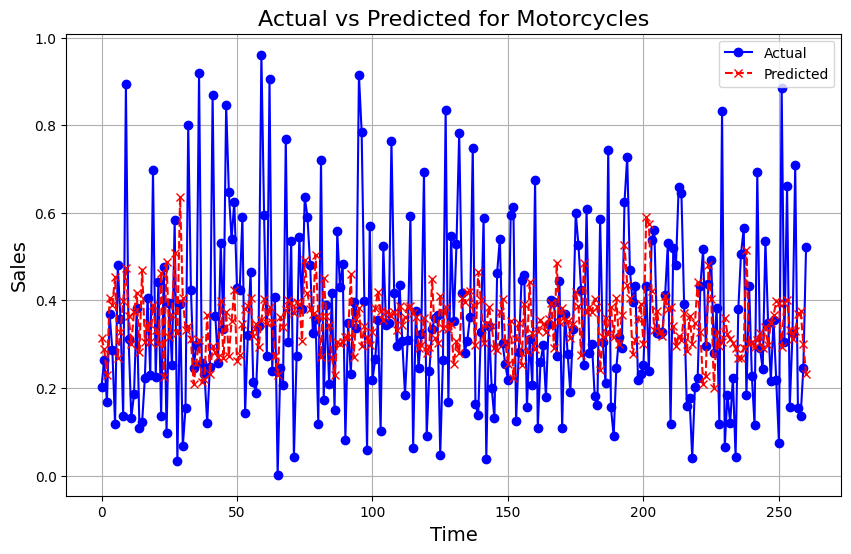

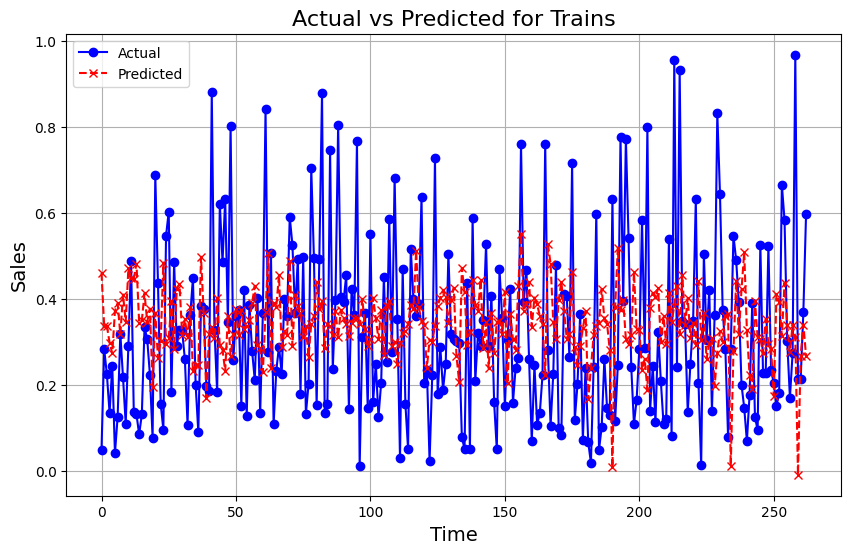

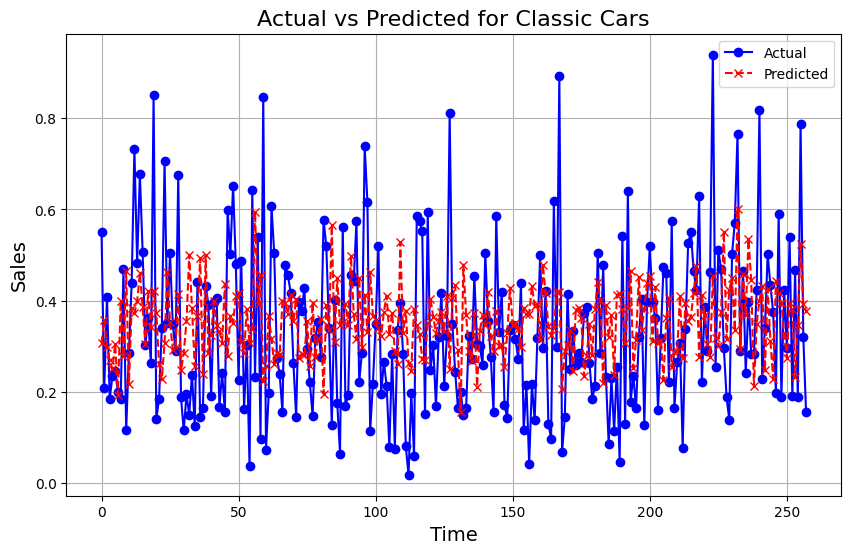

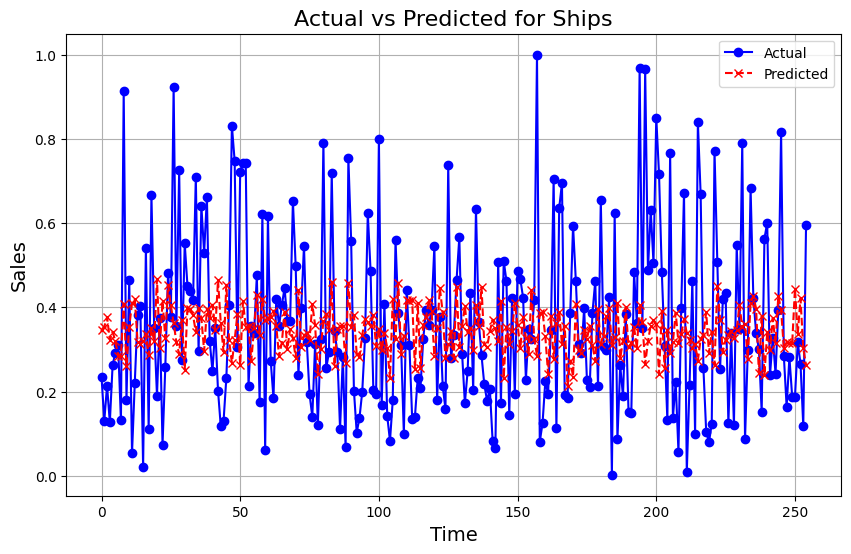

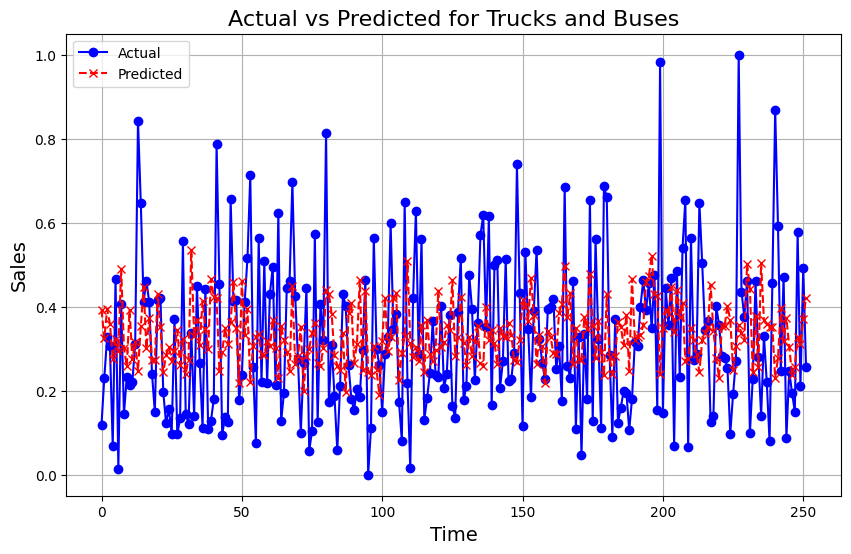

In [ ]:
def plot_actual_vs_predicted(product, actual, predicted):
    plt.figure(figsize=(10, 6))
    plt.plot(actual, label='Actual', color='blue', marker='o')
    plt.plot(predicted, label='Predicted', color='red', linestyle='--', marker='x')
    plt.title(f'Actual vs Predicted for {product}', fontsize=16)
    plt.xlabel('Time', fontsize=14)
    plt.ylabel('Sales', fontsize=14)  # Changed to 'Sales' since we are plotting sales
    plt.legend()
    plt.grid(True)
    plt.show()
# Plot for each product line
for product, result in linear_regression_results1.items():
    actual = result['actual']
    predicted = result['predicted']
    # Call the plotting function
    plot_actual_vs_predicted(product, actual, predicted)

### ***ElasticNet***

In [ ]:
scale_df.sample(4)

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,ORDERDATE,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
4451,Stavern,Norway,Small,0.278689,0.338308,0.210115,0.565678,2013-12-31,Ships,12,2013,4
2493,Pasadena,USA,Medium,0.451613,0.758706,0.261084,0.330793,2007-11-30,Motorcycles,11,2007,4
1388,Pasadena,USA,Small,0.543860,0.445545,0.655942,0.174959,2003-07-31,Trucks and Buses,7,2003,3
2962,Bridgewater,USA,Small,0.741379,0.228288,0.417140,0.457972,2015-04-30,Planes,4,2015,2


In [ ]:
df2=scale_df.copy()
df2 = df2.sort_values(by='ORDERDATE')
# Set ORDERDATE as the index
df2.set_index('ORDERDATE', inplace=True)

In [ ]:
df2.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2003-01-31,Espoo,Finland,Medium,0.844828,0.538462,0.308708,0.039735,Planes,1,2003,1
2003-01-31,Salzburg,Austria,Large,0.534483,0.503722,0.296373,0.512990,Planes,1,2003,1
2003-01-31,Lille,France,Large,0.600000,0.873418,0.313895,0.321839,Vintage Cars,1,2003,1
2003-01-31,Bergen,Norway,Large,0.354839,0.420398,0.274066,0.268293,Motorcycles,1,2003,1
2003-01-31,Helsinki,Finland,Small,0.648148,0.647500,0.664652,0.691037,Trains,1,2003,1


In [ ]:
from sklearn.linear_model import ElasticNet

In [ ]:
df2.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2003-01-31,Espoo,Finland,Medium,0.844828,0.538462,0.308708,0.039735,Planes,1,2003,1
2003-01-31,Salzburg,Austria,Large,0.534483,0.503722,0.296373,0.512990,Planes,1,2003,1
2003-01-31,Lille,France,Large,0.600000,0.873418,0.313895,0.321839,Vintage Cars,1,2003,1
2003-01-31,Bergen,Norway,Large,0.354839,0.420398,0.274066,0.268293,Motorcycles,1,2003,1
2003-01-31,Helsinki,Finland,Small,0.648148,0.647500,0.664652,0.691037,Trains,1,2003,1


In [ ]:
elasticnet_result = {}

# Loop through each unique product line
unique_product_codes = df2['PRODUCTLINE'].unique()
for product in unique_product_codes:
    product_data = df2[df2['PRODUCTLINE'] == product]

    # Select features to be one-hot encoded
    categorical_features = ['MONTH_ID', 'CITY', 'COUNTRY', 'DEALSIZE']

    # Perform one-hot encoding on categorical columns
    product_data_encoded = pd.get_dummies(product_data, columns=categorical_features, drop_first=True)

    # Prepare features (X) and target (y)
    columns_to_drop = ['SALES', 'PRODUCTLINE', 'QTR_ID', 'YEAR_ID']
    X = product_data_encoded.drop(columns=[col for col in columns_to_drop if col in product_data_encoded.columns])
    y = product_data_encoded['SALES']

    # Train-test split (70% train, 30% test)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Keep ORDERDATE aligned with y_test by indexing directly from the test set
    order_dates_test = X_test.index  # ORDERDATE is retained as the index

    # Initialize and train the ElasticNet model
    alpha = 0.001  # Regularization strength
    l1_ratio = 0.9  # means l2 have 30% weighted
    elastic_net = ElasticNet(alpha=alpha, l1_ratio=l1_ratio)
    elastic_net.fit(X_train, y_train)

    # Predict on test set
    y_pred = elastic_net.predict(X_test)

    # Evaluate the model
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    # Store the model and results, retaining ORDERDATE as index
    elasticnet_result[product] = {
        'model': elastic_net,
        'mse': mse,
        'r2_score': r2,
        'actual': y_test.values,
        'predicted': y_pred,
        'ORDERDATE': order_dates_test  # Keeps ORDERDATE as index for the test set results
    }

    # # Output results for each product line
    # print(f"Product Line: {product}")
    # print(f"Mean Squared Error: {mse:.2f}")
    # print(f"R² Score: {r2:.2f}\n")

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import ElasticNet
from sklearn.metrics import mean_squared_error, r2_score

elasticnet_result = {}

# Define the parameter grid for alpha and l1_ratio
param_grid = {
    'alpha': [0.001, 0.01, 0.1, 1, 10],  # Regularization strength
    'l1_ratio': [0.1, 0.3, 0.5, 0.7, 0.9]  # Balance between L1 and L2 penalties
}

# Loop through each unique product line
unique_product_codes = df2['PRODUCTLINE'].unique()
for product in unique_product_codes:
    product_data = df2[df2['PRODUCTLINE'] == product]

    # Select features to be one-hot encoded
    categorical_features = ['MONTH_ID', 'CITY', 'COUNTRY', 'DEALSIZE']

    # Perform one-hot encoding on categorical columns
    product_data_encoded = pd.get_dummies(product_data, columns=categorical_features, drop_first=True)

    # Prepare features (X) and target (y)
    columns_to_drop = ['SALES', 'PRODUCTLINE', 'QTR_ID', 'YEAR_ID']
    X = product_data_encoded.drop(columns=[col for col in columns_to_drop if col in product_data_encoded.columns])
    y = product_data_encoded['SALES']

    # Train-test split (70% train, 30% test)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Keep ORDERDATE aligned with y_test by indexing directly from the test set
    order_dates_test = X_test.index  # ORDERDATE is retained as the index

    # Use GridSearchCV to find the best alpha and l1_ratio
    elastic_net = ElasticNet()  # ElasticNet model without fixed alpha/l1_ratio
    grid_search = GridSearchCV(estimator=elastic_net, param_grid=param_grid, scoring='neg_mean_squared_error', cv=5, verbose=1)
    grid_search.fit(X_train, y_train)

    # Get the best parameters from the grid search
    best_alpha = grid_search.best_params_['alpha']
    best_l1_ratio = grid_search.best_params_['l1_ratio']
    print(f"Best parameters for {product}: alpha={best_alpha}, l1_ratio={best_l1_ratio}")

    # Train the model with the best parameters
    best_elastic_net = ElasticNet(alpha=best_alpha, l1_ratio=best_l1_ratio)
    best_elastic_net.fit(X_train, y_train)

    # Predict on test set
    y_pred = best_elastic_net.predict(X_test)

    # Evaluate the model
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    # Store the model and results, retaining ORDERDATE as index
    elasticnet_result[product] = {
        'model': best_elastic_net,
        'best_alpha': best_alpha,
        'best_l1_ratio': best_l1_ratio,
        'mse': mse,
        'r2_score': r2,
        'actual': y_test.values,
        'predicted': y_pred,
        'ORDERDATE': order_dates_test  # Keeps ORDERDATE as index for the test set results
    }

    # Output results for the product line
    print(f"Product Line: {product}")
    print(f"Mean Squared Error: {mse:.2f}")
    print(f"R² Score: {r2:.2f}\n")


Fitting 5 folds for each of 25 candidates, totalling 125 fits
Best parameters for Planes: alpha=0.1, l1_ratio=0.3
Product Line: Planes
Mean Squared Error: 0.04
R² Score: -0.01

Fitting 5 folds for each of 25 candidates, totalling 125 fits
Best parameters for Vintage Cars: alpha=0.01, l1_ratio=0.9
Product Line: Vintage Cars
Mean Squared Error: 0.04
R² Score: -0.00

Fitting 5 folds for each of 25 candidates, totalling 125 fits
Best parameters for Motorcycles: alpha=0.01, l1_ratio=0.7
Product Line: Motorcycles
Mean Squared Error: 0.04
R² Score: -0.01

Fitting 5 folds for each of 25 candidates, totalling 125 fits
Best parameters for Trains: alpha=0.1, l1_ratio=0.1
Product Line: Trains
Mean Squared Error: 0.04
R² Score: -0.01

Fitting 5 folds for each of 25 candidates, totalling 125 fits
Best parameters for Classic Cars: alpha=0.01, l1_ratio=0.5
Product Line: Classic Cars
Mean Squared Error: 0.03
R² Score: -0.01

Fitting 5 folds for each of 25 candidates, totalling 125 fits
Best parameters 

In [ ]:
alpha = 0.005  # Regularization strength
l1_ratio = 0.4

In [ ]:
a= alpha*l1_ratio
b= alpha*(1-l1_ratio)
print(a, '\n', b)

0.002 
 0.003


In [ ]:
# Function to calculate evaluation metrics
def calculate_metrics(actual, predicted):
    actual = np.array(actual)
    predicted = np.array(predicted)

    # Calculate MAE
    mae = np.mean(np.abs(actual - predicted))

    # Calculate RMSE
    rmse = np.sqrt(np.mean((actual - predicted) ** 2))

    # Calculate MAPE (Mean Absolute Percentage Error)
    mape = np.mean(np.abs((actual - predicted) / (actual+0.000001))) * 100

    # Calculate MSE and R^2 Score
    mse = mean_squared_error(actual, predicted)
    r2 = r2_score(actual, predicted)

    return mae, rmse, mape, mse, r2

# Dictionary to store evaluation results for each product
evaluation_results = {}
for product, result in elasticnet_result.items():
    actual = result['actual']
    predicted = result['predicted']
    mae, rmse, mape, mse, r2 = calculate_metrics(actual, predicted)  # Get all metrics
    evaluation_results[product] = {
        'MAE': mae,
        'RMSE': rmse,
        'MAPE (%)': mape,
        'MSE': mse,
        'R^2 Score': r2
    }

# Create a DataFrame from the evaluation results
evaluation_df = pd.DataFrame.from_dict(evaluation_results, orient='index').reset_index()
evaluation_df.rename(columns={'index': 'Product Code'}, inplace=True)
evaluation_df

,Product Code,MAE,RMSE,MAPE (%),MSE,R^2 Score
0,Planes,0.163545,0.195760,93.459151,0.038322,-0.013299
1,Vintage Cars,0.156701,0.197838,132983.918813,0.039140,-0.000565
2,Motorcycles,0.161813,0.205949,144.074642,0.042415,-0.006535
3,Trains,0.167665,0.207588,123.270020,0.043093,-0.005549
4,Classic Cars,0.149241,0.181876,79.850141,0.033079,-0.012839
5,Ships,0.169601,0.214649,142.657192,0.046074,-0.007727
6,Trucks and Buses,0.153740,0.187682,476.094026,0.035225,-0.001363


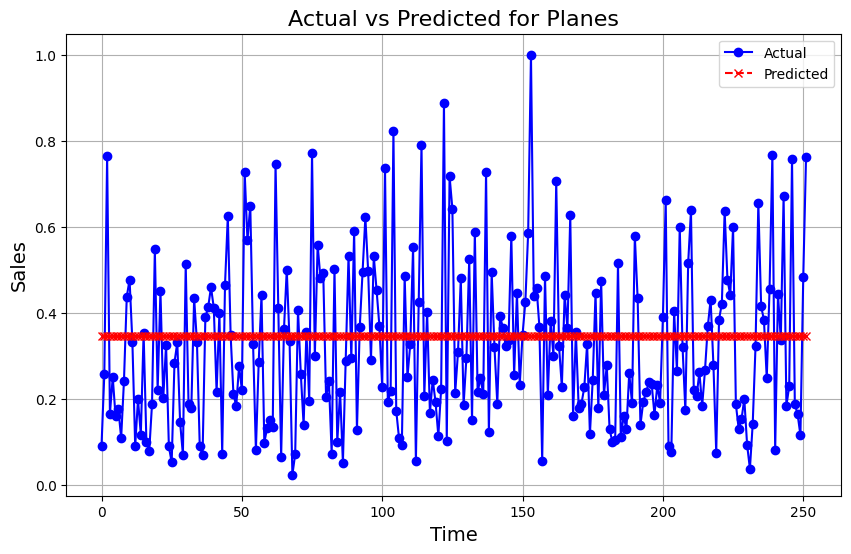

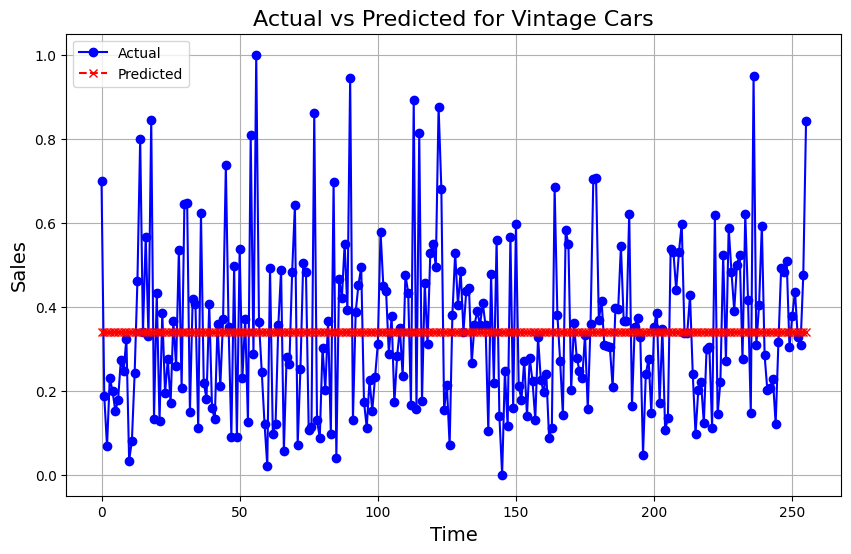

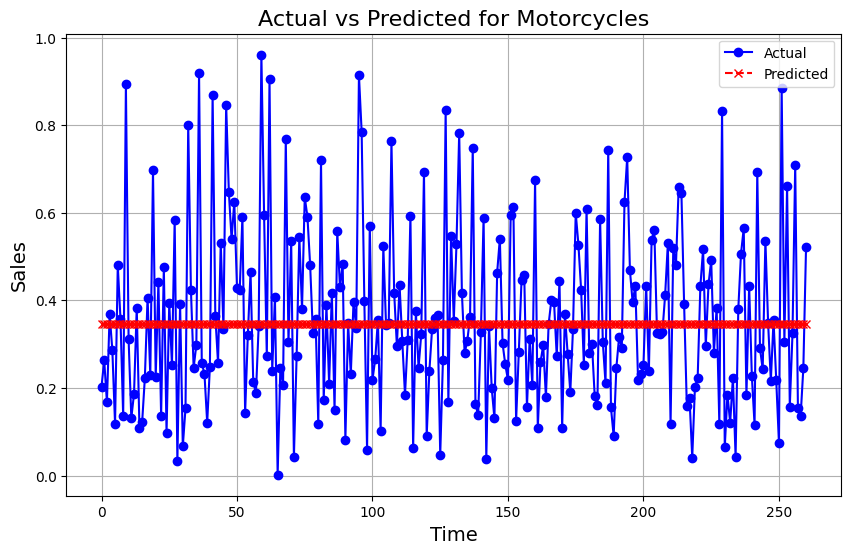

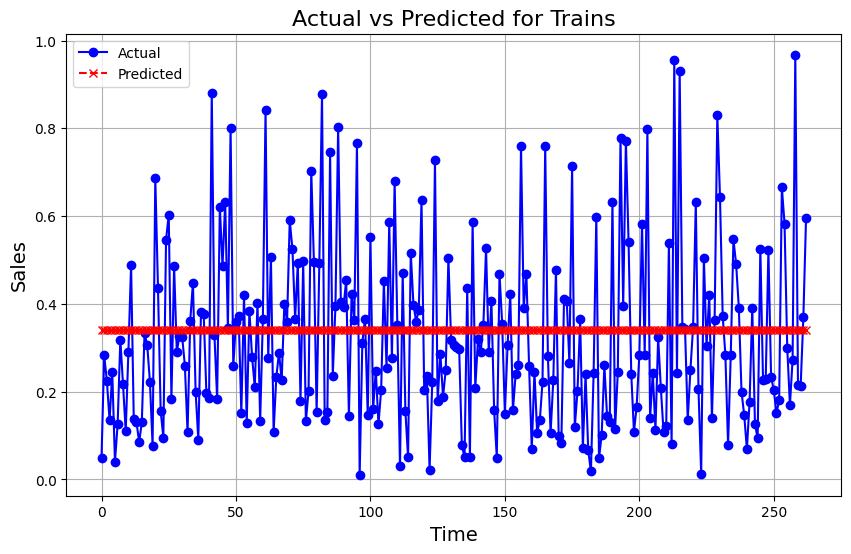

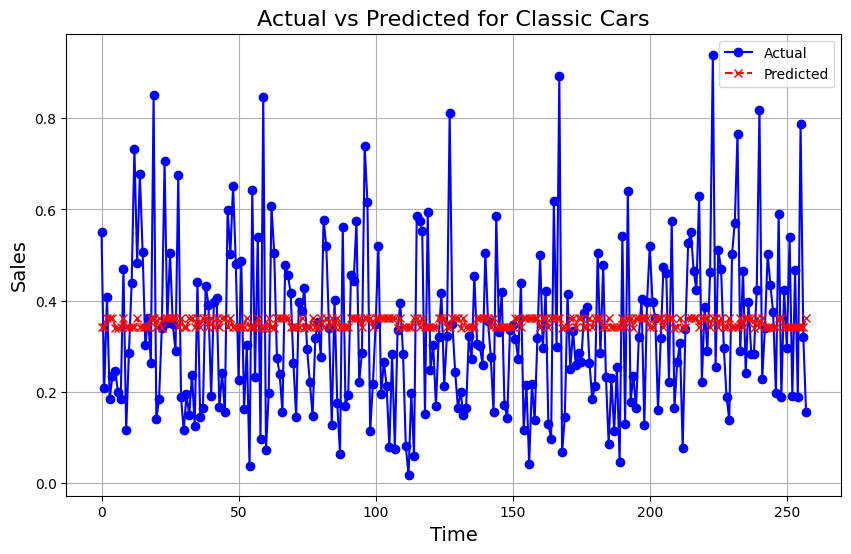

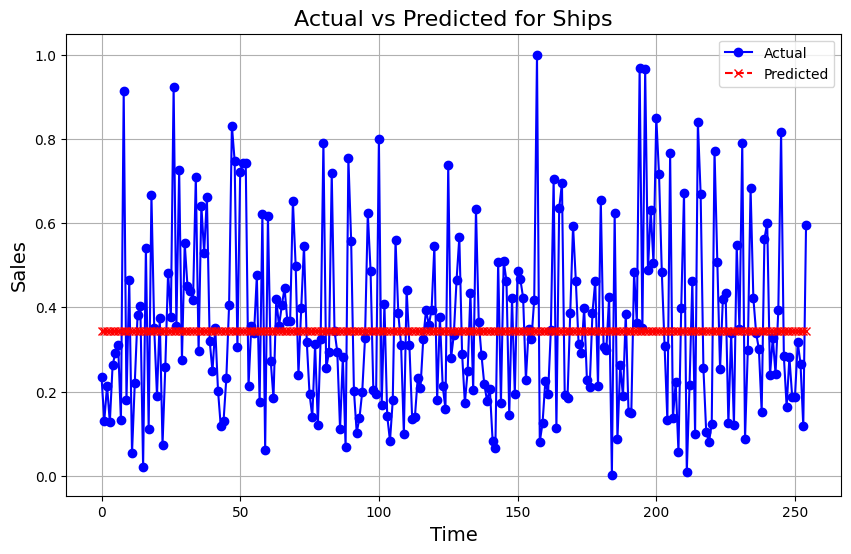

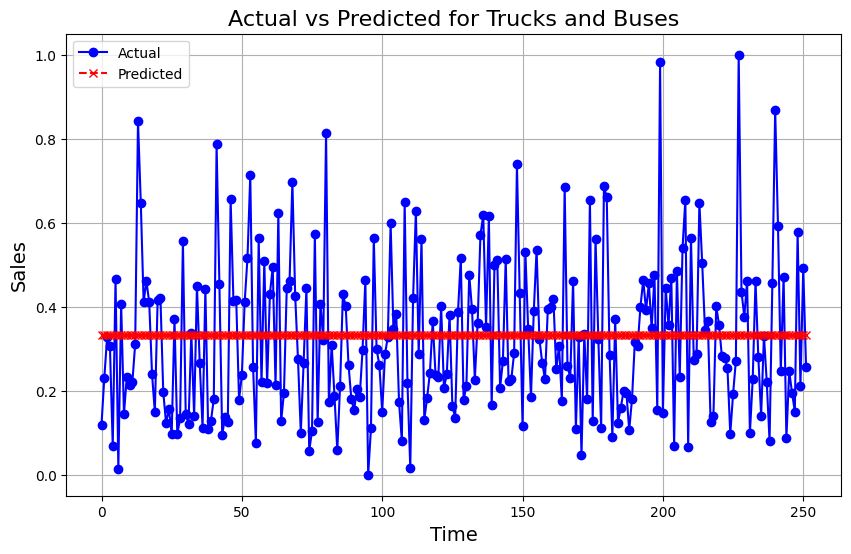

In [ ]:
def plot_actual_vs_predicted(product, actual, predicted):
    plt.figure(figsize=(10, 6))
    plt.plot(actual, label='Actual', color='blue', marker='o')
    plt.plot(predicted, label='Predicted', color='red', linestyle='--', marker='x')
    plt.title(f'Actual vs Predicted for {product}', fontsize=16)
    plt.xlabel('Time', fontsize=14)
    plt.ylabel('Sales', fontsize=14)  # Changed to 'Sales' since we are plotting sales
    plt.legend()
    plt.grid(True)
    plt.show()
# Plot for each product line
for product, result in elasticnet_result.items():
    actual = result['actual']
    predicted = result['predicted']
    # Call the plotting function
    plot_actual_vs_predicted(product, actual, predicted)

### **Random Forest**

In [ ]:
from sklearn.ensemble import RandomForestRegressor

In [ ]:
random_forest_result = {}

# Loop through each unique product line
unique_product_codes = df2['PRODUCTLINE'].unique()
for product in unique_product_codes:
    product_data = df2[df2['PRODUCTLINE'] == product]

    # Select features to be one-hot encoded
    categorical_features = ['MONTH_ID', 'CITY', 'COUNTRY', 'DEALSIZE']

    # Perform one-hot encoding on categorical columns
    product_data_encoded = pd.get_dummies(product_data, columns=categorical_features, drop_first=True)

    # Prepare features (X) and target (y)
    columns_to_drop = ['SALES', 'PRODUCTLINE', 'QTR_ID', 'YEAR_ID']
    X = product_data_encoded.drop(columns=[col for col in columns_to_drop if col in product_data_encoded.columns])
    y = product_data_encoded['SALES']

    # Train-test split (70% train, 30% test)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Keep ORDERDATE aligned with y_test by indexing directly from the test set
    order_dates_test = X_test.index  # ORDERDATE is retained as the index

    # Initialize and train the Random Forest model
    rf = RandomForestRegressor(n_estimators=110, random_state=42)
    rf.fit(X_train, y_train)

    # Predict on test set
    y_pred = rf.predict(X_test)

    # Evaluate the model
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    # Store the model and results, retaining ORDERDATE as index
    random_forest_result[product] = {
        'model': rf,
        'mse': mse,
        'r2_score': r2,
        'actual': y_test.values,
        'predicted': y_pred,
        'ORDERDATE': order_dates_test  # Keeps ORDERDATE as index for the test set results
    }

    # # Output results for each product line
    # print(f"Product Line: {product}")
    # print(f"Mean Squared Error: {mse:.2f}")
    # print(f"R² Score: {r2:.2f}\n")


In [ ]:
df2.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2003-01-31,Espoo,Finland,Medium,0.844828,0.538462,0.308708,0.039735,Planes,1,2003,1
2003-01-31,Salzburg,Austria,Large,0.534483,0.503722,0.296373,0.512990,Planes,1,2003,1
2003-01-31,Lille,France,Large,0.600000,0.873418,0.313895,0.321839,Vintage Cars,1,2003,1
2003-01-31,Bergen,Norway,Large,0.354839,0.420398,0.274066,0.268293,Motorcycles,1,2003,1
2003-01-31,Helsinki,Finland,Small,0.648148,0.647500,0.664652,0.691037,Trains,1,2003,1


In [ ]:
# Function to calculate evaluation metrics
def calculate_metrics(actual, predicted):
    actual = np.array(actual)
    predicted = np.array(predicted)

    # Calculate MAE
    mae = np.mean(np.abs(actual - predicted))

    # Calculate RMSE
    rmse = np.sqrt(np.mean((actual - predicted) ** 2))

    # Calculate MAPE (Mean Absolute Percentage Error)
    mape = np.mean(np.abs((actual - predicted) / (actual+0.000001))) * 100

    # Calculate MSE and R^2 Score
    mse = mean_squared_error(actual, predicted)
    r2 = r2_score(actual, predicted)

    return mae, rmse, mape, mse, r2

# Dictionary to store evaluation results for each product
evaluation_results = {}
for product, result in random_forest_result.items():
    actual = result['actual']
    predicted = result['predicted']
    mae, rmse, mape, mse, r2 = calculate_metrics(actual, predicted)  # Get all metrics
    evaluation_results[product] = {
        'MAE': mae,
        'RMSE': rmse,
        'MAPE (%)': mape,
        'MSE': mse,
        'R^2 Score': r2
    }

# Create a DataFrame from the evaluation results
evaluation_df = pd.DataFrame.from_dict(evaluation_results, orient='index').reset_index()
evaluation_df.rename(columns={'index': 'Product Code'}, inplace=True)
evaluation_df

,Product Code,MAE,RMSE,MAPE (%),MSE,R^2 Score
0,Planes,0.166251,0.203863,91.473343,0.041560,-0.098919
1,Vintage Cars,0.169078,0.211407,123919.842484,0.044693,-0.142520
2,Motorcycles,0.171566,0.214781,142.827755,0.046131,-0.094706
3,Trains,0.180053,0.224163,125.929075,0.050249,-0.172539
4,Classic Cars,0.161210,0.196744,84.236606,0.038708,-0.185202
5,Ships,0.178384,0.222780,136.468198,0.049631,-0.085522
6,Trucks and Buses,0.155438,0.192738,382.889116,0.037148,-0.056040


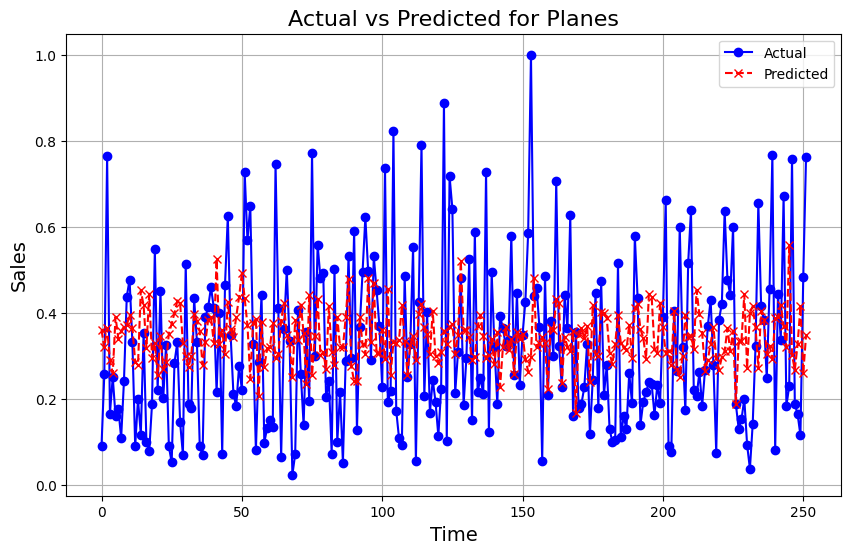

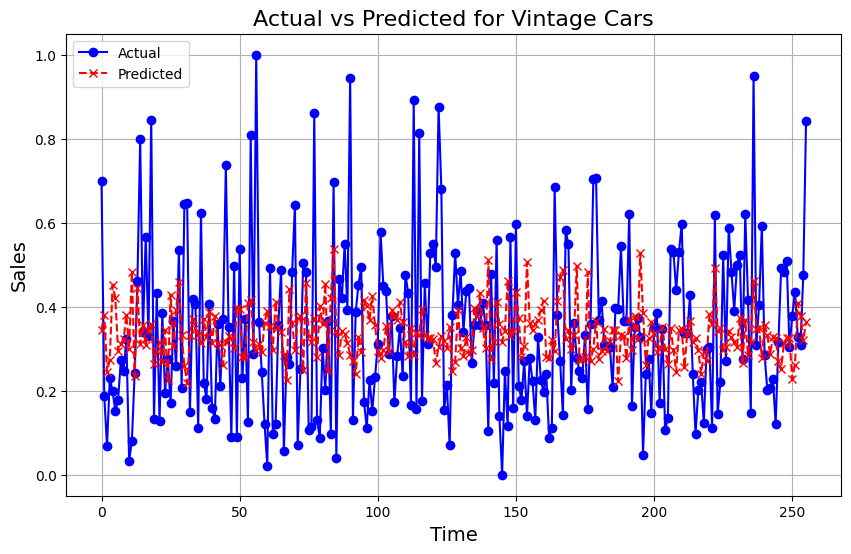

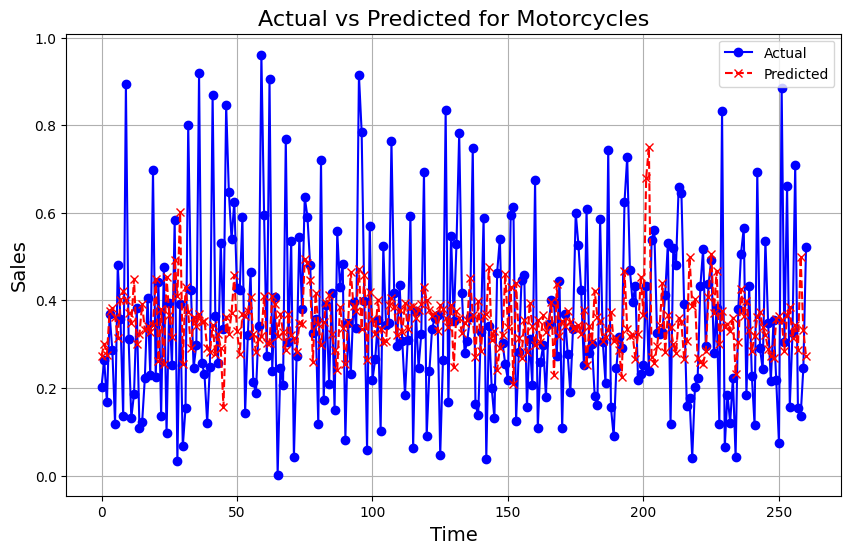

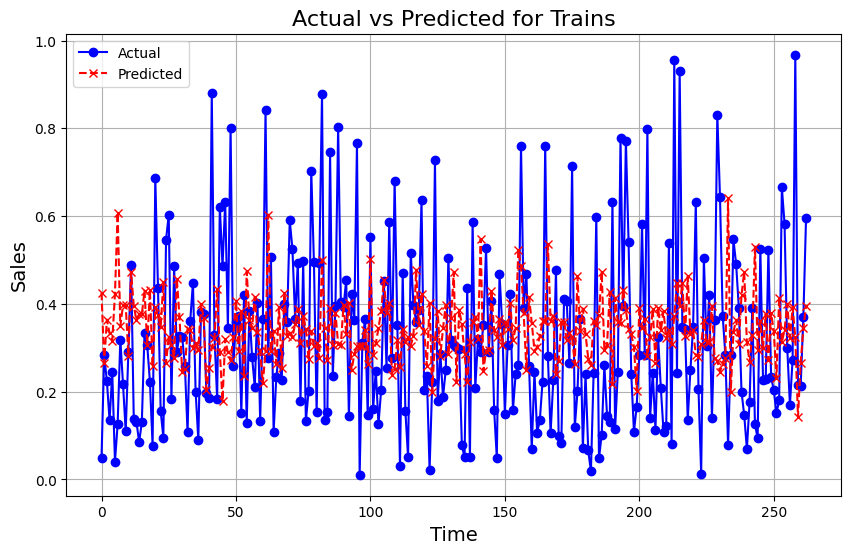

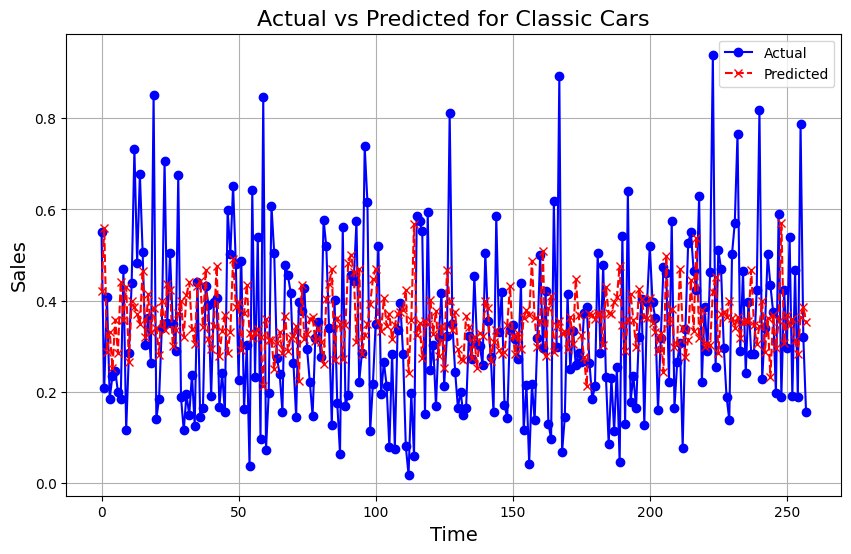

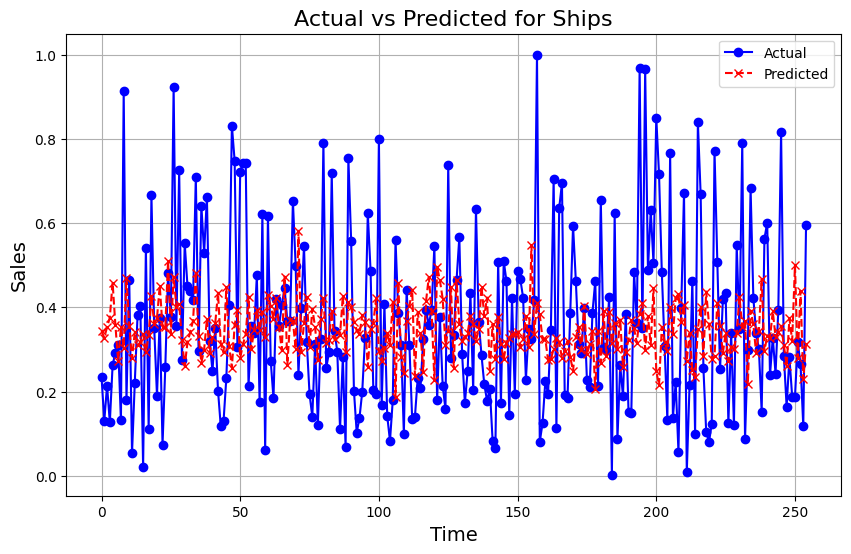

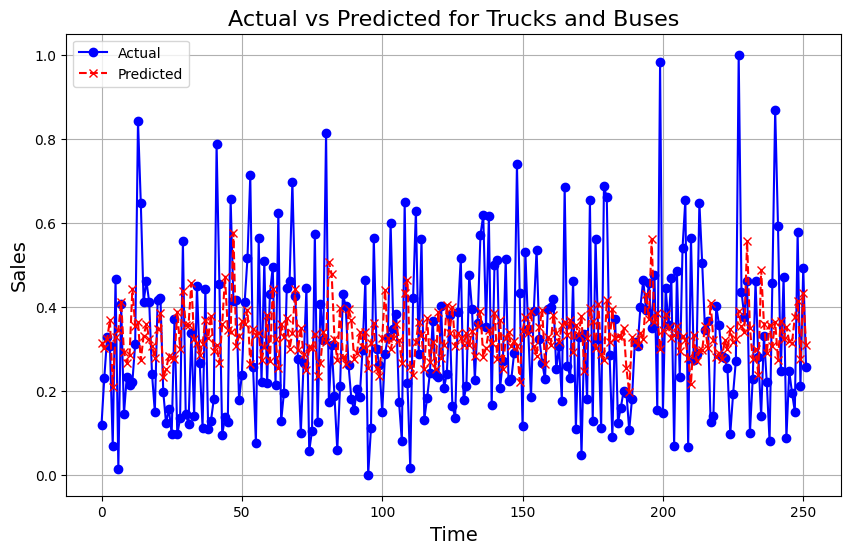

In [ ]:
def plot_actual_vs_predicted(product, actual, predicted):
    plt.figure(figsize=(10, 6))
    plt.plot(actual, label='Actual', color='blue', marker='o')
    plt.plot(predicted, label='Predicted', color='red', linestyle='--', marker='x')
    plt.title(f'Actual vs Predicted for {product}', fontsize=16)
    plt.xlabel('Time', fontsize=14)
    plt.ylabel('Sales', fontsize=14)  # Changed to 'Sales' since we are plotting sales
    plt.legend()
    plt.grid(True)
    plt.show()
# Plot for each product line
for product, result in random_forest_result.items():
    actual = result['actual']
    predicted = result['predicted']
    # Call the plotting function
    plot_actual_vs_predicted(product, actual, predicted)

### **XGboost**

In [ ]:
df2.shape

(5984, 11)

In [ ]:
df2.sample(4)

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2014-08-31,Allentown,USA,Small,0.903226,0.435323,0.105751,0.255589,Motorcycles,8,2014,3
2006-01-31,Allentown,USA,Medium,0.465517,0.523573,0.255032,0.395313,Planes,1,2006,1
2010-09-30,Melbourne,Australia,Small,0.704918,0.549751,0.311782,0.137712,Ships,9,2010,3
2007-08-31,NYC,USA,Large,0.571429,0.473945,0.136969,0.162708,Classic Cars,8,2007,3


In [ ]:
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
import pandas as pd

xgboost_result = {}

# Loop through each unique product line
unique_product_codes = df2['PRODUCTLINE'].unique()
for product in unique_product_codes:
    product_data = df2[df2['PRODUCTLINE'] == product]

    # Select features to be one-hot encoded
    categorical_features = ['MONTH_ID', 'CITY', 'COUNTRY', 'DEALSIZE']

    # Perform one-hot encoding on categorical columns
    product_data_encoded = pd.get_dummies(product_data, columns=categorical_features, drop_first=True)

    # Prepare features (X) and target (y)
    columns_to_drop = ['SALES', 'PRODUCTLINE', 'QTR_ID', 'YEAR_ID']
    X = product_data_encoded.drop(columns=[col for col in columns_to_drop if col in product_data_encoded.columns])
    y = product_data_encoded['SALES']

    # Train-test split (70% train, 30% test)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    # Keep ORDERDATE aligned with y_test by indexing directly from the test set
    order_dates_test = X_test.index  # ORDERDATE is retained as the index

    # Initialize and train the XGBoost model
    xgb = XGBRegressor(n_estimators=100, learning_rate=0.1, max_depth=6, random_state=42)
    xgb.fit(X_train, y_train)

    # Predict on test set
    y_pred = xgb.predict(X_test)

    # Evaluate the model
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    # Store the model and results, retaining ORDERDATE as index
    xgboost_result[product] = {
        'model': xgb,
        'mse': mse,
        'r2_score': r2,
        'actual': y_test.values,
        'predicted': y_pred,
        'ORDERDATE': order_dates_test  # Keeps ORDERDATE as index for the test set results
    }

    # # Output results for each product line
    # print(f"Product Line: {product}")
    # print(f"Mean Squared Error: {mse:.2f}")
    # print(f"R² Score: {r2:.2f}\n")

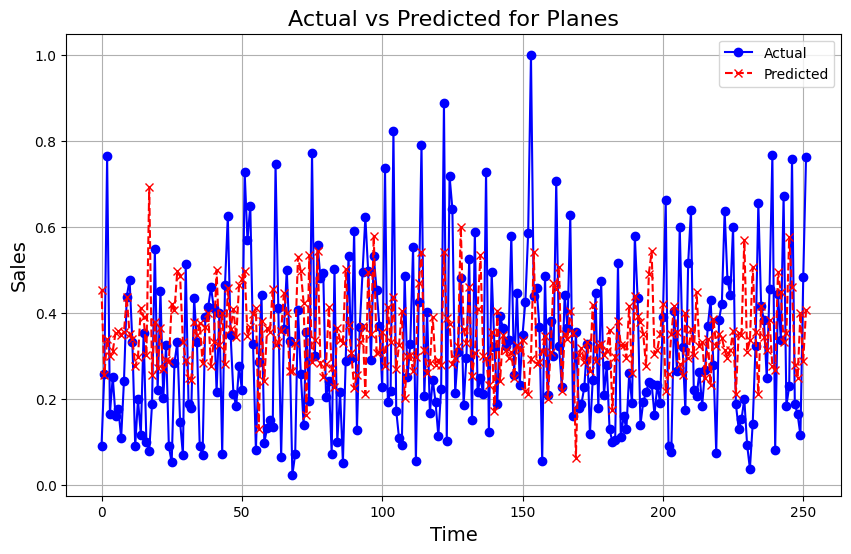

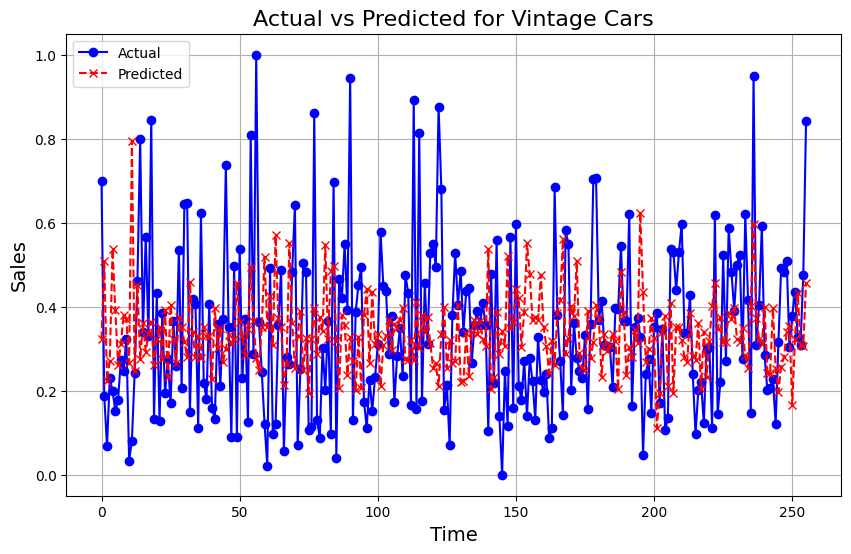

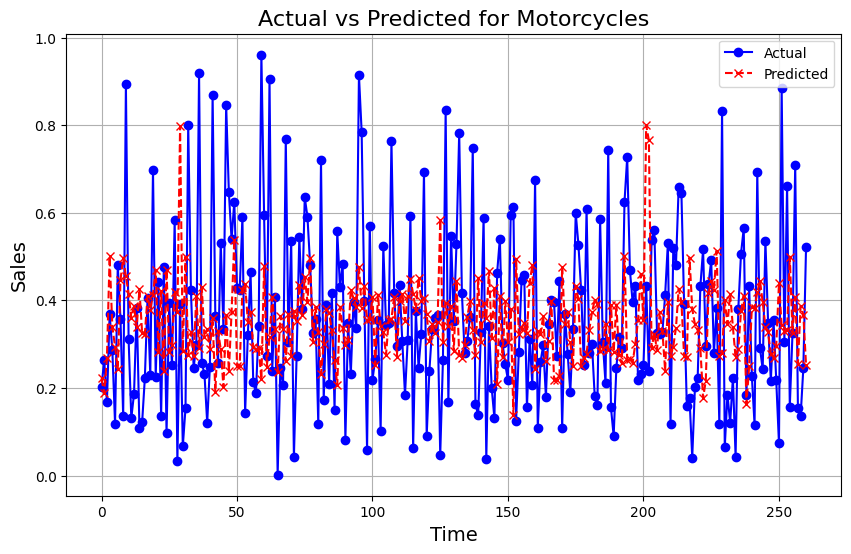

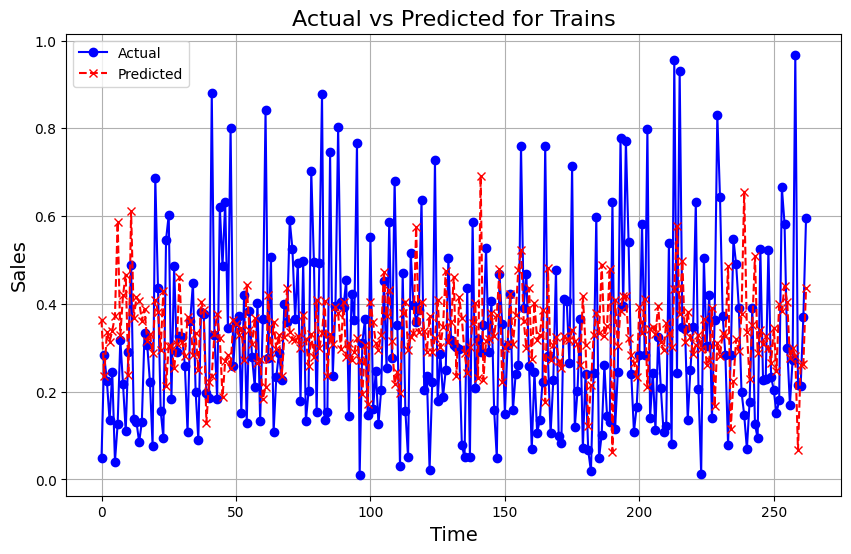

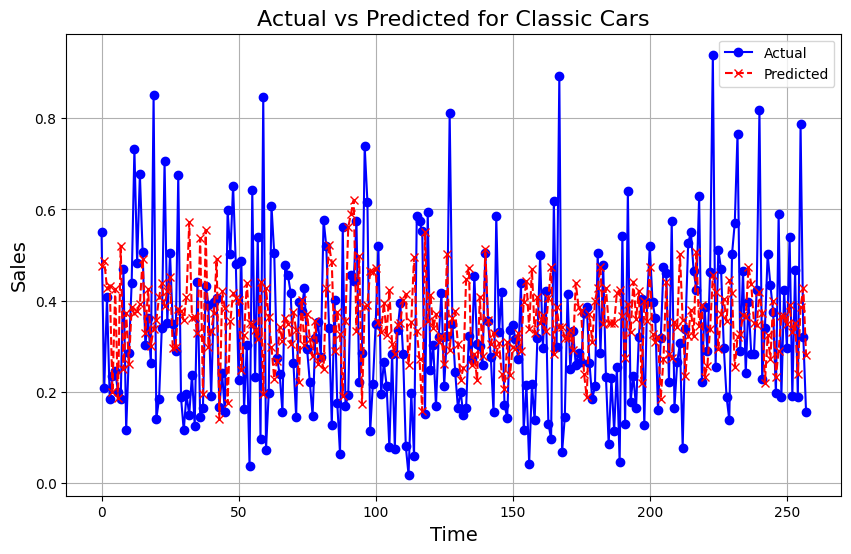

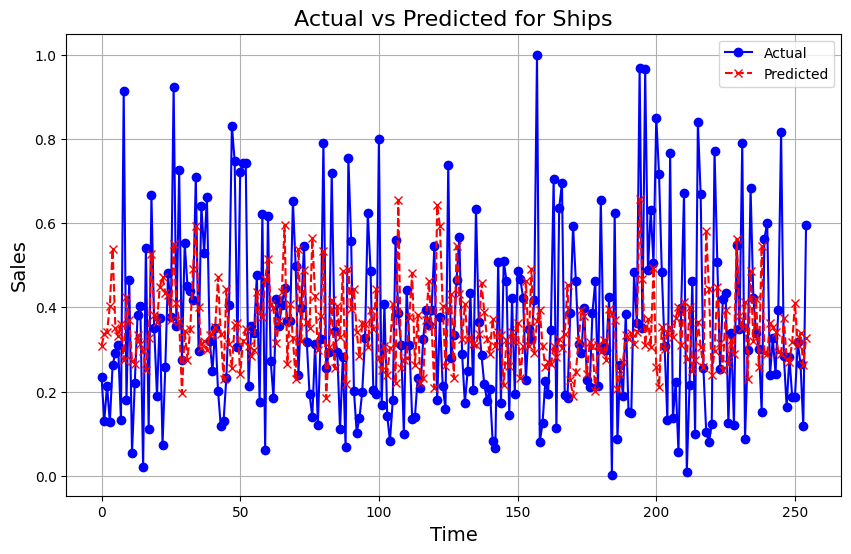

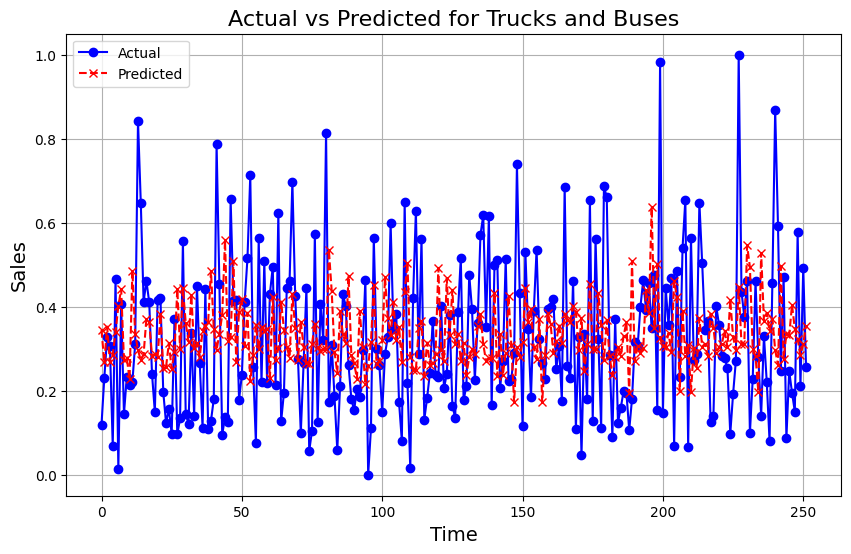

In [ ]:
def plot_actual_vs_predicted(product, actual, predicted):
    plt.figure(figsize=(10, 6))
    plt.plot(actual, label='Actual', color='blue', marker='o')
    plt.plot(predicted, label='Predicted', color='red', linestyle='--', marker='x')
    plt.title(f'Actual vs Predicted for {product}', fontsize=16)
    plt.xlabel('Time', fontsize=14)
    plt.ylabel('Sales', fontsize=14)  # Changed to 'Sales' since we are plotting sales
    plt.legend()
    plt.grid(True)
    plt.show()
# Plot for each product line
for product, result in xgboost_result.items():
    actual = result['actual']
    predicted = result['predicted']
    # Call the plotting function
    plot_actual_vs_predicted(product, actual, predicted)

In [ ]:
# Function to calculate evaluation metrics
def calculate_metrics(actual, predicted):
    actual = np.array(actual)
    predicted = np.array(predicted)

    # Calculate MAE
    mae = np.mean(np.abs(actual - predicted))

    # Calculate RMSE
    rmse = np.sqrt(np.mean((actual - predicted) ** 2))

    # Calculate MAPE (Mean Absolute Percentage Error)
    mape = np.mean(np.abs((actual - predicted) / (actual+0.000001))) * 100

    # Calculate MSE and R^2 Score
    mse = mean_squared_error(actual, predicted)
    r2 = r2_score(actual, predicted)

    return mae, rmse, mape, mse, r2

# Dictionary to store evaluation results for each product
evaluation_results = {}
for product, result in xgboost_result.items():
    actual = result['actual']
    predicted = result['predicted']
    mae, rmse, mape, mse, r2 = calculate_metrics(actual, predicted)  # Get all metrics
    evaluation_results[product] = {
        'MAE': mae,
        'RMSE': rmse,
        'MAPE (%)': mape,
        'MSE': mse,
        'R^2 Score': r2
    }

# Create a DataFrame from the evaluation results
evaluation_df = pd.DataFrame.from_dict(evaluation_results, orient='index').reset_index()
evaluation_df.rename(columns={'index': 'Product Code'}, inplace=True)
evaluation_df

,Product Code,MAE,RMSE,MAPE (%),MSE,R^2 Score
0,Planes,0.171253,0.209460,93.619597,0.043873,-0.160084
1,Vintage Cars,0.178361,0.225034,133453.133042,0.050640,-0.294552
2,Motorcycles,0.179691,0.228155,132.195963,0.052055,-0.235285
3,Trains,0.181718,0.227238,119.453972,0.051637,-0.204922
4,Classic Cars,0.169698,0.206338,87.307676,0.042575,-0.303618
5,Ships,0.180657,0.227059,148.605226,0.051556,-0.127619
6,Trucks and Buses,0.164991,0.203831,396.478999,0.041547,-0.181092


#Experiment on data

In [ ]:
# dfm=df2[df2['PRODUCTLINE']=='Motorcycles']

In [ ]:
# dfm = df2[(df2['PRODUCTLINE'] == 'Motorcycles') & (df2['YEAR_ID'] == 2003)]

In [ ]:
df2.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2003-01-31,Espoo,Finland,Medium,0.844828,0.538462,0.308708,0.039735,Planes,1,2003,1
2003-01-31,Salzburg,Austria,Large,0.534483,0.503722,0.296373,0.512990,Planes,1,2003,1
2003-01-31,Lille,France,Large,0.600000,0.873418,0.313895,0.321839,Vintage Cars,1,2003,1
2003-01-31,Bergen,Norway,Large,0.354839,0.420398,0.274066,0.268293,Motorcycles,1,2003,1
2003-01-31,Helsinki,Finland,Small,0.648148,0.647500,0.664652,0.691037,Trains,1,2003,1


In [ ]:
# Filter data for Motorcycles in the year 2003
# dfm = df2[(df2['PRODUCTLINE'] == 'Motorcycles') & (df2['YEAR_ID'] == 2003)]
# dfm=dfm.drop(columns='PRODUCTCODE')


**Impact of Deal Size on Sales:**

 * **Small Deals:** Result in lower and more consistent sales amounts.

* **Medium Deals:** Show more variability in sales, with a higher median sales amount than small deals.
* **Large Deals:** Lead to the highest sales, with minimal variation, meaning large deals consistently contribute significantly to total sales.

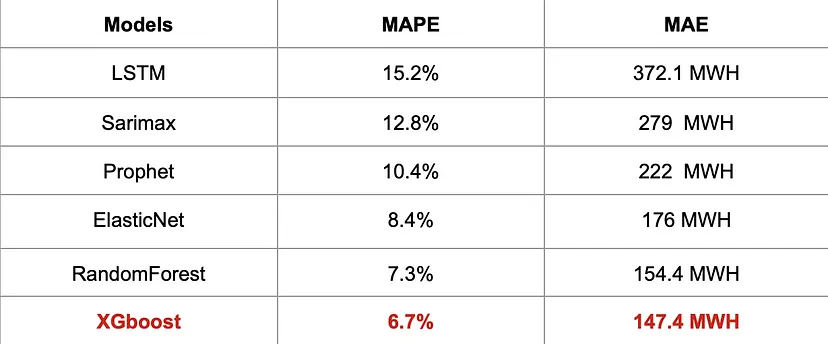

In [ ]:
df2.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2003-01-31,Espoo,Finland,Medium,0.844828,0.538462,0.308708,0.039735,Planes,1,2003,1
2003-01-31,Salzburg,Austria,Large,0.534483,0.503722,0.296373,0.512990,Planes,1,2003,1
2003-01-31,Lille,France,Large,0.600000,0.873418,0.313895,0.321839,Vintage Cars,1,2003,1
2003-01-31,Bergen,Norway,Large,0.354839,0.420398,0.274066,0.268293,Motorcycles,1,2003,1
2003-01-31,Helsinki,Finland,Small,0.648148,0.647500,0.664652,0.691037,Trains,1,2003,1


In [ ]:
df2['PRODUCTLINE'].unique()

array(['Planes', 'Vintage Cars', 'Motorcycles', 'Trains', 'Classic Cars',
       'Ships', 'Trucks and Buses'], dtype=object)

In [ ]:
dfp=df2[df2['PRODUCTLINE']=='Classic Cars']

In [ ]:
dfp.to_csv('filtered_classic_cars.csv', index=False)

In [ ]:
dfp.head()

,CITY,COUNTRY,DEALSIZE,QUANTITYORDERED,PRICEEACH,SALES,MSRP,PRODUCTLINE,MONTH_ID,YEAR_ID,QTR_ID
ORDERDATE,,,,,,,,,,,
2003-01-31,Liverpool,UK,Medium,0.482143,0.697270,0.665670,0.676604,Classic Cars,1,2003,1
2003-01-31,Makati City,Philippines,Medium,0.285714,0.481390,0.272394,0.358767,Classic Cars,1,2003,1
2003-01-31,Newark,USA,Medium,0.339286,0.506203,0.504856,0.100051,Classic Cars,1,2003,1
2003-02-28,San Francisco,USA,Large,0.446429,0.481390,0.291025,0.388075,Classic Cars,2,2003,1
2003-02-28,Nantes,France,Medium,0.571429,0.558313,0.588969,0.465892,Classic Cars,2,2003,1


In [ ]:
dfp.describe()

,QUANTITYORDERED,PRICEEACH,SALES,MSRP,MONTH_ID,YEAR_ID,QTR_ID
count,860.000000,860.000000,860.000000,860.000000,860.000000,860.000000,860.000000
mean,0.498194,0.512318,0.346164,0.366765,6.498837,2008.944186,2.500000
std,0.173155,0.164830,0.198359,0.201652,3.467628,3.668975,1.123876
min,0.000000,0.000000,0.000000,0.000000,1.000000,2003.000000,1.000000
25%,0.375000,0.429280,0.188243,0.209576,3.000000,2006.000000,1.000000
50%,0.500000,0.502481,0.316607,0.343103,7.000000,2009.000000,3.000000
75%,0.607143,0.595533,0.469121,0.486357,9.250000,2012.000000,3.250000
max,1.000000,1.000000,1.000000,1.000000,12.000000,2015.000000,4.000000


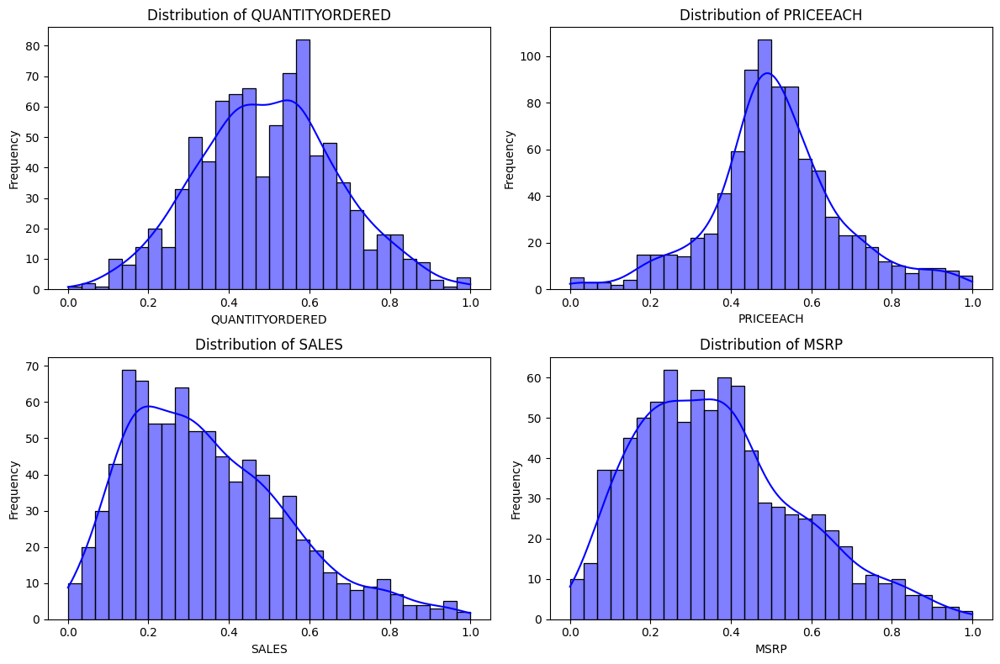

In [ ]:
# List of columns to check distribution
columns_to_check = ['QUANTITYORDERED', 'PRICEEACH', 'SALES', 'MSRP']

# Set up the figure size
plt.figure(figsize=(12, 8))

# Plot distributions
for i, column in enumerate(columns_to_check, 1):
    plt.subplot(2, 2, i)  # Create a 2x2 grid for subplots
    sns.histplot(dfp[column], kde=True, bins=30, color='blue')
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()
